In [1]:
import xarray as xr
#import rioxarray as rxr
import xesmf as xe
import pandas as pd
import numpy as np
import calendar as cld
import matplotlib.pyplot as plt
import matplotlib.colors
colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))
import proplot as pplt # New plot library (https://proplot.readthedocs.io/en/latest/)
pplt.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures
from scipy.stats import chi2
from numba import njit,prange
import matplotlib as mpl
mpl.rcParams['hatch.linewidth'] = 0.05  # previous pdf hatch linewidth
from matplotlib.dates import DateFormatter

from pyproj import CRS,Transformer,Proj

import sys
sys.path.insert(1, '/home/castelli/Notebooks/PhD/utils') # to include my util file in previous directory
import utils as u
u.check_python_version()

3.10.13 | packaged by conda-forge | (main, Oct 26 2023, 18:07:37) [GCC 12.3.0]


In [2]:
def daily_to_monthly(var_array,leap_year): # var_array must be 365 or 366 days, in shape [time,x,y]
    list_monthly_var = []
    day = 0
    
    if leap_year:
        month_days = [31,29,31,30,31,30,31,31,30,31,30,31]
    else:
        month_days = [31,28,31,30,31,30,31,31,30,31,30,31]
    
    for i in range(12):
        eom = day + month_days[i] #eom : end of month
        result = var_array[day:eom].mean(axis=0)
        list_monthly_var.append(result)
        day = eom

    monthly_var = np.stack(list_monthly_var)
    return monthly_var

In [3]:
ds = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')

imin = 32 ; imax = -30
jmin = 20 ; jmax = -15
lon = np.array(ds.LON[jmin:jmax,imin:imax])
lat = np.array(ds.LAT[jmin:jmax,imin:imax])
H = np.array(ds.SH[jmin:jmax,imin:imax])
nlat,nlon = 91, 139

normal_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':True,
                 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}
big_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':True,
              'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[42.,50],'lonlim':[3.,18.]}
multiplot_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2,
                    'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

In [4]:
ds

<xarray.Dataset>
Dimensions:  (sector: 3, y: 126, x: 201)
Coordinates:
  * sector   (sector) float32 1.0 2.0 3.0
  * x        (x) float32 -483.0 -476.0 -469.0 -462.0 ... 896.0 903.0 910.0 917.0
  * y        (y) float32 -308.0 -301.0 -294.0 -287.0 ... 546.0 553.0 560.0 567.0
Data variables:
    FRV      (sector, y, x) float32 ...
    LAT      (y, x) float32 ...
    LON      (y, x) float32 ...
    MSK      (y, x) float32 ...
    SH       (y, x) float32 ...
    SOL      (y, x) float32 ...
    SRF      (y, x) float32 ...
    VEG      (sector, y, x) float32 ...
Attributes:
    title:        ICE - Exp: y50 - 19811201
    institution:  ULg (Xavier Fettweis)
    history:      Fri Dec 17 11:42:05 2021: ncks -v LAT,LON,MSK,SH,SOL,SRF,VE...
    netcdf:       4.1.1 of Feb 12 2011 08:44:29 $
    NCO:          netCDF Operators version 4.9.1 (Homepage = http://nco.sf.ne...

In [5]:
# function for seasonal mean (from Ian)
def season_mean(ds, calendar="standard"):
    #make a DataArray with the season of each day
    seas_array = ds.time.dt.season
    
    # count days in winter season (varies with leap years)
    nb_DJF = seas_array.str.count('DJF').sum()
    
    wgt_DJF = 1/nb_DJF.values.item()
    wgt_MAM = 1/(31+30+31)
    wgt_JJA = 1/(30+31+31)
    wgt_SON = 1/(30+31+30)

    weight = seas_array.str.replace('DJF',str(wgt_DJF)).str.replace('MAM',str(wgt_MAM)).str.replace('JJA',str(wgt_JJA)).str.replace('SON',str(wgt_SON))
    weight = weight.astype('float')
    
    # Test that the sum of the weights for each season is 1.0
    np.testing.assert_allclose(weight.groupby("time.season").sum().values, np.ones(4))

    # Calculate the weighted average
    return (ds * weight).groupby("time.season").sum(dim="time")

In [6]:
def detect_alps(H):
    nlat,nlon = np.shape(H)
    mask = np.bool_(np.zeros((nlat,nlon)))
    r = 4
    for j in range(r,nlat-r):
        for i in range(r,nlon-r):
            mask[j,i] = np.logical_and(H[j,i]>360 ,np.any(H[j-r:j+r,i-r:i+r]>1300))
            # mask[j,i] = np.std(H[j-r:j+r,i-r:i+r])>200
    return mask
alps = detect_alps(H)
alps[lon<4.8] = False
alps[np.logical_and(lon>10,lat<45.2)] = False

In [7]:
path_ju = '/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.'
path_ian = '/bettik/castelli/data/MAR3.14/MAR-ERA5/EUb/ICE.ERA5.EUb.'
#path_ian = '/bettik/castelli/data/MAR3.14/MAR-ERA5/EUc/ICE.ERA5.EUc.'

In [8]:
ds_T_normal = xr.open_dataset(path_ju+'TTz.2014.nc')
ds_T_normal

<xarray.Dataset>
Dimensions:  (time: 365, ztqlev: 4, y: 126, x: 201)
Coordinates:
  * time     (time) datetime64[ns] 2014-01-01T12:00:00 ... 2014-12-31T12:00:00
  * x        (x) float32 -483.0 -476.0 -469.0 -462.0 ... 896.0 903.0 910.0 917.0
  * y        (y) float32 -308.0 -301.0 -294.0 -287.0 ... 546.0 553.0 560.0 567.0
  * ztqlev   (ztqlev) float32 2.0 10.0 50.0 100.0
Data variables:
    TTz      (time, ztqlev, y, x) float32 ...
Attributes:
    title:        ICE - Exp: l12 - 20140101
    institution:  ULg (Xavier Fettweis)
    history:      Thu May 14 23:59:20 2020: ncks -v TTz ICE.l12.2014.01.01-31...
    netcdf:       4.1.1 of Feb 12 2011 08:44:29 $
    NCO:          4.0.9

### EUb 2014-2016

In [45]:
# Don't take 2014 as it is spin-up year

ds_T_v314_2015 = xr.open_dataset(path_ian+'TTz.2015.nc').TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_T_v314_2016 = xr.open_dataset(path_ian+'TTz.2016.nc').TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_T_old_2015 = xr.open_dataset(path_ju+'TTz.2015.nc').TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_T_old_2016 = xr.open_dataset(path_ju+'TTz.2016.nc').TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]

Tdiff = list()
Tdiff.append(np.array(ds_T_v314_2015) - np.array(ds_T_old_2015))
Tdiff.append(np.array(ds_T_v314_2016) - np.array(ds_T_old_2016))


ds_QQz_v314_2015 = xr.open_dataset(path_ian+'QQz.2015.nc').QQz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_QQz_v314_2016 = xr.open_dataset(path_ian+'QQz.2016.nc').QQz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_QQz_old_2015 = xr.open_dataset(path_ju+'QQz.2015.nc').QQz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_QQz_old_2016 = xr.open_dataset(path_ju+'QQz.2016.nc').QQz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]

QQzdiff = list()
QQzdiff.append(np.array(ds_QQz_v314_2015) - np.array(ds_QQz_old_2015))
QQzdiff.append(np.array(ds_QQz_v314_2016) - np.array(ds_QQz_old_2016))


ds_RR_v314_2015 = xr.open_dataset(path_ian+'MBrr.2015.nc').MBrr[:,jmin:jmax,imin:imax]
ds_RR_v314_2016 = xr.open_dataset(path_ian+'MBrr.2016.nc').MBrr[:,jmin:jmax,imin:imax]
ds_RR_old_2015 = xr.open_dataset(path_ju+'MBrr.2015.nc').MBrr[:,jmin:jmax,imin:imax]
ds_RR_old_2016 = xr.open_dataset(path_ju+'MBrr.2016.nc').MBrr[:,jmin:jmax,imin:imax]

ds_SF_v314_2015 = xr.open_dataset(path_ian+'MBsf.2015.nc').MBsf[:,jmin:jmax,imin:imax]
ds_SF_v314_2016 = xr.open_dataset(path_ian+'MBsf.2016.nc').MBsf[:,jmin:jmax,imin:imax]
ds_SF_old_2015 = xr.open_dataset(path_ju+'MBsf.2015.nc').MBsf[:,jmin:jmax,imin:imax]
ds_SF_old_2016 = xr.open_dataset(path_ju+'MBsf.2016.nc').MBsf[:,jmin:jmax,imin:imax]

# TP : Total Precip

ds_TP_v314_2015 = ds_RR_v314_2015 + ds_SF_v314_2015
ds_TP_v314_2016 = ds_RR_v314_2016 + ds_SF_v314_2016
ds_TP_old_2015 = ds_RR_old_2015 + ds_SF_old_2015
ds_TP_old_2016 = ds_RR_old_2016 + ds_SF_old_2016

TPdiff = list()
TPdiff.append(np.array(ds_TP_v314_2015) - np.array(ds_TP_old_2015))
TPdiff.append(np.array(ds_TP_v314_2016) - np.array(ds_TP_old_2016))

In [47]:
# Monthly

monthlyT_diff_2015 = np.array(ds_T_v314_2015.groupby("time.month").mean("time")) - np.array(ds_T_old_2015.groupby("time.month").mean("time"))
monthlyT_diff_2016 = np.array(ds_T_v314_2016.groupby("time.month").mean("time")) - np.array(ds_T_old_2016.groupby("time.month").mean("time"))

print(monthlyT_diff_2015.max(),monthlyT_diff_2015.min())
print(monthlyT_diff_2016.max(),monthlyT_diff_2016.min())

4.0083065 -4.2015285
5.0356603 -5.2236395


In [48]:
monthlyQQz_diff_2015 = np.array(ds_QQz_v314_2015.groupby("time.month").mean("time")) - np.array(ds_QQz_old_2015.groupby("time.month").mean("time"))
monthlyQQz_diff_2016 = np.array(ds_QQz_v314_2016.groupby("time.month").mean("time")) - np.array(ds_QQz_old_2016.groupby("time.month").mean("time"))

print(monthlyQQz_diff_2015.max(),monthlyQQz_diff_2015.min())
print(monthlyQQz_diff_2016.max(),monthlyQQz_diff_2016.min())

1.8019605 -2.694234
2.164487 -2.7226686


In [49]:
monthlyTP_diff_2015 = np.array(ds_TP_v314_2015.groupby("time.month").mean("time")) - np.array(ds_TP_old_2015.groupby("time.month").mean("time"))
monthlyTP_diff_2016 = np.array(ds_TP_v314_2016.groupby("time.month").mean("time")) - np.array(ds_TP_old_2016.groupby("time.month").mean("time"))

print(monthlyTP_diff_2015.max(),monthlyTP_diff_2015.min())
print(monthlyTP_diff_2016.max(),monthlyTP_diff_2016.min())

3.324004 -11.40173
4.472009 -11.185493


In [50]:
monthlyT_diff_2015.shape

(12, 91, 139)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

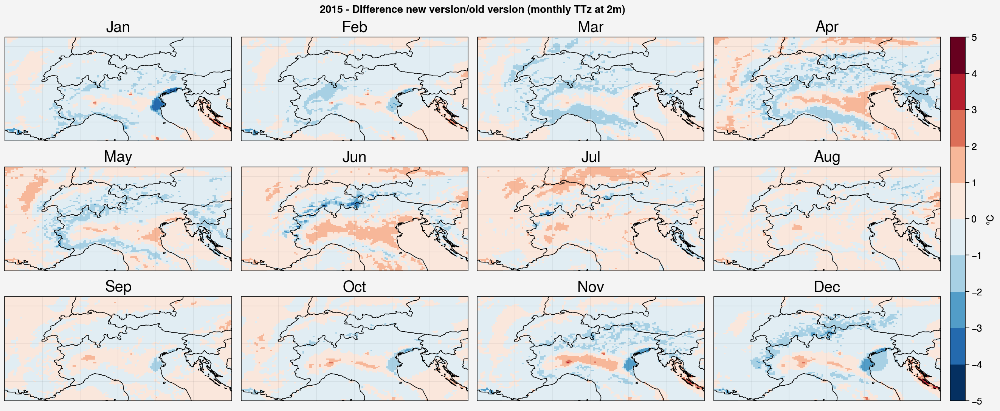

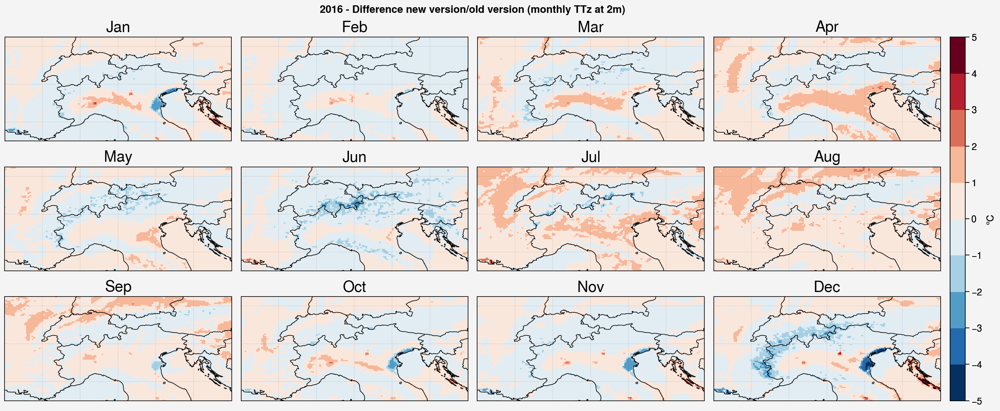

In [51]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diff_2015[mon],levels=np.linspace(-5,5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly TTz at 2m)")


f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diff_2016[mon],levels=np.linspace(-5,5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2016 - Difference new version/old version (monthly TTz at 2m)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

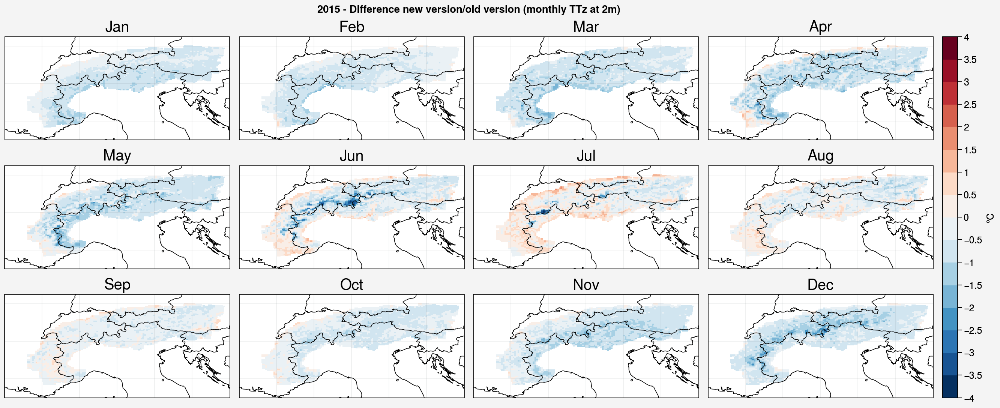

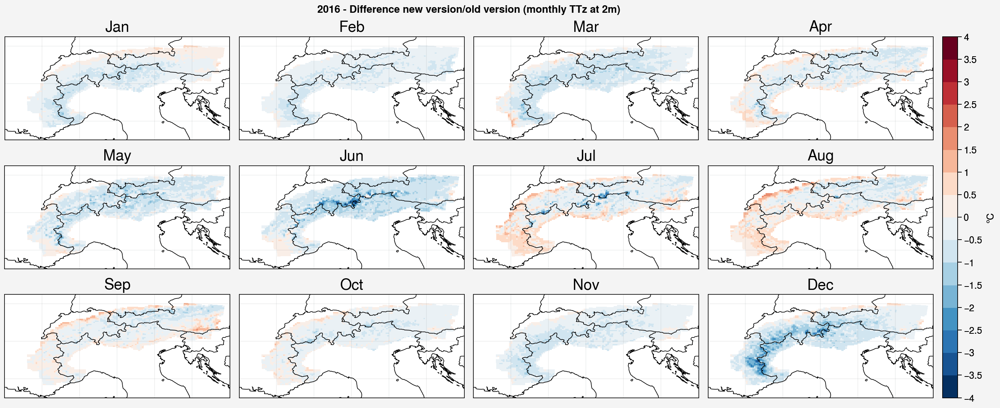

In [66]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    monthlyT_diff_2015_alps = np.ma.masked_array(monthlyT_diff_2015[mon],mask=np.invert(alps))
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diff_2015_alps,levels=np.linspace(-4,4,17),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly TTz at 2m)")


f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    monthlyT_diff_2016_alps = np.ma.masked_array(monthlyT_diff_2016[mon],mask=np.invert(alps))
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diff_2016_alps,levels=np.linspace(-4,4,17),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2016 - Difference new version/old version (monthly TTz at 2m)")



/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

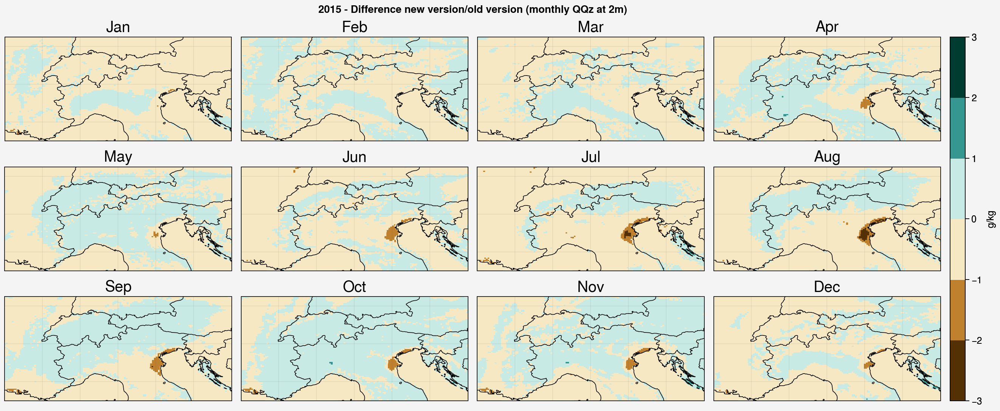

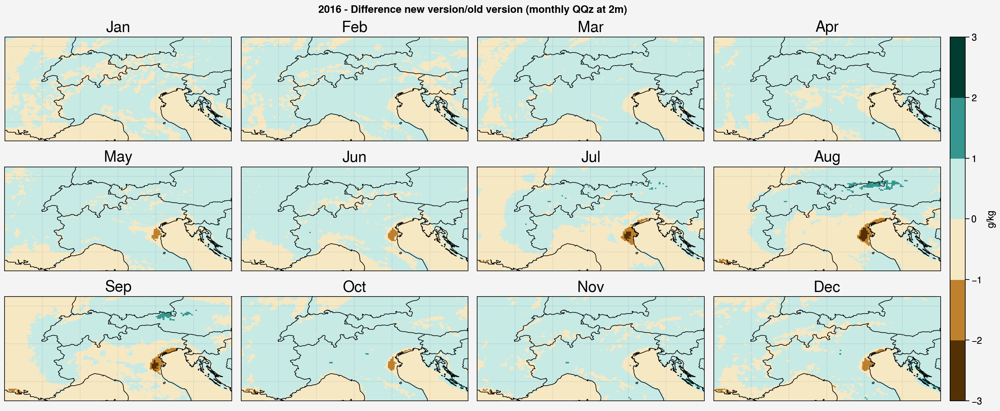

In [67]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyQQz_diff_2015[mon],levels=np.linspace(-3,3,7),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly QQz at 2m)")


f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyQQz_diff_2016[mon],levels=np.linspace(-3,3,7),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2016 - Difference new version/old version (monthly QQz at 2m)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

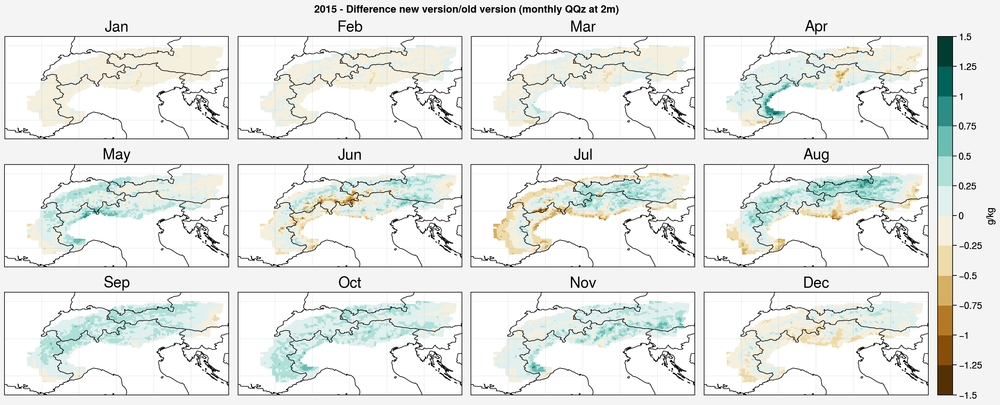

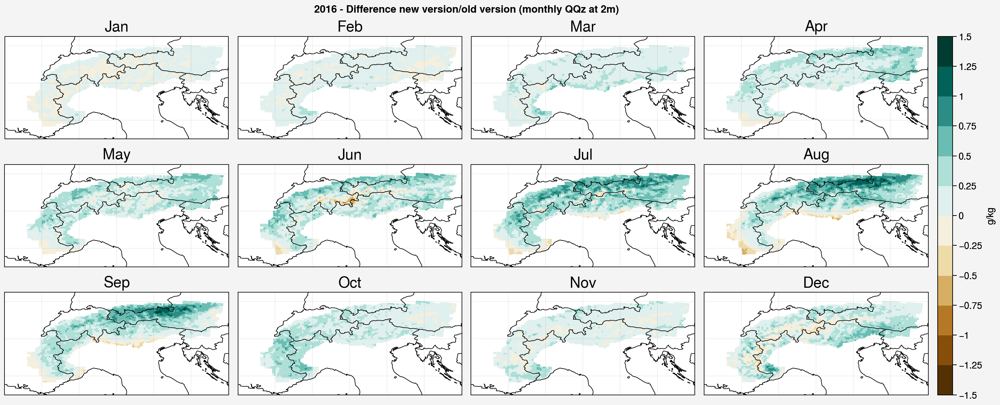

In [68]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    monthlyQQz_diff_2015_alps = np.ma.masked_array(monthlyQQz_diff_2015[mon],mask=np.invert(alps))
    m = axs[mon].pcolormesh(lon,lat,monthlyQQz_diff_2015_alps,levels=np.linspace(-1.5,1.5,13),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly QQz at 2m)")


f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    monthlyQQz_diff_2016_alps = np.ma.masked_array(monthlyQQz_diff_2016[mon],mask=np.invert(alps))
    m = axs[mon].pcolormesh(lon,lat,monthlyQQz_diff_2016_alps,levels=np.linspace(-1.5,1.5,13),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2016 - Difference new version/old version (monthly QQz at 2m)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

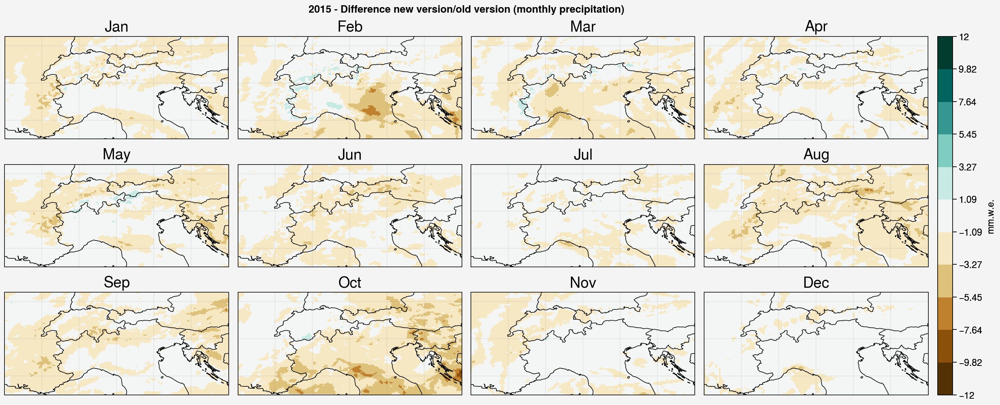

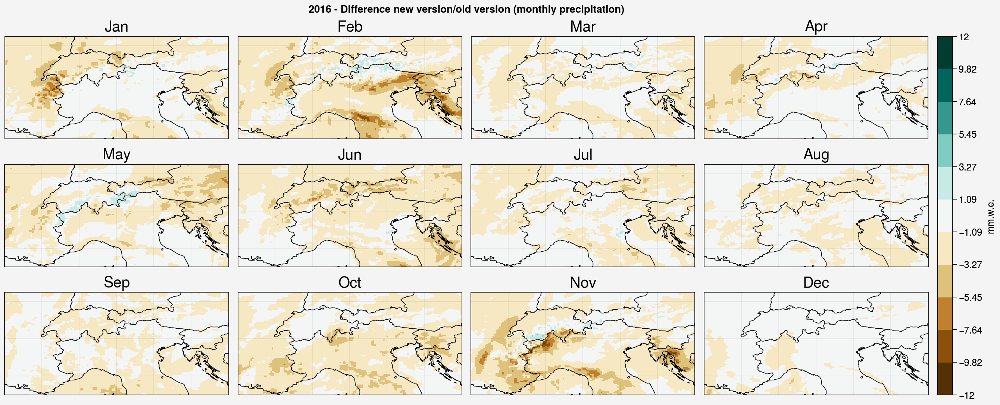

In [69]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyTP_diff_2015[mon],levels=np.linspace(-12,12,12),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm.w.e.')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly precipitation)")


f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyTP_diff_2016[mon],levels=np.linspace(-12,12,12),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm.w.e.')

axs.format(**multiplot_format,suptitle="2016 - Difference new version/old version (monthly precipitation)")

#### Humidity QQz

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

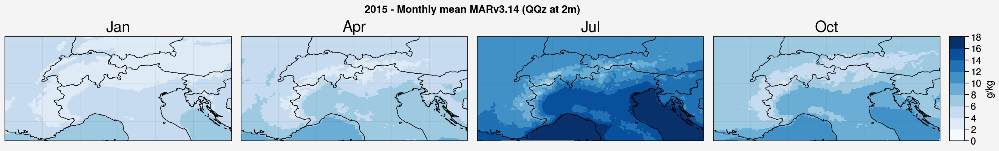

In [52]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4)

m = axs[0].pcolormesh(lon,lat,ds_QQz_v314_2015.groupby("time.month").mean("time")[0],levels=np.linspace(0,18,10),cmap='Blues')
axs[0].format(title='Jan',titlesize='20px')

m = axs[1].pcolormesh(lon,lat,ds_QQz_v314_2015.groupby("time.month").mean("time")[3],levels=np.linspace(0,18,10),cmap='Blues')
axs[1].format(title='Apr',titlesize='20px')

m = axs[2].pcolormesh(lon,lat,ds_QQz_v314_2015.groupby("time.month").mean("time")[6],levels=np.linspace(0,18,10),cmap='Blues')
axs[2].format(title='Jul',titlesize='20px')

m = axs[3].pcolormesh(lon,lat,ds_QQz_v314_2015.groupby("time.month").mean("time")[9],levels=np.linspace(0,18,10),cmap='Blues')
axs[3].format(title='Oct',titlesize='20px')
f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2015 - Monthly mean MARv3.14 (QQz at 2m)")

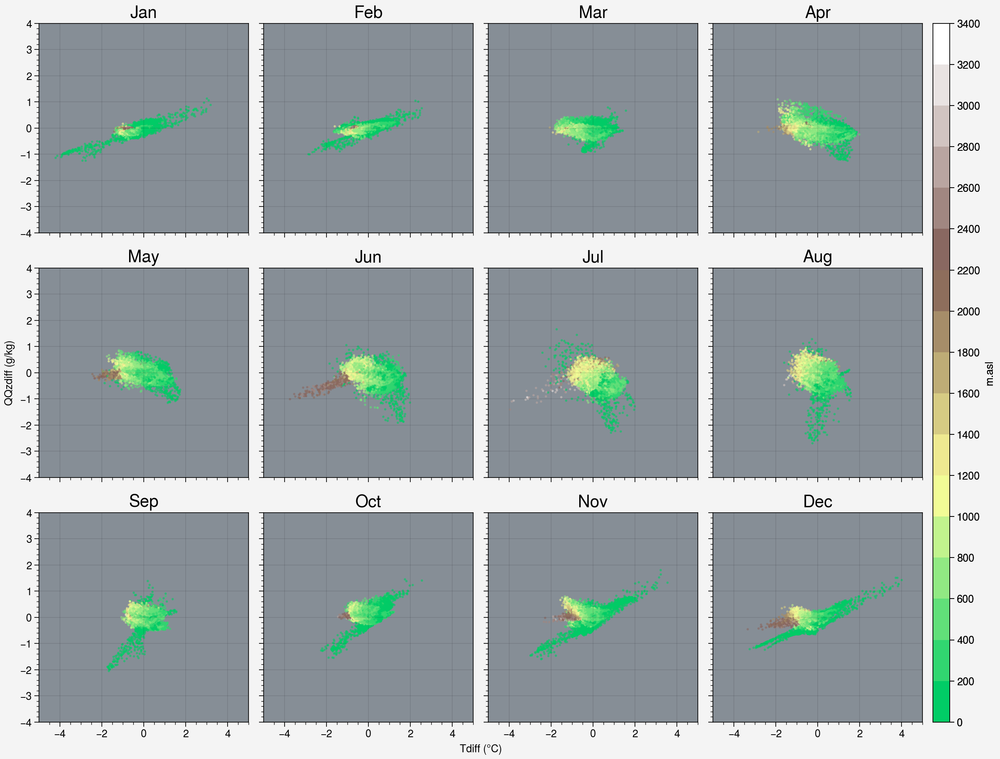

In [71]:
with pplt.rc.context({'axesfacecolor': 'gray6'}):
    f, axs = pplt.subplots(ncols=4,nrows=3)



for mon in range(12):
    ax = axs[mon]
    m = ax.scatter(monthlyT_diff_2015[mon].flatten(),monthlyQQz_diff_2015[mon].flatten(),s=2,alpha=0.5,c=H.flatten(),cmap=colors_land,levels=17) # *100 to put in percent
    ax.set_xlim((-5.,5))
    ax.set_ylim((-4.,4))
    ax.format(title=months[mon],titlesize='20px')

cbar = f.colorbar(m,label= 'm.asl')
cbar.solids.set(alpha=1)

axs.format(xlabel='Tdiff (°C)',ylabel='QQzdiff (g/kg)')

### Cartes de biais

In [72]:
# Monthly

monthlyT_diff = (monthlyT_diff_2015 + monthlyT_diff_2016)/2

print(monthlyT_diff_2015.max(),monthlyT_diff_2015.min())
print(monthlyT_diff_2016.max(),monthlyT_diff_2016.min())
print(monthlyT_diff.max(),monthlyT_diff.min())

4.0083065 -4.2015285
5.0356603 -5.2236395
4.511651 -4.217897


/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

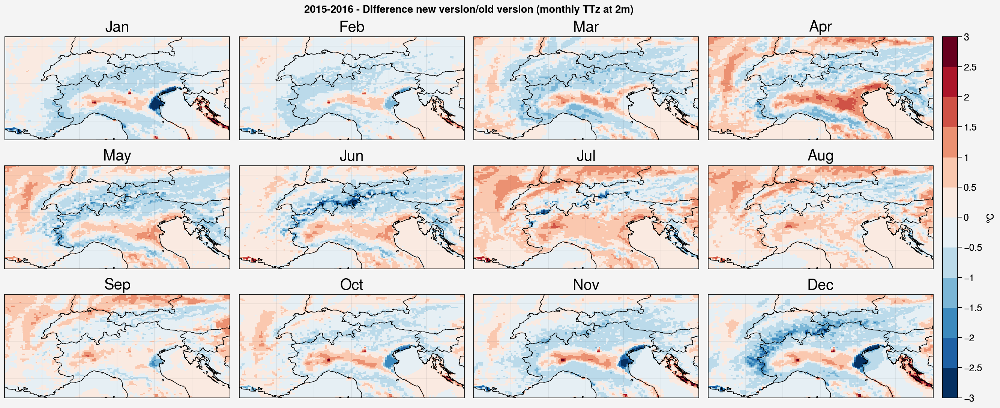

In [73]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diff[mon],levels=np.linspace(-3,3,13),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015-2016 - Difference new version/old version (monthly TTz at 2m)")

In [74]:
monthlyTP_diff = (monthlyTP_diff_2015 + monthlyTP_diff_2016)/2

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

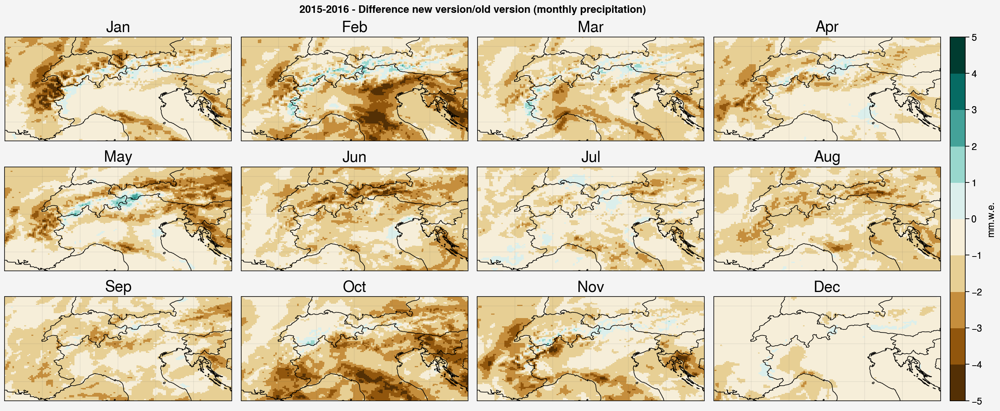

In [75]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyTP_diff[mon],levels=np.linspace(-5,5,11),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm.w.e.')

axs.format(**multiplot_format,suptitle="2015-2016 - Difference new version/old version (monthly precipitation)")

In [76]:
monthlyQQz_diff = (monthlyQQz_diff_2015 + monthlyQQz_diff_2016)/2

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

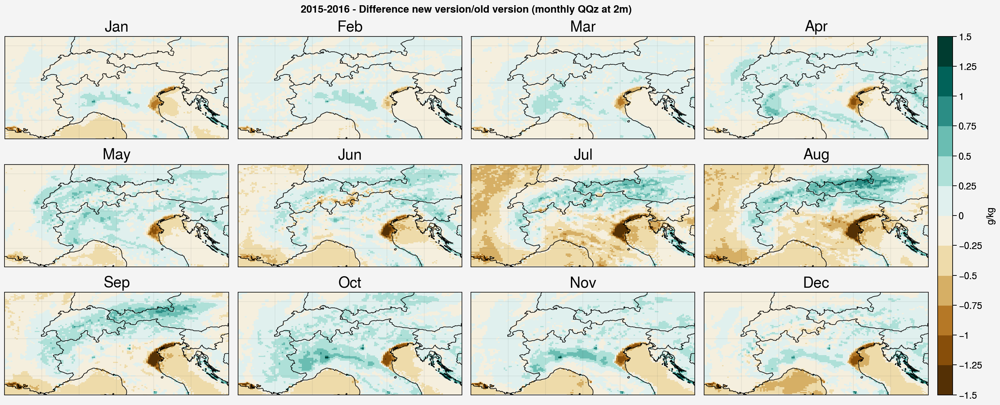

In [77]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyQQz_diff[mon],levels=np.linspace(-1.5,1.5,13),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2015-2016 - Difference new version/old version (monthly QQz at 2m)")

#### Nebulosity/Clouds

In [53]:
ds_CU_v314_2015 = xr.open_dataset(path_ian+'CU.2015.nc').CU[:,jmin:jmax,imin:imax]
ds_CU_v314_2016 = xr.open_dataset(path_ian+'CU.2016.nc').CU[:,jmin:jmax,imin:imax]
ds_CU_old_2015 = xr.open_dataset(path_ju+'CU.2015.nc').CU[:,jmin:jmax,imin:imax]
ds_CU_old_2016 = xr.open_dataset(path_ju+'CU.2016.nc').CU[:,jmin:jmax,imin:imax]

ds_CM_v314_2015 = xr.open_dataset(path_ian+'CM.2015.nc').CM[:,jmin:jmax,imin:imax]
ds_CM_v314_2016 = xr.open_dataset(path_ian+'CM.2016.nc').CM[:,jmin:jmax,imin:imax]
ds_CM_old_2015 = xr.open_dataset(path_ju+'CM.2015.nc').CM[:,jmin:jmax,imin:imax]
ds_CM_old_2016 = xr.open_dataset(path_ju+'CM.2016.nc').CM[:,jmin:jmax,imin:imax]

ds_CD_v314_2015 = xr.open_dataset(path_ian+'CD.2015.nc').CD[:,jmin:jmax,imin:imax]
ds_CD_v314_2016 = xr.open_dataset(path_ian+'CD.2016.nc').CD[:,jmin:jmax,imin:imax]
ds_CD_old_2015 = xr.open_dataset(path_ju+'CD.2015.nc').CD[:,jmin:jmax,imin:imax]
ds_CD_old_2016 = xr.open_dataset(path_ju+'CD.2016.nc').CD[:,jmin:jmax,imin:imax]

In [54]:
monthlyCU_diff_2015 = np.array(ds_CU_v314_2015.groupby("time.month").mean("time"))-np.array(ds_CU_old_2015.groupby("time.month").mean("time"))
monthlyCU_diff_2016 = np.array(ds_CU_v314_2016.groupby("time.month").mean("time")) - np.array(ds_CU_old_2016.groupby("time.month").mean("time"))
monthlyCU_diff = (monthlyCU_diff_2015 + monthlyCU_diff_2016)/2

monthlyCM_diff_2015 = np.array(ds_CM_v314_2015.groupby("time.month").mean("time"))-np.array(ds_CM_old_2015.groupby("time.month").mean("time"))
monthlyCM_diff_2016 = np.array(ds_CM_v314_2016.groupby("time.month").mean("time")) - np.array(ds_CM_old_2016.groupby("time.month").mean("time"))
monthlyCM_diff = (monthlyCM_diff_2015 + monthlyCM_diff_2016)/2

monthlyCD_diff_2015 = np.array(ds_CD_v314_2015.groupby("time.month").mean("time"))-np.array(ds_CD_old_2015.groupby("time.month").mean("time"))
monthlyCD_diff_2016 = np.array(ds_CD_v314_2016.groupby("time.month").mean("time")) - np.array(ds_CD_old_2016.groupby("time.month").mean("time"))
monthlyCD_diff = (monthlyCD_diff_2015 + monthlyCD_diff_2016)/2

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

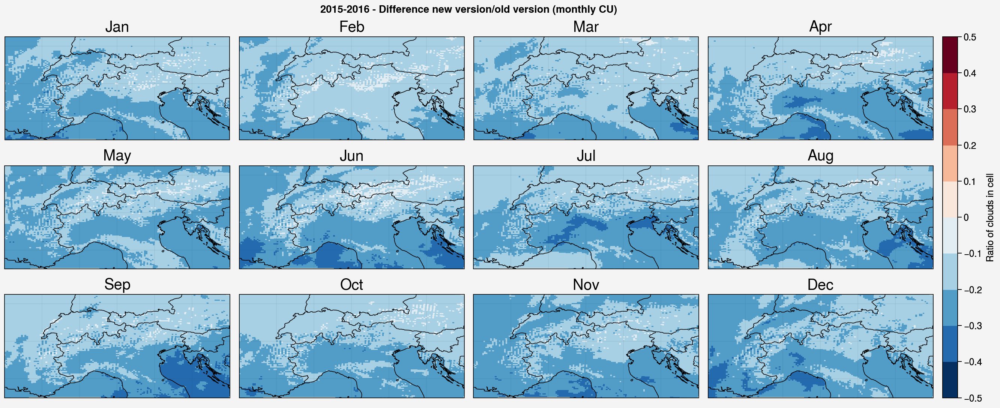

In [80]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyCU_diff[mon],levels=np.linspace(-0.5,0.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'Ratio of clouds in cell')

axs.format(**multiplot_format,suptitle="2015-2016 - Difference new version/old version (monthly CU)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

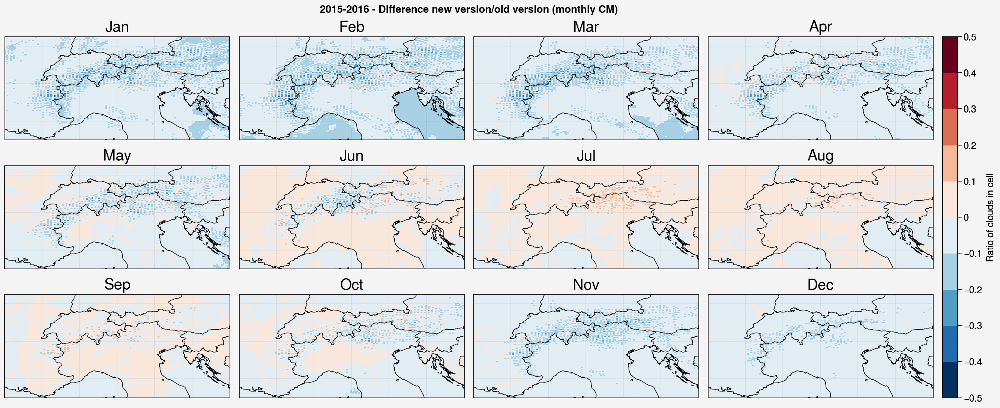

In [81]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyCM_diff[mon],levels=np.linspace(-0.5,0.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'Ratio of clouds in cell')

axs.format(**multiplot_format,suptitle="2015-2016 - Difference new version/old version (monthly CM)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

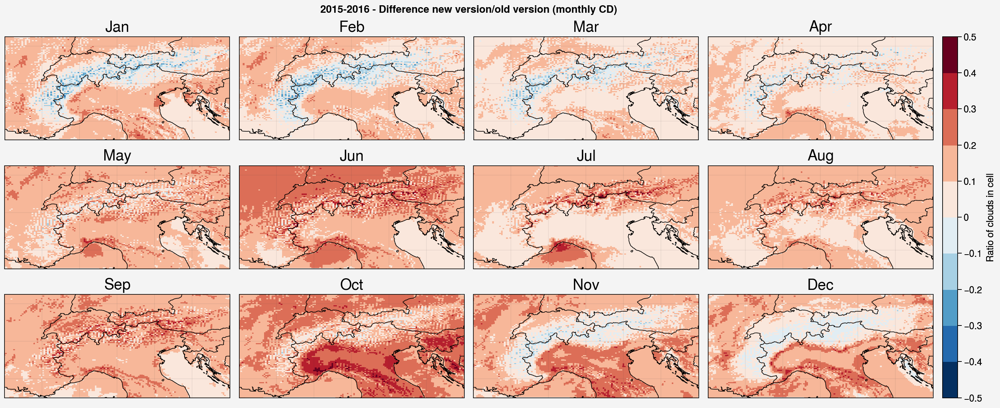

In [82]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyCD_diff[mon],levels=np.linspace(-0.5,0.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'Ratio of clouds in cell')

axs.format(**multiplot_format,suptitle="2015-2016 - Difference new version/old version (monthly CD)")

### EUc 2015

In [9]:
path_ju = '/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.'
#path_ian = '/bettik/castelli/data/MAR3.14/MAR-ERA5/EUb/ICE.ERA5.EUb.'
path_ian = '/bettik/castelli/data/MAR3.14/MAR-ERA5/EUc/ICE.ERA5.EUc.'

In [10]:
# Don't take 2014 as it is spin-up year

ds_T_v314_2015 = xr.open_dataset(path_ian+'TTz.2015.nc').TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_T_old_2015 = xr.open_dataset(path_ju+'TTz.2015.nc').TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]

Tdiff = list()
Tdiff.append(np.array(ds_T_v314_2015) - np.array(ds_T_old_2015))

ds_QQz_v314_2015 = xr.open_dataset(path_ian+'QQz.2015.nc').QQz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_QQz_old_2015 = xr.open_dataset(path_ju+'QQz.2015.nc').QQz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]

QQzdiff = list()
QQzdiff.append(np.array(ds_QQz_v314_2015) - np.array(ds_QQz_old_2015))

ds_RR_v314_2015 = xr.open_dataset(path_ian+'MBrr.2015.nc').MBrr[:,jmin:jmax,imin:imax]
ds_RR_old_2015 = xr.open_dataset(path_ju+'MBrr.2015.nc').MBrr[:,jmin:jmax,imin:imax]

ds_SF_v314_2015 = xr.open_dataset(path_ian+'MBsf.2015.nc').MBsf[:,jmin:jmax,imin:imax]
ds_SF_old_2015 = xr.open_dataset(path_ju+'MBsf.2015.nc').MBsf[:,jmin:jmax,imin:imax]

# TP : Total Precip

ds_TP_v314_2015 = ds_RR_v314_2015 + ds_SF_v314_2015
ds_TP_old_2015 = ds_RR_old_2015 + ds_SF_old_2015

TPdiff = list()
TPdiff.append(np.array(ds_TP_v314_2015) - np.array(ds_TP_old_2015))

In [11]:
# Monthly

monthlyT_diff_2015 = np.array(ds_T_v314_2015.groupby("time.month").mean("time"))-np.array(ds_T_old_2015.groupby("time.month").mean("time"))

print(monthlyT_diff_2015.max(),monthlyT_diff_2015.min())

4.025052 -5.0034084


In [12]:
monthlyQQz_diff_2015 = np.array(ds_QQz_v314_2015.groupby("time.month").mean("time"))-np.array(ds_QQz_old_2015.groupby("time.month").mean("time"))

print(monthlyQQz_diff_2015.max(),monthlyQQz_diff_2015.min())

1.9480424 -1.8962278


In [13]:
monthlyTP_diff_2015 = np.array(ds_TP_v314_2015.groupby("time.month").mean("time")) - np.array(ds_TP_old_2015.groupby("time.month").mean("time"))

print(monthlyTP_diff_2015.max(),monthlyTP_diff_2015.min())

3.7767866 -6.349509


/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

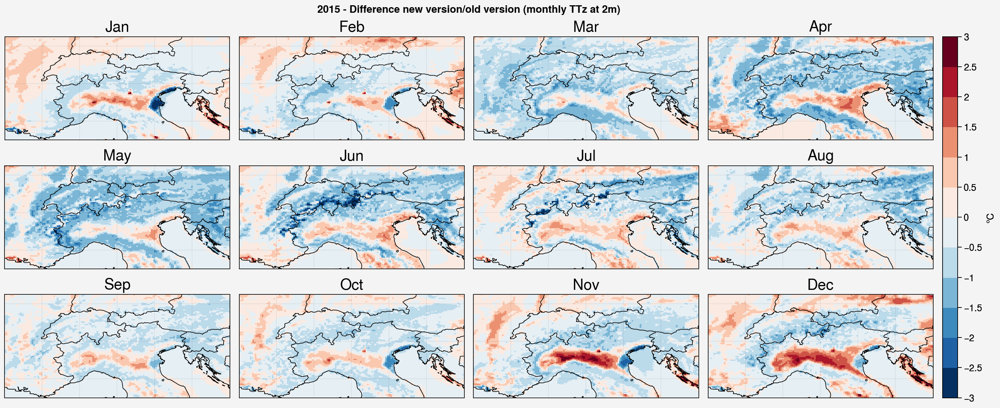

In [13]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diff_2015[mon],levels=np.linspace(-3,3,13),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly TTz at 2m)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

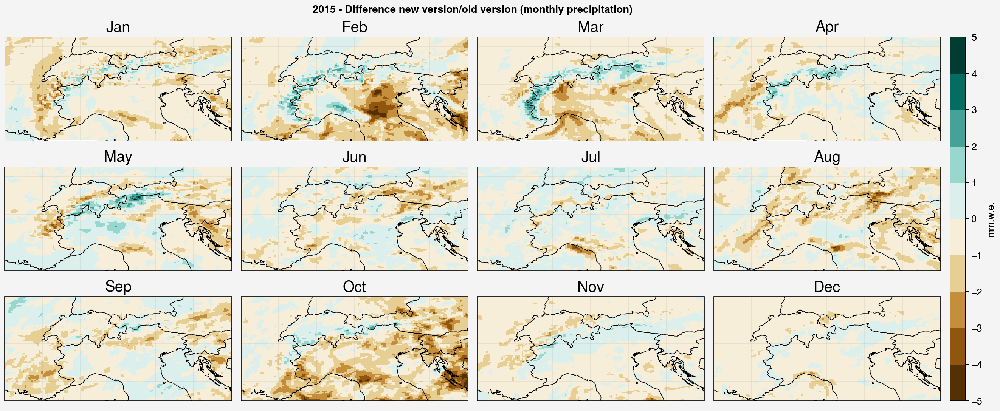

In [28]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyTP_diff_2015[mon],levels=np.linspace(-5,5,11),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm.w.e.')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly precipitation)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

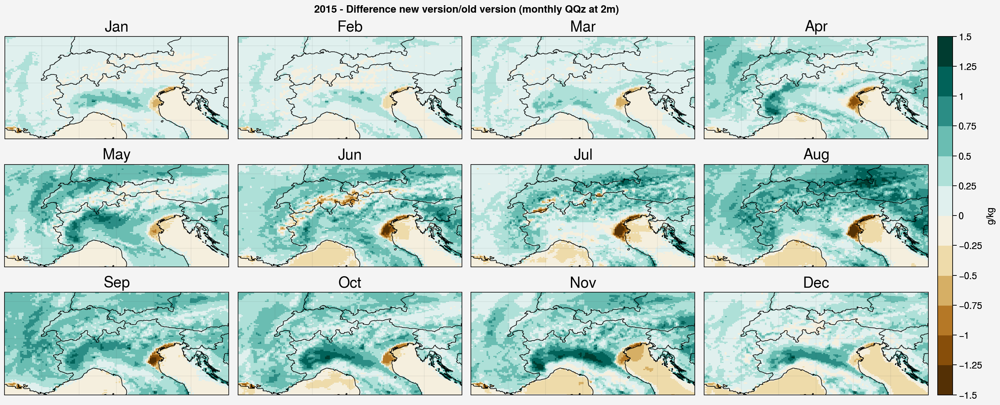

In [29]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyQQz_diff_2015[mon],levels=np.linspace(-1.5,1.5,13),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly QQz at 2m)")

### Obs

In [14]:
ds_TG_EOBS = xr.open_dataset('/bettik/castelli/data/E-OBS/tg_ens_mean_0.1deg_reg_v29.0e.nc').tg.isel(latitude=np.arange(170,250,1),longitude=np.arange(280,430,1))
ds_RR_EOBS = xr.open_dataset('/bettik/castelli/data/E-OBS/rr_ens_mean_0.1deg_reg_v29.0e.nc').rr.isel(latitude=np.arange(170,250,1),longitude=np.arange(280,430,1))
ds_HU_EOBS = xr.open_dataset('/bettik/castelli/data/E-OBS/hu_ens_mean_0.1deg_reg_v29.0e.nc').hu.isel(latitude=np.arange(170,250,1),longitude=np.arange(280,430,1))

ds_TG_EOBS

<xarray.DataArray 'tg' (time: 27028, latitude: 80, longitude: 150)>
[324336000 values with dtype=float32]
Coordinates:
  * latitude   (latitude) float64 42.05 42.15 42.25 42.35 ... 49.75 49.85 49.95
  * longitude  (longitude) float64 3.05 3.15 3.25 3.35 ... 17.75 17.85 17.95
  * time       (time) datetime64[ns] 1950-01-01 1950-01-02 ... 2023-12-31
Attributes:
    units:          Celsius
    long_name:      mean temperature
    standard_name:  air_temperature
    cell_methods:   time: mean

In [15]:
ds_TG_EOBS_2015 = ds_TG_EOBS.sel(time='2015')
ds_TG_EOBS_2016 = ds_TG_EOBS.sel(time='2016')

ds_RR_EOBS_2015 = ds_RR_EOBS.sel(time='2015')
ds_HU_EOBS_2015 = ds_HU_EOBS.sel(time='2015')

ds_TG_EOBS_2015

<xarray.DataArray 'tg' (time: 365, latitude: 80, longitude: 150)>
[4380000 values with dtype=float32]
Coordinates:
  * latitude   (latitude) float64 42.05 42.15 42.25 42.35 ... 49.75 49.85 49.95
  * longitude  (longitude) float64 3.05 3.15 3.25 3.35 ... 17.75 17.85 17.95
  * time       (time) datetime64[ns] 2015-01-01 2015-01-02 ... 2015-12-31
Attributes:
    units:          Celsius
    long_name:      mean temperature
    standard_name:  air_temperature
    cell_methods:   time: mean

In [16]:
ds_TG_EOBS = 0
ds_RR_EOBS = 0
ds_HU_EOBS = 0

In [17]:
lon_EOBS = np.array(ds_TG_EOBS_2015.longitude)
lat_EOBS = np.array(ds_TG_EOBS_2015.latitude)

monthlyTG_EOBS_2015 = np.array(ds_TG_EOBS_2015.groupby("time.month").mean("time"))
monthlyTG_EOBS_2016 = np.array(ds_TG_EOBS_2016.groupby("time.month").mean("time"))
monthlyTG_EOBS = (monthlyTG_EOBS_2015 + monthlyTG_EOBS_2016)/2

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

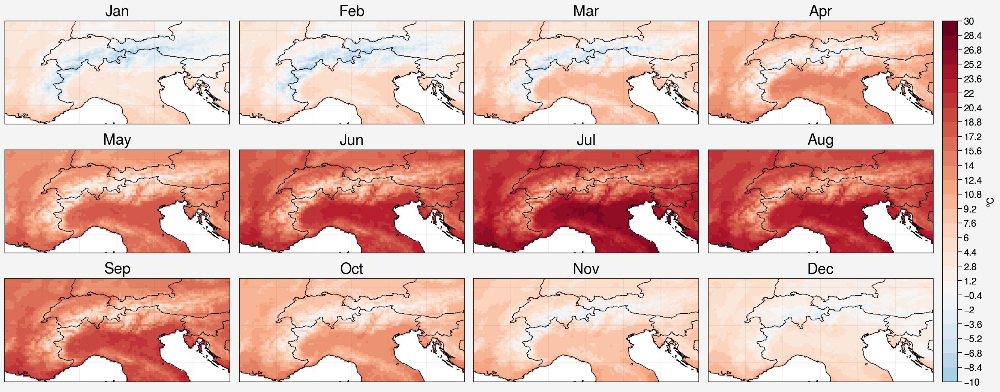

In [21]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,monthlyTG_EOBS[mon],levels=np.linspace(-10,30,26),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="")

#### Comparing to Obs

In [18]:
lon_correct_xy = ds.LON[jmin:jmax,imin:imax] # copy the lon/lat with incorrect x/y (small differences with the x/y of the MAR simulation)
lat_correct_xy = ds.LAT[jmin:jmax,imin:imax]

lon_correct_xy["x"] = ("x", ds_T_v314_2015.x.values) # correct the incorrect x/y
lon_correct_xy["y"] = ("y", ds_T_v314_2015.y.values)

lat_correct_xy["x"] = ("x", ds_T_v314_2015.x.values)
lat_correct_xy["y"] = ("y", ds_T_v314_2015.y.values)


ds_T_v314_2015.coords['lon'] = lon_correct_xy
ds_T_v314_2015.coords['lat'] = lat_correct_xy

ds_T_old_2015.coords['lon'] = ds.LON[jmin:jmax,imin:imax]
ds_T_old_2015.coords['lat'] = ds.LAT[jmin:jmax,imin:imax]

ds_T_v314_2015

<xarray.DataArray 'TTz' (time: 365, y: 91, x: 139)>
array([[[ 9.214099,  9.306477, ...,  8.027635,  7.924051],
        [ 9.037285,  9.118703, ...,  7.991868,  7.832749],
        ...,
        [-0.032535,  0.339872, ..., -2.329796, -2.629418],
        [-0.238095,  0.266634, ..., -2.168661, -2.447447]],

       [[11.961897, 12.11707 , ..., 12.562517, 12.596089],
        [11.863504, 12.069141, ..., 12.577668, 12.601375],
        ...,
        [ 2.23749 ,  2.470863, ...,  3.166391,  2.520758],
        [ 2.303823,  2.548503, ...,  3.327955,  2.823113]],

       ...,

       [[13.655927, 13.676003, ..., 12.068644, 11.933764],
        [13.629679, 13.656385, ..., 11.997559, 11.87512 ],
        ...,
        [ 6.46274 ,  6.623821, ...,  0.514162,  0.542313],
        [ 6.14258 ,  6.303067, ...,  0.448407,  0.484608]],

       [[13.863091, 13.913135, ...,  9.326861,  9.285624],
        [13.884362, 13.934706, ...,  9.291603,  9.253032],
        ...,
        [ 8.326447,  8.285563, ..., -3.827857, -3.787593],
        [ 8.095393,  8.20113 , ..., -3.95102 , -3.839536]]], dtype=float32)
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T12:00:00 ... 2015-12-31T12:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
    ztqlev   float32 2.0
    lon      (y, x) float32 ...
    lat      (y, x) float32 ...
Attributes:
    units:          C
    long_name:      Temperature
    standard_name:  Temperature
    actual_range:   [-20.691431  20.232143]
    cell_methods:   time: mean

In [19]:
ds_T_v314_2015_regrid = u.regrid(ds_T_v314_2015,ds_TG_EOBS_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False) # globe=True gives an error, because of scipy.sparse.csr_matrix(X)
                                                                                    # in add_matrix_NaNs

ds_T_old_2015_regrid = u.regrid(ds_T_old_2015,ds_TG_EOBS_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False) # globe=True gives an error, because of scipy.sparse.csr_matrix(X)
                                                                                    # in add_matrix_NaNs

In [23]:
ds_TG_EOBS_2015_regrid = u.regrid(ds_TG_EOBS_2015,ds_T_v314_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False) # globe=True gives an error, because of scipy.sparse.csr_matrix(X)
                                                                                    # in add_matrix_NaNs

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

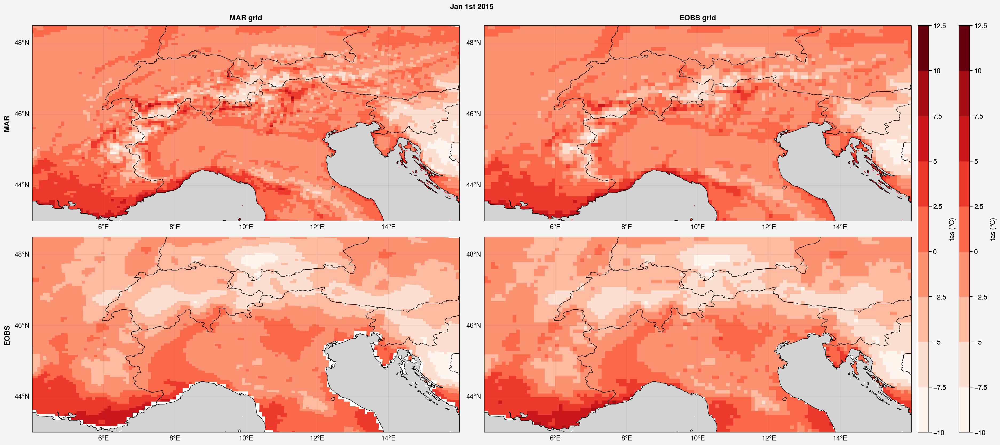

In [67]:
f, axs = pplt.subplots(proj='cyl', axwidth=8,ncols=2,nrows=2)

#MAR
m=axs[0].pcolormesh(lon, lat, ds_T_v314_2015[0], levels=np.linspace(-10,12.5,10),cmap='Reds')

m=axs[1].pcolormesh(lon_EOBS, lat_EOBS, ds_T_v314_2015_regrid[0], levels=np.linspace(-10,12.5,10),cmap='Reds')
f.colorbar(m,label= 'tas (°C)')

#EOBS
m=axs[2].pcolormesh(lon, lat, ds_TG_EOBS_2015_regrid[0], levels=np.linspace(-10,12.5,10),cmap='Reds')

m=axs[3].pcolormesh(lon_EOBS, lat_EOBS, ds_TG_EOBS_2015[0], levels=np.linspace(-10,12.5,10),cmap='Reds')
f.colorbar(m,label= 'tas (°C)')

axs.format(**normal_format)
axs.format(ocean=True,oceancolor='lightgray',reso='hi',suptitle='Jan 1st 2015',collabels=['MAR grid','EOBS grid'],rowlabels=['MAR','EOBS'])

In [24]:
ds_T_v314_2015_monthly = ds_T_v314_2015.groupby("time.month").mean("time")
ds_T_v314_2015_regrid_monthly = ds_T_v314_2015_regrid.groupby("time.month").mean("time")

ds_T_old_2015_monthly = ds_T_old_2015.groupby("time.month").mean("time")
ds_T_old_2015_regrid_monthly = ds_T_old_2015_regrid.groupby("time.month").mean("time")

ds_TG_EOBS_2015_regrid_monthly = ds_TG_EOBS_2015_regrid.groupby("time.month").mean("time")

monthlyT_diffEOBS_2015 = ds_T_v314_2015_monthly.values - ds_TG_EOBS_2015_regrid_monthly
monthlyT_diffEOBS_2015_2 = ds_T_v314_2015_regrid_monthly.values - monthlyTG_EOBS_2015
monthlyT_diff_old_EOBS_2015 = ds_T_old_2015_regrid_monthly.values - monthlyTG_EOBS_2015

In [25]:
monthlyT_diffEOBS_2015.shape

(12, 91, 139)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

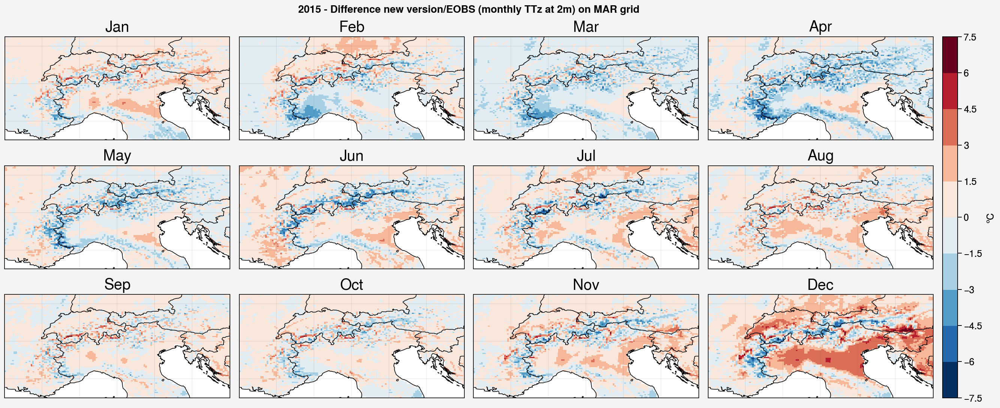

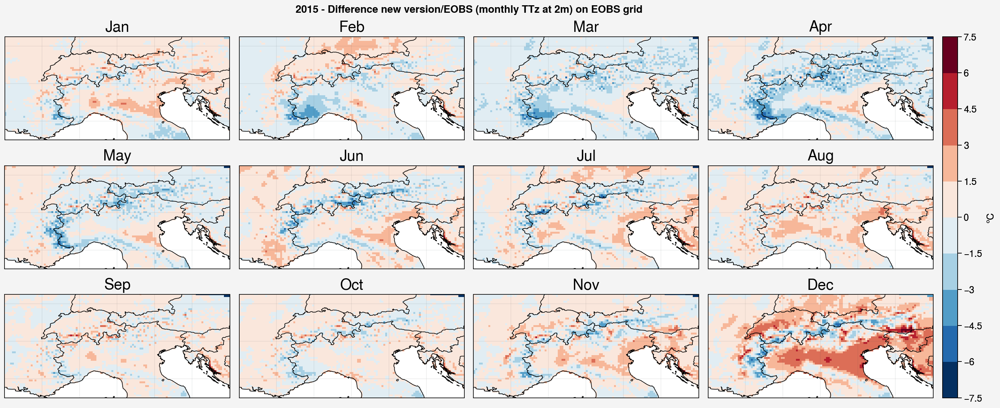

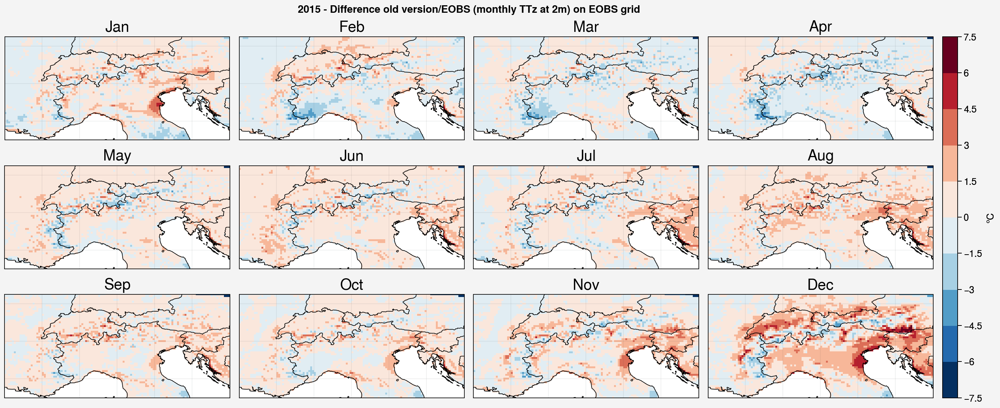

In [75]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diffEOBS_2015[mon],levels=np.linspace(-7.5,7.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/EOBS (monthly TTz at 2m) on MAR grid")

# -------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,monthlyT_diffEOBS_2015_2[mon],levels=np.linspace(-7.5,7.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/EOBS (monthly TTz at 2m) on EOBS grid")

#--------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,monthlyT_diff_old_EOBS_2015[mon],levels=np.linspace(-7.5,7.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference old version/EOBS (monthly TTz at 2m) on EOBS grid")


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


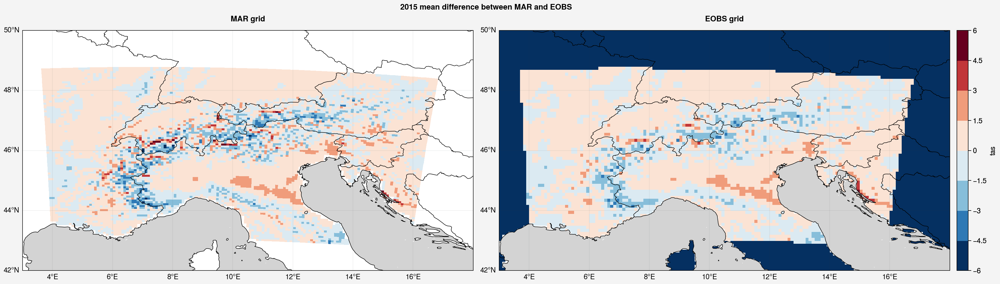

In [76]:
yearlyT_diffEOBS_2015 = ds_T_v314_2015.mean("time").values - ds_TG_EOBS_2015_regrid.mean("time").values

yearlyT_diffEOBS_2015_2 = ds_T_v314_2015_regrid.mean("time").values - ds_TG_EOBS_2015.mean("time").values

f, axs = pplt.subplots(proj='cyl', axwidth=8,ncols=2)

m=axs[0].pcolormesh(lon, lat, yearlyT_diffEOBS_2015, levels=np.linspace(-6,6,9),cmap='RdBu_r')

m=axs[1].pcolormesh(lon_EOBS, lat_EOBS, yearlyT_diffEOBS_2015_2, levels=np.linspace(-6,6,9),cmap='RdBu_r')
f.colorbar(m,label= 'tas')

#axs.format(**normal_format)
axs.format(**big_format)
axs.format(ocean=True,oceancolor='lightgray',reso='hi',suptitle='2015 mean difference between MAR and EOBS',collabels=['MAR grid','EOBS grid'])

In [26]:
ds_TP_v314_2015.coords['lon'] = lon_correct_xy
ds_TP_v314_2015.coords['lat'] = lat_correct_xy

ds_TP_old_2015.coords['lon'] = ds.LON[jmin:jmax,imin:imax]
ds_TP_old_2015.coords['lat'] = ds.LAT[jmin:jmax,imin:imax]

ds_TP_v314_2015_regrid = u.regrid(ds_TP_v314_2015,ds_RR_EOBS_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False) # globe=True gives an error, because of scipy.sparse.csr_matrix(X)
                                                                                    # in add_matrix_NaNs
ds_TP_old_2015_regrid = u.regrid(ds_TP_old_2015,ds_RR_EOBS_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False)

ds_TP_v314_2015_regrid_monthly = ds_TP_v314_2015_regrid.groupby("time.month").mean("time")
ds_TP_old_2015_regrid_monthly = ds_TP_old_2015_regrid.groupby("time.month").mean("time")
ds_RR_EOBS_2015_monthly = ds_RR_EOBS_2015.groupby("time.month").mean("time")

monthlyTP_diffEOBS_2015 = ds_TP_v314_2015_regrid_monthly.values - ds_RR_EOBS_2015_monthly
monthlyTP_diff_old_EOBS_2015 = ds_TP_old_2015_regrid_monthly.values - ds_RR_EOBS_2015_monthly

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

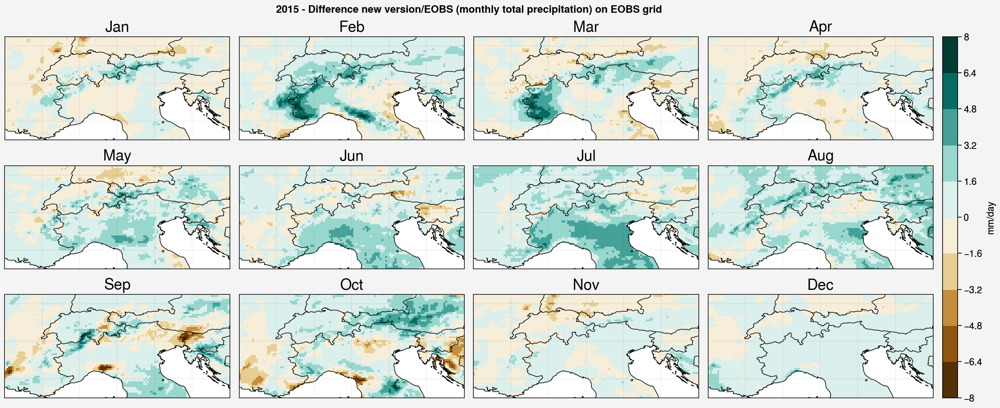

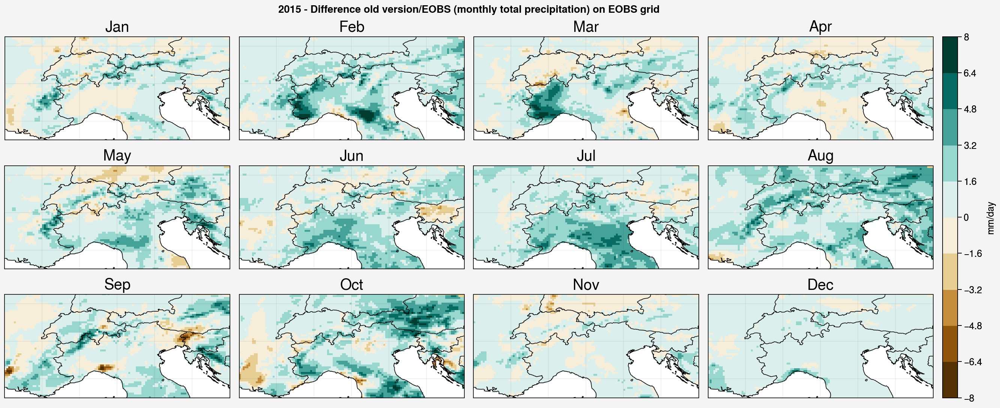

In [78]:
# -------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,monthlyTP_diffEOBS_2015[mon],levels=np.linspace(-8,8,11),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm/day')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/EOBS (monthly total precipitation) on EOBS grid")

# -------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,monthlyTP_diff_old_EOBS_2015[mon],levels=np.linspace(-8,8,11),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm/day')

axs.format(**multiplot_format,suptitle="2015 - Difference old version/EOBS (monthly total precipitation) on EOBS grid")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

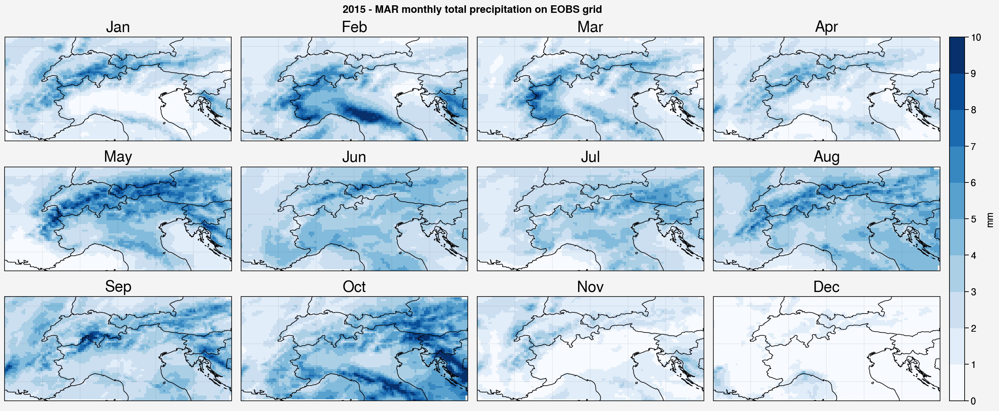

In [49]:
# -------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,ds_TP_v314_2015_regrid_monthly.values[mon],cmap='Blues',vmin=0,vmax=10)
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm/day')

axs.format(**multiplot_format,suptitle="2015 - MAR monthly total precipitation on EOBS grid")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

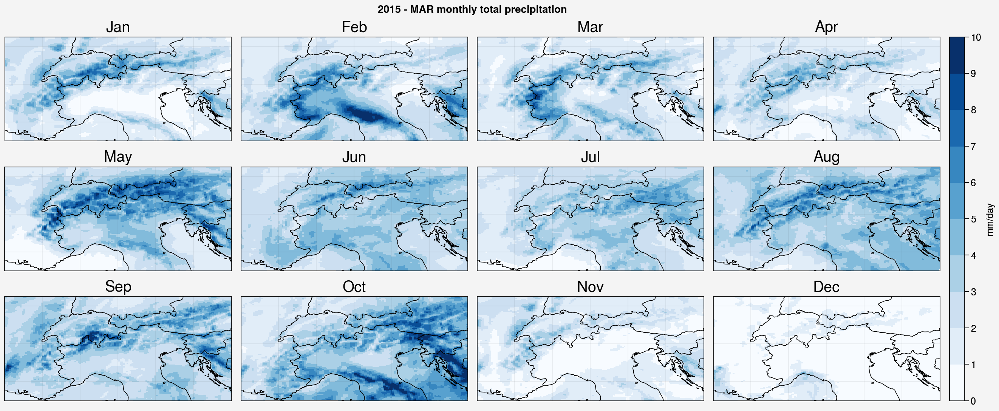

In [52]:
# -------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,ds_TP_test_v314_2015.groupby("time.month").mean("time").values[mon],cmap='Blues',vmin=0,vmax=10)
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm/day')

axs.format(**multiplot_format,suptitle="2015 - MAR monthly total precipitation")



In [27]:
monthly_RR_EOBS = daily_to_monthly(ds_RR_EOBS_2015.values,leap_year=False)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

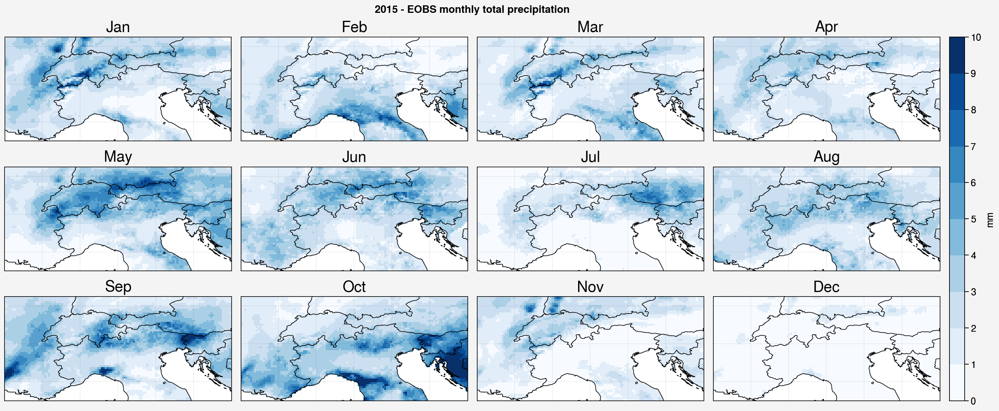

In [55]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,monthly_RR_EOBS[mon],cmap='Blues',vmin=0,vmax=10)
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm')

axs.format(**multiplot_format,suptitle="2015 - EOBS monthly total precipitation")

### Comparing ERA5 with EOBS

In [28]:
#ds_ERA5 = xr.open_dataset('/bettik/castelli/MARin/input/ERA5/2015/ECM.2015.01.01-05.EUR.nc')
ds_t2m_ERA5 = xr.open_dataset('/bettik/castelli/data/ERA5/t2m.2015.asme5.GLOBAL_025.nc')

ds_t2m_ERA5

<xarray.Dataset>
Dimensions:    (longitude: 1440, latitude: 721, time: 12)
Coordinates:
  * longitude  (longitude) float32 0.0 0.25 0.5 0.75 ... 359.0 359.2 359.5 359.8
  * latitude   (latitude) float32 90.0 89.75 89.5 89.25 ... -89.5 -89.75 -90.0
  * time       (time) datetime64[ns] 2015-01-01 2015-02-01 ... 2015-12-01
Data variables:
    t2m        (time, latitude, longitude) float32 ...
Attributes:
    Conventions:                 CF-1.6
    NCO:                         netCDF Operators version 4.9.7 (Homepage = h...
    title:                       ERA5 reanalysis
    data_type:                   1xmonthly fields analysis
    grid_resolution_in_degrees:  0.25
    source:                      credit: ECMWF, COPERNICUS Climate Change Ser...
    history:                     Tue Jun 21 14:53:42 2022: ncatted -a history...

In [29]:
ds_t2m_ERA5_2015 = ds_t2m_ERA5.t2m.isel(latitude=np.arange(160,190,1),longitude=np.arange(15,75,1)) - 273.15
ds_t2m_ERA5_2015.shape

(12, 30, 60)

In [30]:
lon_ERA5 = np.array(ds_t2m_ERA5_2015.longitude)
lat_ERA5 = np.array(ds_t2m_ERA5_2015.latitude)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


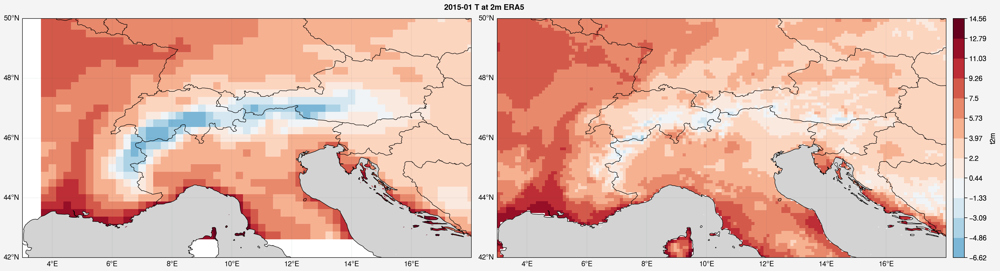

In [28]:
f, axs = pplt.subplots(proj='cyl', axwidth=8,ncols = 2)

map1 = ds_t2m_ERA5_2015[-1]
map2 = monthlyTG_EOBS_2015[-1]

min_colorbar = np.min([np.nanmin(map1),np.nanmin(map2)])
max_colorbar = np.max([np.nanmax(map1),np.nanmax(map2)])

m=axs[0].pcolormesh(lon_ERA5, lat_ERA5, ds_t2m_ERA5_2015[-1], levels=np.linspace(min_colorbar,max_colorbar,13),cmap='RdBu_r')

m=axs[1].pcolormesh(lon_EOBS, lat_EOBS, monthlyTG_EOBS_2015[-1], levels=np.linspace(min_colorbar,max_colorbar,13),cmap='RdBu_r')
f.colorbar(m,label= 't2m')

#axs.format(**normal_format)
axs.format(**big_format)
axs.format(ocean=True,oceancolor='lightgray',reso='hi',suptitle='2015-01 T at 2m ERA5')

In [31]:
ds_TG_EOBS_2015_regridERA5 = u.regrid(ds_TG_EOBS_2015,ds_t2m_ERA5_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False) # globe=True gives an error, because of scipy.sparse.csr_matrix(X)
                                                                                    # in add_matrix_NaNs
ds_TG_EOBS_2015_regridERA5_monthly = ds_TG_EOBS_2015_regridERA5.groupby("time.month").mean("time")


ds_t2m_ERA5_2015_regridEOBS = u.regrid(ds_t2m_ERA5_2015,ds_TG_EOBS_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False)


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

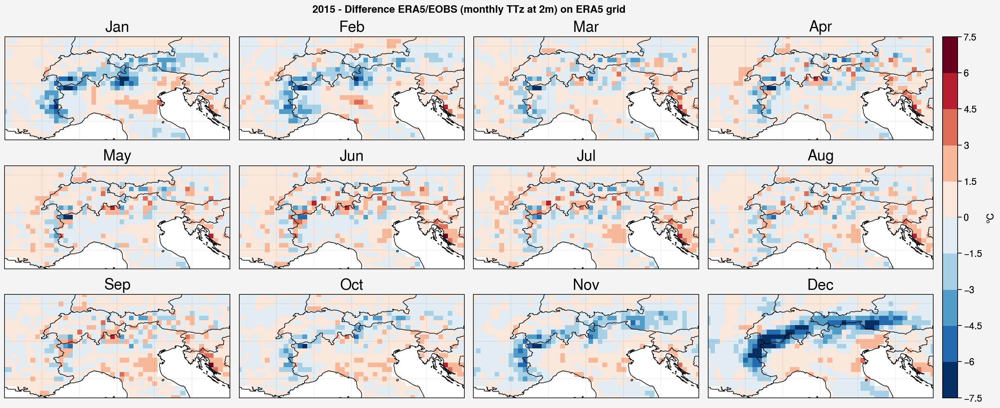

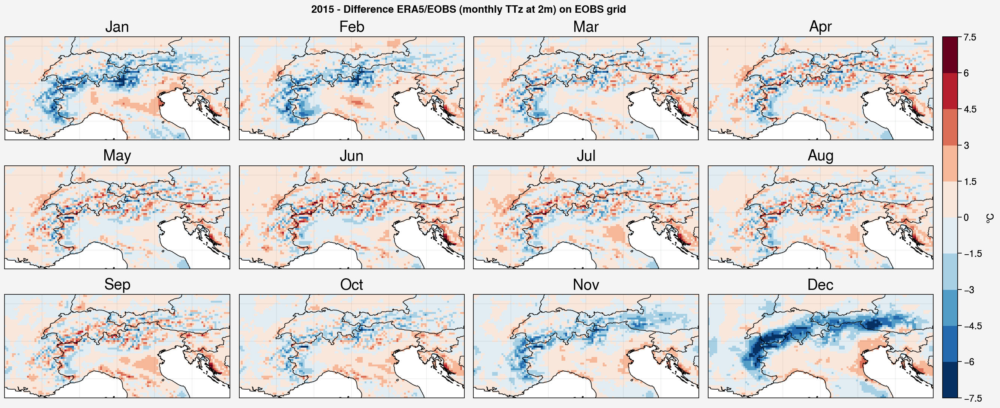

In [33]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_ERA5,lat_ERA5,ds_t2m_ERA5_2015[mon] - ds_TG_EOBS_2015_regridERA5_monthly[mon],levels=np.linspace(-7.5,7.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference ERA5/EOBS (monthly TTz at 2m) on ERA5 grid")

# -----------------------------------------------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,ds_t2m_ERA5_2015_regridEOBS[mon] - monthlyTG_EOBS_2015[mon],levels=np.linspace(-7.5,7.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference ERA5/EOBS (monthly TTz at 2m) on EOBS grid")

In [35]:
toto = ds_t2m_ERA5_2015 - ds_TG_EOBS_2015_regridERA5_monthly

toto.min()

<xarray.DataArray ()>
array(-28.735752, dtype=float32)

In [32]:
np.linspace(-7.5,7.5,11)

array([-7.5, -6. , -4.5, -3. , -1.5,  0. ,  1.5,  3. ,  4.5,  6. ,  7.5])

### EUd

In [7]:
ds_314_new = xr.open_dataset('/bettik/castelli/MARout/EUd/d03/2015/ICE.d03.2015.01.01-31.nc').GF[:,jmin:jmax,imin:imax]#.TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]

ds_314_new

<xarray.DataArray 'GF' (time: 31, y: 91, x: 139)>
[392119 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T12:00:00 ... 2015-01-31T12:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
Attributes:
    units:          W/m2
    long_name:      Ground Flux
    standard_name:  Ground_Flux
    actual_range:   [-2.4407077  3.5539873]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


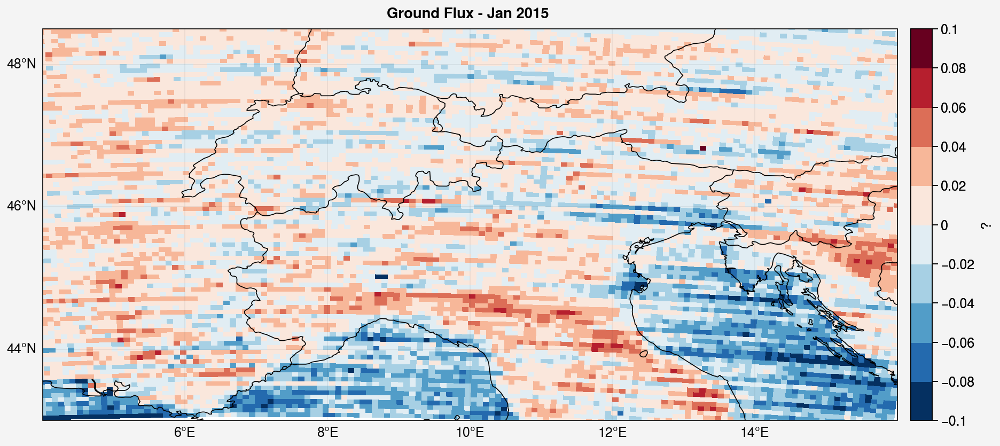

In [8]:
f, axs = pplt.subplots(proj='cyl',axwidth=8)

m = axs.pcolormesh(lon,lat,ds_314_new.mean(axis=0),levels=np.linspace(-0.10,0.10,11),cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= '?')

axs.format(**normal_format,suptitle="Ground Flux - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


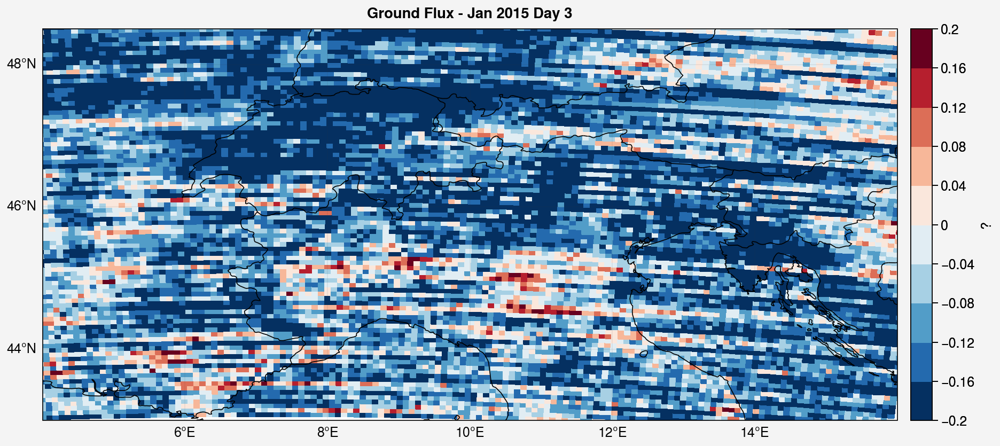

In [11]:
f, axs = pplt.subplots(proj='cyl',axwidth=8)

day = 3

m = axs.pcolormesh(lon,lat,ds_314_new[day],levels=np.linspace(-0.20,0.20,11),cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= '?')

axs.format(**normal_format,suptitle=f"Ground Flux - Jan 2015 Day {day}")

#### EUd - d04 : the one with Elem_A2 = mu__dz instead of Elem_A = dtC_SV * mu__dz in sisvat_tso

In [12]:
ds_314_new = xr.open_dataset('/bettik/castelli/MARout/EUd/d04/2015/ICE.d04.2015.01.01-31.nc').GF[:,jmin:jmax,imin:imax]#.TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_314_new2 = xr.open_dataset('/bettik/castelli/MARout/EUd/d04/2015/ICE.d04.2015.01.01-31.nc').GF2[:,jmin:jmax,imin:imax]#.TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]


ds_314_new

<xarray.DataArray 'GF' (time: 31, y: 91, x: 139)>
[392119 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T12:00:00 ... 2015-01-31T12:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
Attributes:
    units:          W/m2
    long_name:      Ground Flux
    standard_name:  Ground_Flux
    actual_range:   [-2.5947654 14.206194 ]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


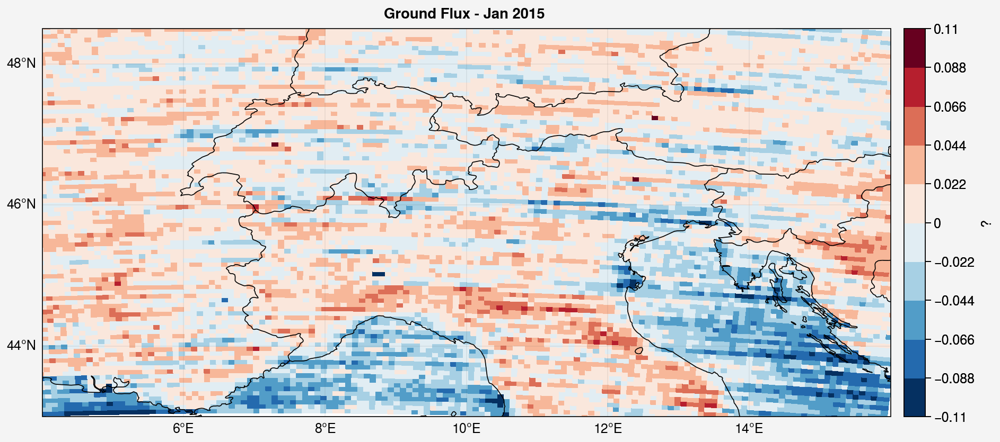

In [13]:
f, axs = pplt.subplots(proj='cyl',axwidth=8)

m = axs.pcolormesh(lon,lat,ds_314_new.mean(axis=0),levels=np.linspace(-0.11,0.11,11),cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= '?')

axs.format(**normal_format,suptitle="Ground Flux - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


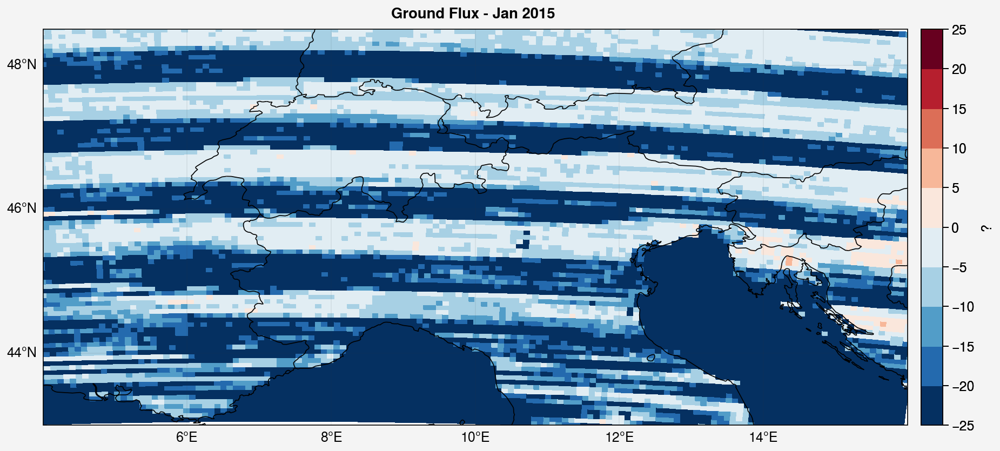

In [21]:
f, axs = pplt.subplots(proj='cyl',axwidth=8)

m = axs.pcolormesh(lon,lat,ds_314_new2[29],levels=np.linspace(-25,25,11),cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= '?')

axs.format(**normal_format,suptitle="Ground Flux - Jan 2015 ")

In [10]:
ds_314_new2.mean(axis=0).min()

<xarray.DataArray 'GF2' ()>
array(-198.54657, dtype=float32)

In [11]:
def energy_balance_maps(path):
    vars = ["SWU","SWD","LWU","LWD","SHF","LHF","Melt","GF"]
    Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
    t_day = 86400 # 60*60*24 seconds in a day

    f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=3,nrows=3)
    
    for i,var in enumerate(vars):
        if var=="Melt":
            ds_MBm = xr.open_dataset(path)["MBm"][:,:,jmin:jmax,imin:imax]
            ds_FRV = xr.open_dataset('/bettik/castelli/data/MAR-EC-Earth3/ICE.EC-Earth3.EUe.FRV.08.1975.nc').FRV[:,jmin:jmax,imin:imax]
            FRV_sect1 = np.array(ds_FRV.sel(sector=1.0)/100)
            FRV_sect2 = np.array(ds_FRV.sel(sector=2.0)/100)
            FRV_sect3 = np.array(ds_FRV.sel(sector=3.0)/100)
            melt_MBm = ds_MBm.sel(sector=1.0)*FRV_sect1 + ds_MBm.sel(sector=2.0)*FRV_sect2 + ds_MBm.sel(sector=3.0)*FRV_sect3
            ds_var = melt_MBm * Lf / t_day
        else:
            ds_var = xr.open_dataset(path)[var][:,jmin:jmax,imin:imax]

        ax=axs[i]
        m = ax.pcolormesh(lon,lat,ds_var.mean(axis=0),levels=np.linspace(-25,25,11),cmap='RdBu_r',title=var)

    
    f.colorbar(m, label= '?')

    axs.format(**normal_format,suptitle="Ground Flux - Jan 2015 ",titlesize='20px')

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

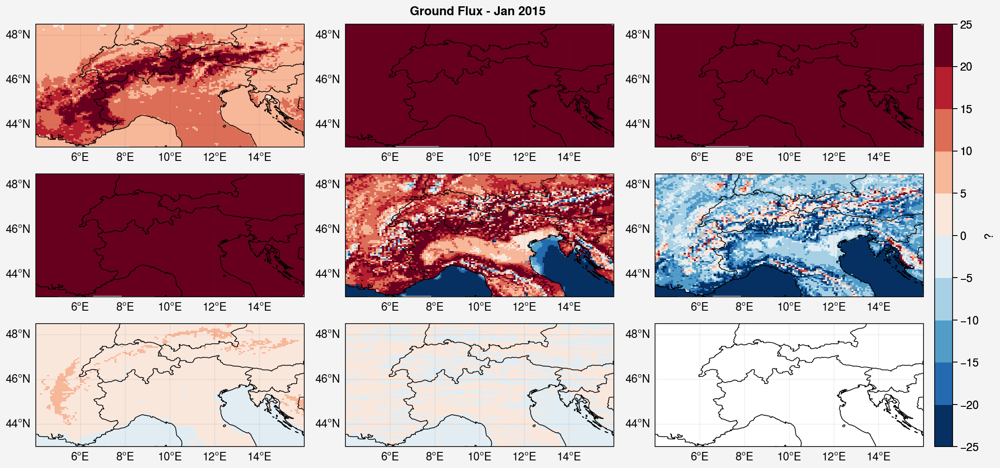

In [45]:
energy_balance_maps('/bettik/castelli/MARout/EUd/d04/2015/ICE.d04.2015.01.01-31.nc')

In [12]:
var = "SWD"

ds_var = xr.open_dataset('/bettik/castelli/MARout/EUd/d04/2015/ICE.d04.2015.01.01-31.nc')[var][:,jmin:jmax,imin:imax]
ds_var.mean(axis=0)

<xarray.DataArray 'SWD' (y: 91, x: 139)>
array([[83.04756 , 82.46462 , 82.90699 , ..., 74.70261 , 75.77675 ,
        76.30637 ],
       [82.94017 , 82.352715, 82.33008 , ..., 74.95825 , 75.28668 ,
        75.10056 ],
       [83.17904 , 82.345345, 81.84756 , ..., 74.80382 , 74.91698 ,
        74.651344],
       ...,
       [27.649075, 29.116533, 28.663809, ..., 34.98322 , 34.728634,
        34.442947],
       [27.83513 , 28.865166, 27.29064 , ..., 34.39458 , 34.364365,
        33.71391 ],
       [27.911991, 29.093287, 25.953823, ..., 33.905613, 33.64616 ,
        32.46786 ]], dtype=float32)
Coordinates:
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0

In [17]:
ds_SWU = xr.open_dataset('/bettik/castelli/MARout/EUd/d04/2015/ICE.d04.2015.01.01-31.nc')["SWU"][:,jmin:jmax,imin:imax]
ds_SWD = xr.open_dataset('/bettik/castelli/MARout/EUd/d04/2015/ICE.d04.2015.01.01-31.nc')["SWD"][:,jmin:jmax,imin:imax]
ds_NSW = ds_SWD - ds_SWU

ds_LWU = xr.open_dataset('/bettik/castelli/MARout/EUd/d04/2015/ICE.d04.2015.01.01-31.nc')["LWU"][:,jmin:jmax,imin:imax]
ds_LWD = xr.open_dataset('/bettik/castelli/MARout/EUd/d04/2015/ICE.d04.2015.01.01-31.nc')["LWD"][:,jmin:jmax,imin:imax]
ds_NLW = ds_LWD - ds_LWU

ds_SHF = xr.open_dataset('/bettik/castelli/MARout/EUd/d04/2015/ICE.d04.2015.01.01-31.nc')["SHF"][:,jmin:jmax,imin:imax]
ds_LHF = xr.open_dataset('/bettik/castelli/MARout/EUd/d04/2015/ICE.d04.2015.01.01-31.nc')["LHF"][:,jmin:jmax,imin:imax]

# Melt
Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
t_day = 86400 # 60*60*24 seconds in a day
ds_MBm = xr.open_dataset('/bettik/castelli/MARout/EUd/d04/2015/ICE.d04.2015.01.01-31.nc')["MBm"][:,:,jmin:jmax,imin:imax]
ds_FRV = xr.open_dataset('/bettik/castelli/data/MAR-EC-Earth3/ICE.EC-Earth3.EUe.FRV.08.1975.nc').FRV[:,jmin:jmax,imin:imax]
FRV_sect1 = np.array(ds_FRV.sel(sector=1.0)/100)
FRV_sect2 = np.array(ds_FRV.sel(sector=2.0)/100)
FRV_sect3 = np.array(ds_FRV.sel(sector=3.0)/100)
melt_MBm = ds_MBm.sel(sector=1.0)*FRV_sect1 + ds_MBm.sel(sector=2.0)*FRV_sect2 + ds_MBm.sel(sector=3.0)*FRV_sect3
ds_melt = melt_MBm * Lf / t_day

ds_surf_balance = ds_NSW + ds_NLW + ds_SHF + ds_LHF + ds_melt

ds_GF = xr.open_dataset('/bettik/castelli/MARout/EUd/d04/2015/ICE.d04.2015.01.01-31.nc')["GF"][:,jmin:jmax,imin:imax]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

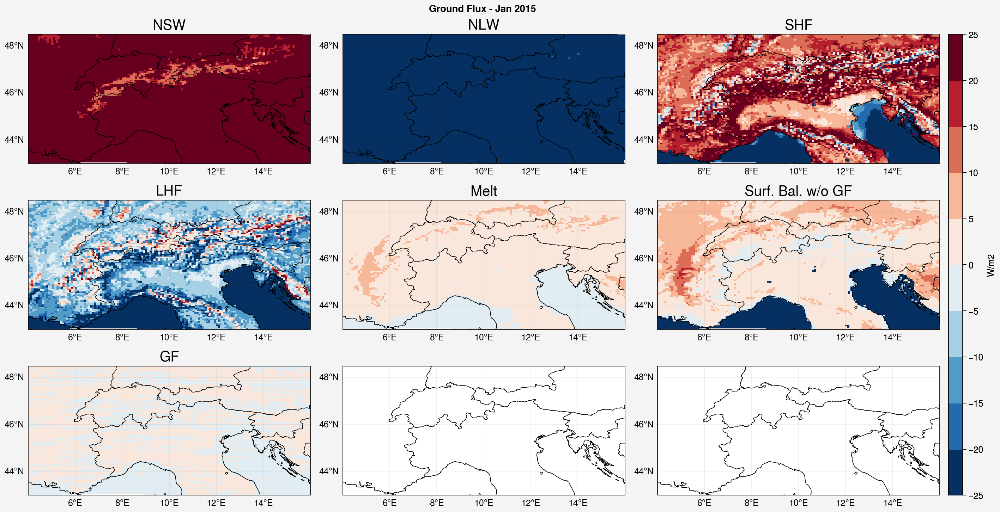

In [18]:
f, axs = pplt.subplots(proj='cyl',axwidth=4,ncols=3,nrows=3)

all_ds = [ds_NSW, ds_NLW, ds_SHF, ds_LHF, ds_melt, ds_surf_balance, ds_GF]
names_var = ['NSW','NLW','SHF','LHF','Melt','Surf. Bal. w/o GF','GF']

for i,var in enumerate(names_var):
    ax = axs[i]
    m = ax.pcolormesh(lon,lat,all_ds[i].mean(axis=0),cmap='RdBu_r',levels=np.linspace(-25,25,11))
    ax.format(titlesize='20px',title=var)

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="Ground Flux - Jan 2015 ")

#### d07

In [15]:
ds_314_MB = xr.open_dataset('/bettik/castelli/MARout/EUd/d07/2015/ICE.d07.2015.01.01-05.nc').MB[:,:,jmin:jmax,imin:imax].max(axis=1)
ds_314_MB

<xarray.DataArray 'MB' (time: 5, y: 91, x: 139)>
array([[[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 2.0814002 ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 2.0885952 ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 1.8200046 ]],

       [[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
...
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ]],

       [[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.99904996, ..., 0.        ,
         0.        , 0.        ]]], dtype=float32)
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T12:00:00 ... 2015-01-05T12:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

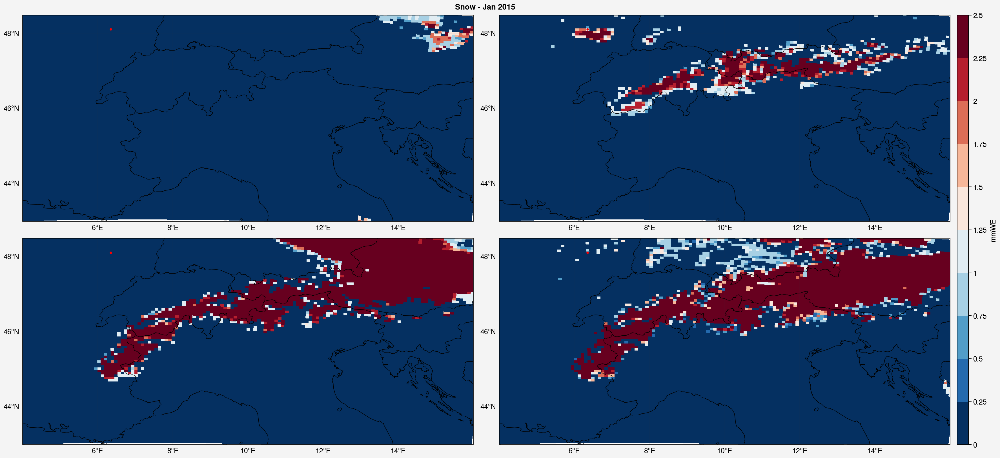

In [18]:
f, axs = pplt.subplots(proj='cyl',axwidth=8,ncols=2,nrows=2)

for day in range(4):
    m = axs[day].pcolormesh(lon,lat,ds_314_MB[day],levels=np.linspace(0,2.5,11),cmap='RdBu_r')
    axs[day].plot(ds.LON[100,60], ds.LAT[100,60],'ro',markersize=2)
axs.format(titlesize='20px')

f.colorbar(m, label= 'mmWE')

axs.format(**normal_format,suptitle="Snow - Jan 2015 ")

#### d08

In [8]:
ds_314_GF2 = xr.open_dataset('/bettik/castelli/MARout/EUd/d08/2015/ICE.d08.2015.01.01-05.nc').GF2[:,jmin:jmax,imin:imax]
ds_314_GF2

<xarray.DataArray 'GF2' (time: 5, y: 91, x: 139)>
[63245 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T12:00:00 ... 2015-01-05T12:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
Attributes:
    units:          W/m2
    long_name:      Ground Flux 2 (no heat capacity)
    standard_name:  Ground_Flux_2__no_heat_capacity_
    actual_range:   [-1982.8564   857.9046]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


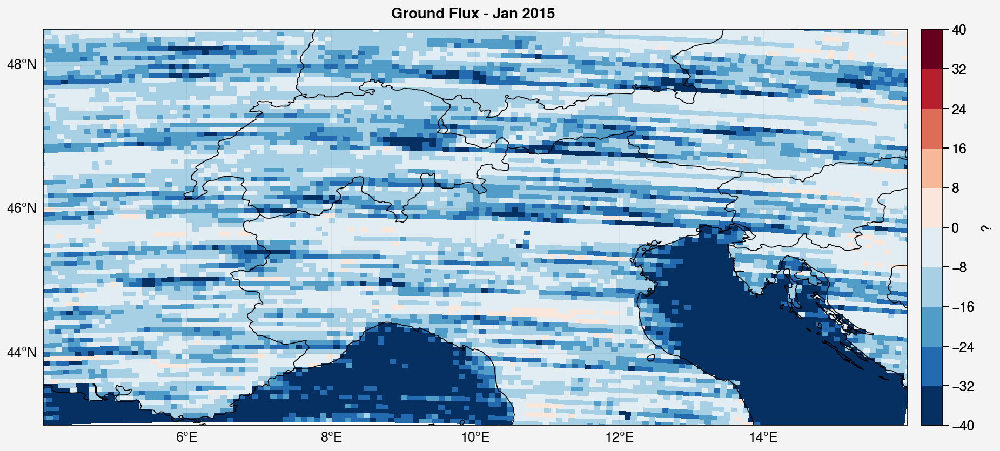

In [14]:
f, axs = pplt.subplots(proj='cyl',axwidth=8)

m = axs.pcolormesh(lon,lat,ds_314_GF2[3],levels=np.linspace(-40,40,11),cmap='RdBu_r')
#m = axs.pcolormesh(lon,lat,ds_314_GF2[3],cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= '?')

axs.format(**normal_format,suptitle="Ground Flux - Jan 2015 ")

#### d09 : every two hours, ICS and MAR netcdf files

In [25]:
#dsMAR_ETSo_d = xr.open_dataset('/bettik/castelli/MARout/EUd/d09/2015/MAR.d09.2015.01.01-05.nc').ETSo_dSL[:,:,jmin:jmax,imin:imax]
#dsMAR_ETSo_d

In [26]:
# f, axs = pplt.subplots(proj='cyl',axwidth=4,ncols=4,nrows=3)

# for i in np.arange(6,18,1):
#     print(i)
#     m = axs[i-6].pcolormesh(lon,lat,dsMAR_ETSo_d[i,0],cmap='RdBu_r')#,levels=np.linspace(0,2.5,11))
# axs.format(titlesize='20px')

# f.colorbar(m, label= 'W/m2')

# axs.format(**normal_format,suptitle="ETSo_d - Jan 2015 ")

#### d10

In [10]:
dsMAR_ETSo_d = xr.open_dataset('/bettik/castelli/MARout/EUd/d10/2015/MAR.d10.2015.01.01-05.nc').ETSo_dSL[:,:,jmin:jmax,imin:imax]
dsMAR_ETSo_d

<xarray.DataArray 'ETSo_dSL' (time: 61, sector: 3, y: 91, x: 139)>
[2314767 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01 2015-01-01T02:00:00 ... 2015-01-06
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
  * sector   (sector) float32 1.0 2.0 3.0
Attributes:
    units:          W/m2
    long_name:      Energy forcing at the surface (sans ground flux)
    standard_name:  Energy_forcing_at_the_surface__sans_ground_flux_
    actual_range:   [-1379.6091    641.47656]

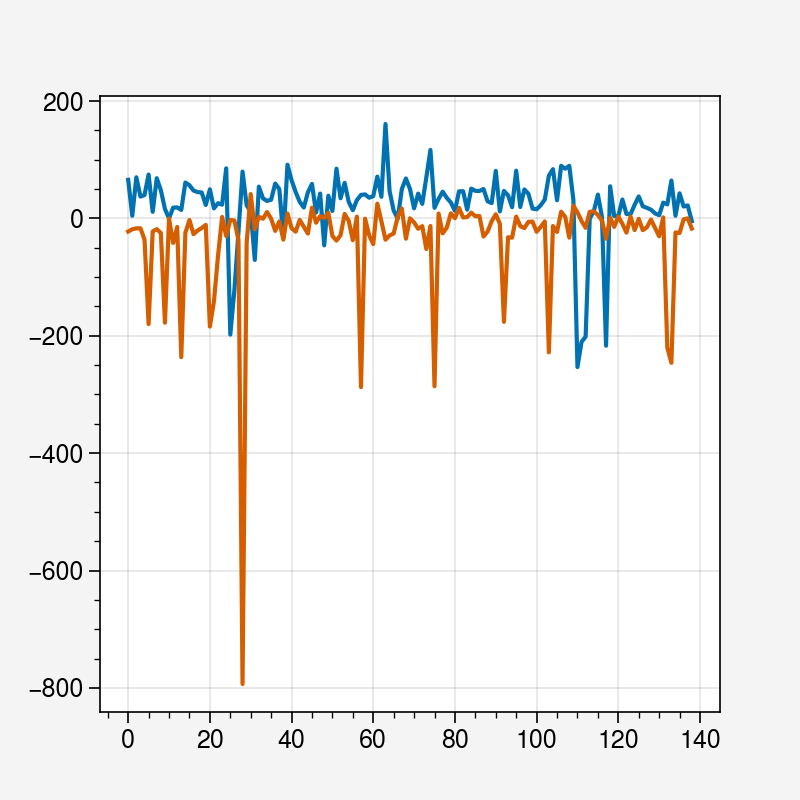

In [22]:
plt.plot(np.array(dsMAR_ETSo_d[6,0,50]))
plt.plot(np.array(dsMAR_ETSo_d[12,0,50]))

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

6
7
8
9
10
11
12
13
14
15
16
17


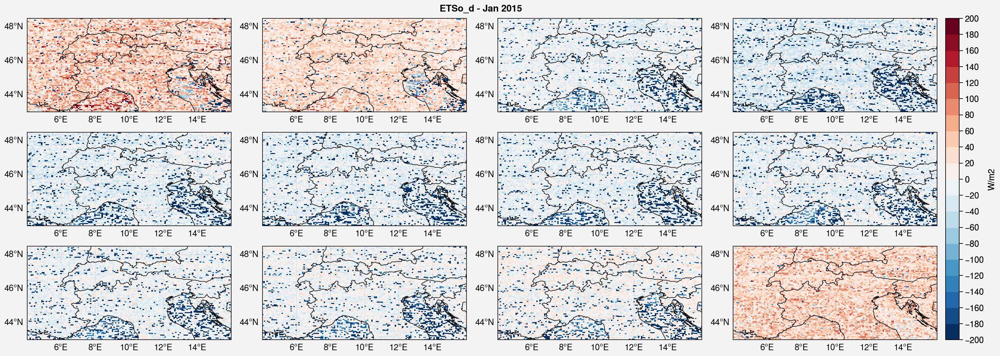

In [23]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for i in np.arange(6,18,1):
    print(i)
    m = axs[i-6].pcolormesh(lon,lat,dsMAR_ETSo_d[i,0],cmap='RdBu_r',levels=np.linspace(-200,200,21))
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="ETSo_d - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

6
7
8
9
10
11
12
13
14
15
16
17


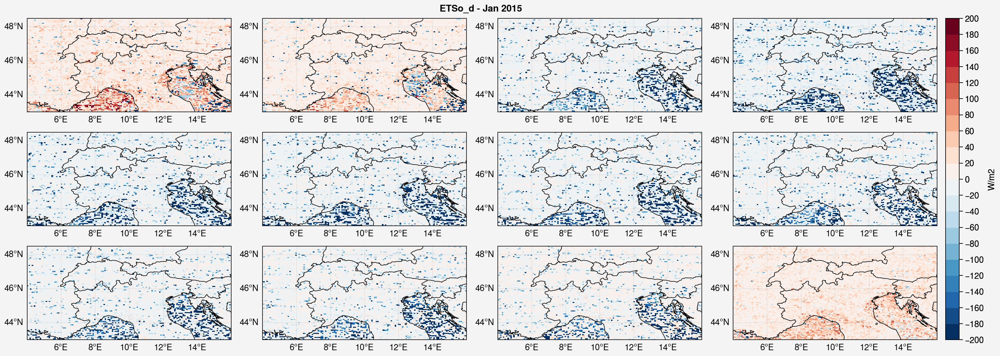

In [24]:
ETSo_d_allsect = dsMAR_ETSo_d.sel(sector=1.0)*np.array(ds.FRV.sel(sector=1.0)[jmin:jmax,imin:imax]/100)
+ dsMAR_ETSo_d.sel(sector=2.0)*np.array(ds.FRV.sel(sector=2.0)[jmin:jmax,imin:imax]/100)
+ dsMAR_ETSo_d.sel(sector=3.0)*np.array(ds.FRV.sel(sector=3.0)[jmin:jmax,imin:imax]/100)

f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for i in np.arange(6,18,1):
    print(i)
    m = axs[i-6].pcolormesh(lon,lat,ETSo_d_allsect[i],cmap='RdBu_r',levels=np.linspace(-200,200,21))
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="ETSo_d - Jan 2015 ")

In [30]:
ds_314_GF2 = xr.open_dataset('/bettik/castelli/MARout/EUd/d10/2015/ICE.d10.2015.01.01-05.nc').GF2[:,jmin:jmax,imin:imax]
ds_314_GF2_d08 = xr.open_dataset('/bettik/castelli/MARout/EUd/d08/2015/ICE.d08.2015.01.01-05.nc').GF2[:,jmin:jmax,imin:imax]

ds_314_GF2

<xarray.DataArray 'GF2' (time: 60, y: 91, x: 139)>
[758940 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T01:00:00 ... 2015-01-05T23:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
Attributes:
    units:          W/m2
    long_name:      Ground Flux 2 (no heat capacity)
    standard_name:  Ground_Flux_2__no_heat_capacity_
    actual_range:   [-3930.3748  1559.2427]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


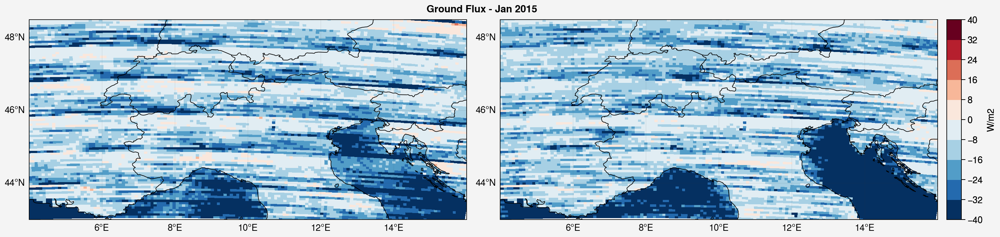

In [58]:
f, axs = pplt.subplots(proj='cyl',axwidth=6,ncols=2)

# not the same because d10 has values every 2 hours

m = axs[0].pcolormesh(lon,lat,ds_314_GF2[23],levels=np.linspace(-40,40,11),cmap='RdBu_r')
m = axs[1].pcolormesh(lon,lat,ds_314_GF2_d08[3],levels=np.linspace(-40,40,11),cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="Ground Flux - Jan 2015 ")

#### d11

In [9]:
dsMAR_ETSo_d = xr.open_dataset('/bettik/castelli/MARout/EUd/d11/2015/MAR.d11.2015.01.01-05.nc').ETSo_dSL[:,:,jmin:jmax,imin:imax]
dsMAR_ETSo_d

<xarray.DataArray 'ETSo_dSL' (time: 61, sector: 3, y: 91, x: 139)>
[2314767 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01 2015-01-01T02:00:00 ... 2015-01-06
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
  * sector   (sector) float32 1.0 2.0 3.0
Attributes:
    units:          W/m2
    long_name:      Energy forcing at the surface (sans ground flux)
    standard_name:  Energy_forcing_at_the_surface__sans_ground_flux_
    actual_range:   [-1379.5249    686.91223]

In [10]:
dsICS_ETSo_d = xr.open_dataset('/bettik/castelli/MARout/EUd/d11/2015/ICS.d11.2015.01.01-05.nc').ETSo_d[:,jmin:jmax,imin:imax]
dsICS_ETSo_d

<xarray.DataArray 'ETSo_d' (time: 60, y: 91, x: 139)>
[758940 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T02:00:00 ... 2015-01-06
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
Attributes:
    units:          W/m2
    long_name:      ETSo_d integrated over time
    standard_name:  ETSo_d_integrated_over_time
    actual_range:   [-1379.5249    503.96524]

In [11]:
ds_314_GF2 = xr.open_dataset('/bettik/castelli/MARout/EUd/d11/2015/ICE.d11.2015.01.01-05.nc').GF2[:,jmin:jmax,imin:imax]
ds_314_SAbs = xr.open_dataset('/bettik/castelli/MARout/EUd/d11/2015/ICE.d11.2015.01.01-05.nc').SAbs[:,jmin:jmax,imin:imax]
ds_314_ETSo_d = xr.open_dataset('/bettik/castelli/MARout/EUd/d11/2015/ICE.d11.2015.01.01-05.nc').ETSo_d[:,jmin:jmax,imin:imax]

ds_314_SAbs

<xarray.DataArray 'SAbs' (time: 60, y: 91, x: 139)>
[758940 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T01:00:00 ... 2015-01-05T23:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
Attributes:
    units:          W/m2
    long_name:      Solar Absorption
    standard_name:  Solar_Absorption
    actual_range:   [  0.      233.07776]

In [12]:
ds_314_ETSo_d

<xarray.DataArray 'ETSo_d' (time: 60, y: 91, x: 139)>
[758940 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T01:00:00 ... 2015-01-05T23:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
Attributes:
    units:          W/m2
    long_name:      ETSo_d integrated over time
    standard_name:  ETSo_d_integrated_over_time
    actual_range:   [-443.79123  125.88068]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

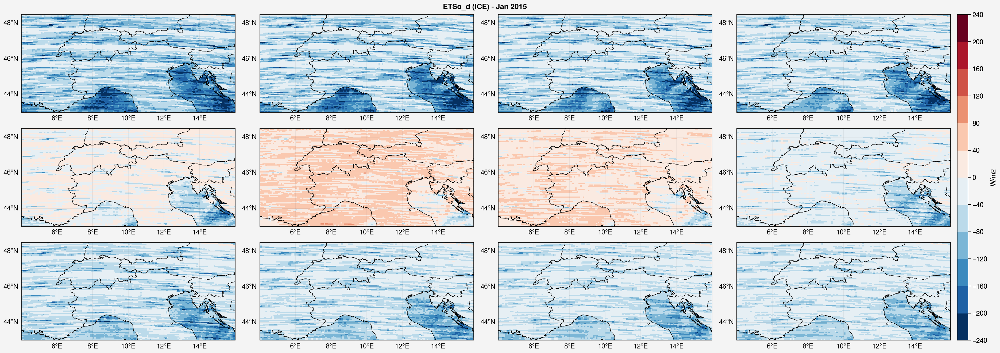

In [14]:
f, axs = pplt.subplots(proj='cyl',axwidth=4,ncols=4,nrows=3)

for i in range(12):
    m = axs[i].pcolormesh(lon,lat,ds_314_ETSo_d[i],levels=np.linspace(-240,240,13),cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="ETSo_d (ICE) - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

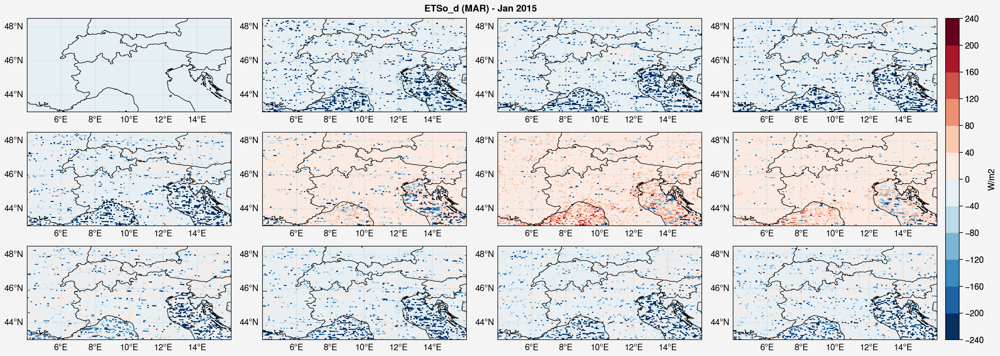

In [15]:
ETSo_d_allsect = dsMAR_ETSo_d.sel(sector=1.0)*np.array(ds.FRV.sel(sector=1.0)[jmin:jmax,imin:imax]/100)
+ dsMAR_ETSo_d.sel(sector=2.0)*np.array(ds.FRV.sel(sector=2.0)[jmin:jmax,imin:imax]/100)
+ dsMAR_ETSo_d.sel(sector=3.0)*np.array(ds.FRV.sel(sector=3.0)[jmin:jmax,imin:imax]/100)

f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for i in range(12):
    m = axs[i].pcolormesh(lon,lat,ETSo_d_allsect[i],cmap='RdBu_r',levels=np.linspace(-240,240,13))
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="ETSo_d (MAR) - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

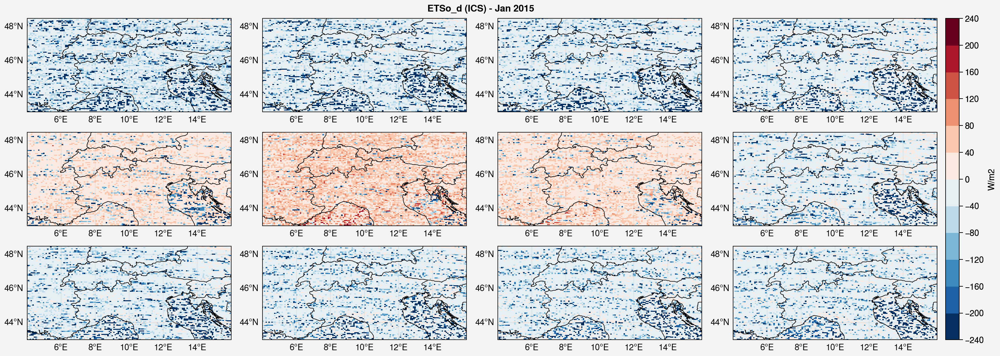

In [16]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for i in range(12):
    m = axs[i].pcolormesh(lon,lat,dsICS_ETSo_d[i],levels=np.linspace(-240,240,13),cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="ETSo_d (ICS) - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


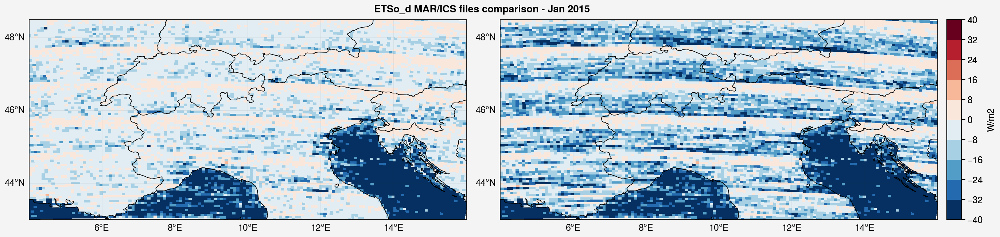

In [48]:
f, axs = pplt.subplots(proj='cyl',axwidth=6,ncols=2)

m = axs[0].pcolormesh(lon,lat,ETSo_d_allsect[1:].mean(axis=0),levels=np.linspace(-40,40,11),cmap='RdBu_r')
m = axs[1].pcolormesh(lon,lat,dsICS_ETSo_d[:].mean(axis=0),levels=np.linspace(-40,40,11),cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="ETSo_d MAR/ICS files comparison - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


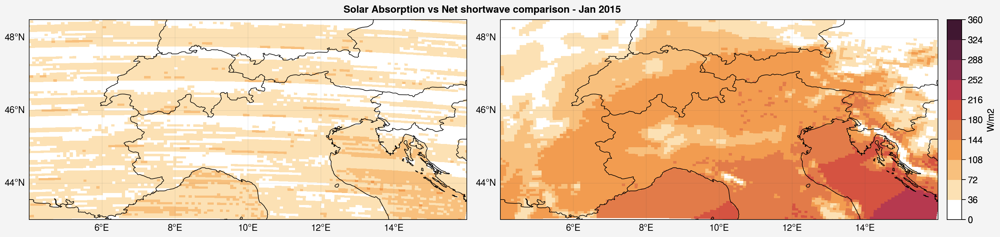

In [23]:
ds_314_SWD = xr.open_dataset('/bettik/castelli/MARout/EUd/d11/2015/ICE.d11.2015.01.01-05.nc').SWD[:,jmin:jmax,imin:imax]
ds_314_SWU = xr.open_dataset('/bettik/castelli/MARout/EUd/d11/2015/ICE.d11.2015.01.01-05.nc').SWU[:,jmin:jmax,imin:imax]
ds_314_NSW = ds_314_SWD - ds_314_SWU

f, axs = pplt.subplots(proj='cyl',axwidth=6,ncols=2)

m = axs[0].pcolormesh(lon,lat,ds_314_SAbs[4],levels=np.linspace(0,360,11))#,cmap='RdBu_r')
m = axs[1].pcolormesh(lon,lat,ds_314_NSW[4],levels=np.linspace(0,360,11))#,cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="Solar Absorption vs Net shortwave comparison - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


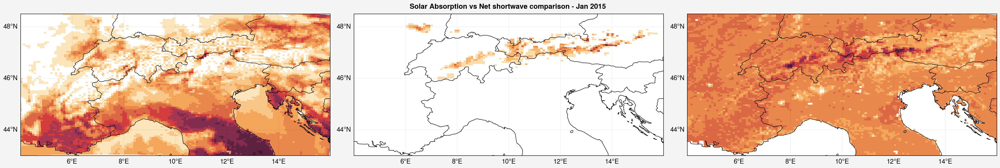

In [36]:
ds_314_MB = xr.open_dataset('/bettik/castelli/MARout/EUd/d11/2015/ICE.d11.2015.01.01-05.nc').MB.max(axis=1)[:,jmin:jmax,imin:imax]
ds_314_AL = xr.open_dataset('/bettik/castelli/MARout/EUd/d11/2015/ICE.d11.2015.01.01-05.nc').AL[:,jmin:jmax,imin:imax]

f, axs = pplt.subplots(proj='cyl',axwidth=6,ncols=3)

m = axs[0].pcolormesh(lon,lat,ds_314_SWU[28])#,levels=np.linspace(0,360,11))#,cmap='RdBu_r')
m = axs[1].pcolormesh(lon,lat,ds_314_MB[28])#,levels=np.linspace(0,360,11))#,cmap='RdBu_r')
m = axs[2].pcolormesh(lon,lat,ds_314_AL[28])#,levels=np.linspace(0,360,11))#,cmap='RdBu_r')

axs.format(titlesize='20px')

#f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="Solar Absorption vs Net shortwave comparison - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

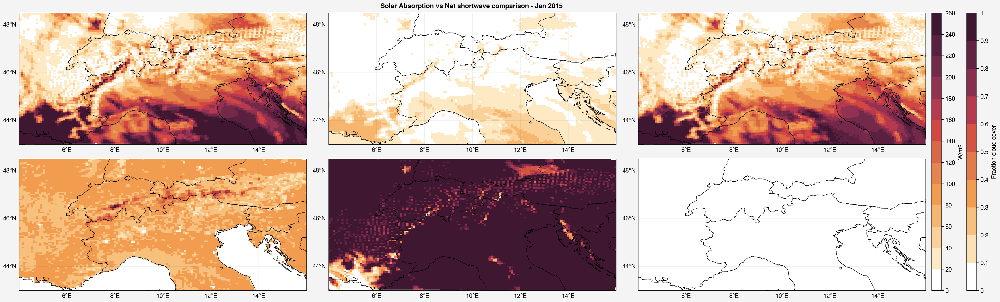

In [47]:
ds_314_CC = xr.open_dataset('/bettik/castelli/MARout/EUd/d11/2015/ICE.d11.2015.01.01-05.nc').CC[:,jmin:jmax,imin:imax]

f, axs = pplt.subplots(proj='cyl',axwidth=6,ncols=3,nrows=2)

m = axs[0].pcolormesh(lon,lat,ds_314_SWD[30],levels=np.linspace(0,260,14))#,cmap='RdBu_r')
m = axs[1].pcolormesh(lon,lat,ds_314_SWU[30],levels=np.linspace(0,260,14))#,cmap='RdBu_r')
m = axs[2].pcolormesh(lon,lat,ds_314_NSW[30],levels=np.linspace(0,260,14))#,cmap='RdBu_r')
f.colorbar(m, label= 'W/m2')
m = axs[3].pcolormesh(lon,lat,ds_314_AL[30])#,levels=np.linspace(0,360,11))#,cmap='RdBu_r')
m = axs[4].pcolormesh(lon,lat,ds_314_CC[30])#,levels=np.linspace(0,360,11))#,cmap='RdBu_r')
f.colorbar(m, label= 'Fraction cloud cover')

axs.format(titlesize='20px')

#f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="Solar Absorption vs Net shortwave comparison - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


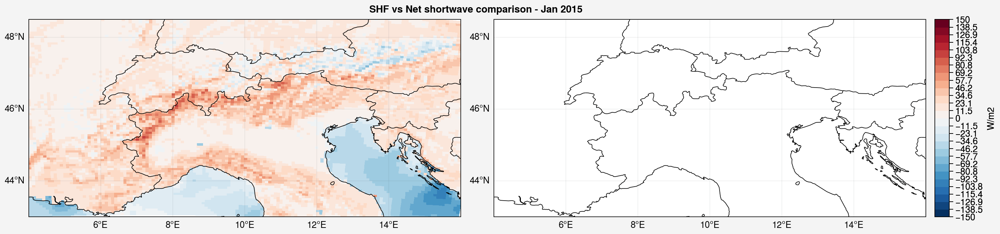

In [57]:
ds_314_SHF = xr.open_dataset('/bettik/castelli/MARout/EUd/d11/2015/ICE.d11.2015.01.01-05.nc').SHF[:,jmin:jmax,imin:imax]

f, axs = pplt.subplots(proj='cyl',axwidth=6,ncols=2)

m = axs[0].pcolormesh(lon,lat,ds_314_SHF[:].mean(axis=0),levels=np.linspace(-150,150,27))#,cmap='RdBu_r')
#m = axs[1].pcolormesh(lon,lat,ds_314_NSW[4],levels=np.linspace(0,360,11))#,cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="SHF vs Net shortwave comparison - Jan 2015 ")

In [50]:
ds_314_SHF

<xarray.DataArray 'SHF' (time: 60, y: 91, x: 139)>
[758940 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T01:00:00 ... 2015-01-05T23:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
Attributes:
    units:          W/m2
    long_name:      Sensible Heat Flux
    standard_name:  Sensible_Heat_Flux
    actual_range:   [-514.7787   372.09183]

#### d12

In [8]:
ds_314_GF2 = xr.open_dataset('/bettik/castelli/MARout/EUd/d12/2015/ICE.d12.2015.01.01-05.nc').GF2[:,jmin:jmax,imin:imax]
ds_314_GF2

<xarray.DataArray 'GF2' (time: 60, y: 91, x: 139)>
[758940 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T01:00:00 ... 2015-01-05T23:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
Attributes:
    units:          W/m2
    long_name:      Ground Flux 2 (no heat capacity)
    standard_name:  Ground_Flux_2__no_heat_capacity_
    actual_range:   [-4835.6245  1695.4811]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

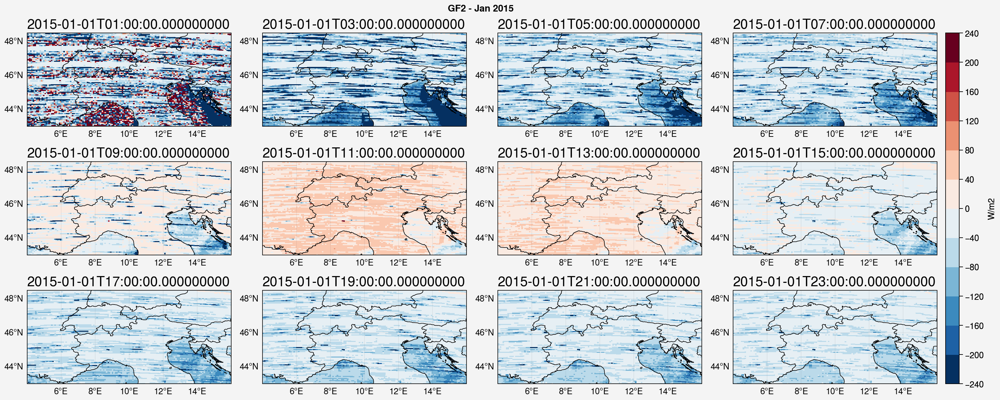

In [10]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for i in range(12):
    m = axs[i].pcolormesh(lon,lat,ds_314_GF2[i],cmap='RdBu_r',levels=np.linspace(-240,240,13))
    axs[i].format(abcloc='l', titleloc='l', title=np.array(ds_314_GF2.time[i]))
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

#axs[:3].format(abcloc='l', titleloc='l', title=np.array(ds_314_GF2.time[:3]))
axs.format(**normal_format,suptitle="GF2 - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

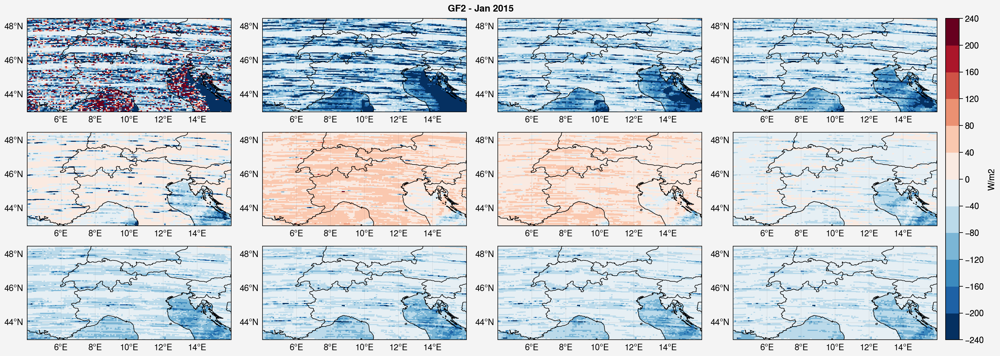

In [14]:
ds_314_GF2 = xr.open_dataset('/bettik/castelli/MARout/EUd/d10/2015/ICE.d10.2015.01.01-05.nc').GF2[:,jmin:jmax,imin:imax]

f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for i in range(12):
    m = axs[i].pcolormesh(lon,lat,ds_314_GF2[i],cmap='RdBu_r',levels=np.linspace(-240,240,13))
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="GF2 - Jan 2015 ")

In [20]:
np.array(ds_314_GF2.time[:12])

array(['2015-01-01T01:00:00.000000000', '2015-01-01T03:00:00.000000000',
       '2015-01-01T05:00:00.000000000', '2015-01-01T07:00:00.000000000',
       '2015-01-01T09:00:00.000000000', '2015-01-01T11:00:00.000000000',
       '2015-01-01T13:00:00.000000000', '2015-01-01T15:00:00.000000000',
       '2015-01-01T17:00:00.000000000', '2015-01-01T19:00:00.000000000',
       '2015-01-01T21:00:00.000000000', '2015-01-01T23:00:00.000000000'],
      dtype='datetime64[ns]')

#### d13

In [8]:
ds_314_GF2 = xr.open_dataset('/bettik/castelli/MARout/EUd/d13/2015/ICE.d13.2015.01.01-05.nc').GF2[:,jmin:jmax,imin:imax]
ds_314_GF2

<xarray.DataArray 'GF2' (time: 60, y: 91, x: 139)>
[758940 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T01:00:00 ... 2015-01-05T23:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
Attributes:
    units:          W/m2
    long_name:      Ground Flux 2 (no heat capacity)
    standard_name:  Ground_Flux_2__no_heat_capacity_
    actual_range:   [-12836.792    2738.3794]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

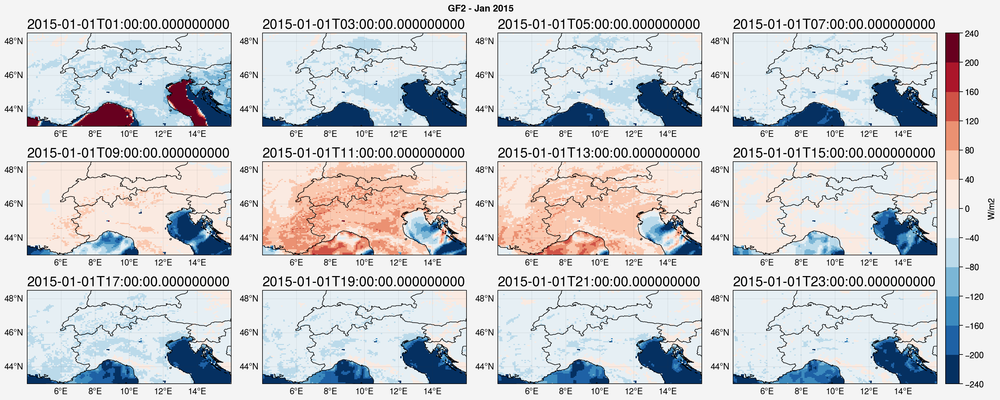

In [9]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for i in range(12):
    m = axs[i].pcolormesh(lon,lat,ds_314_GF2[i],cmap='RdBu_r',levels=np.linspace(-240,240,13))
    axs[i].format(abcloc='l', titleloc='l', title=np.array(ds_314_GF2.time[i]))
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

#axs[:3].format(abcloc='l', titleloc='l', title=np.array(ds_314_GF2.time[:3]))
axs.format(**normal_format,suptitle="GF2 - Jan 2015 ")

In [9]:
ds_SWU = xr.open_dataset('/bettik/castelli/MARout/EUd/d13/2015/ICE.d13.2015.01.01-05.nc')["SWU"][:,jmin:jmax,imin:imax]
ds_SWD = xr.open_dataset('/bettik/castelli/MARout/EUd/d13/2015/ICE.d13.2015.01.01-05.nc')["SWD"][:,jmin:jmax,imin:imax]
ds_NSW = ds_SWD - ds_SWU

ds_LWU = xr.open_dataset('/bettik/castelli/MARout/EUd/d13/2015/ICE.d13.2015.01.01-05.nc')["LWU"][:,jmin:jmax,imin:imax]
ds_LWD = xr.open_dataset('/bettik/castelli/MARout/EUd/d13/2015/ICE.d13.2015.01.01-05.nc')["LWD"][:,jmin:jmax,imin:imax]
ds_NLW = ds_LWD - ds_LWU

ds_SHF = xr.open_dataset('/bettik/castelli/MARout/EUd/d13/2015/ICE.d13.2015.01.01-05.nc')["SHF"][:,jmin:jmax,imin:imax]
ds_LHF = xr.open_dataset('/bettik/castelli/MARout/EUd/d13/2015/ICE.d13.2015.01.01-05.nc')["LHF"][:,jmin:jmax,imin:imax]

# Melt
Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
t_day = 86400 # 60*60*24 seconds in a day
ds_MBm = xr.open_dataset('/bettik/castelli/MARout/EUd/d13/2015/ICE.d13.2015.01.01-05.nc')["MBm"][:,:,jmin:jmax,imin:imax]
ds_FRV = xr.open_dataset('/bettik/castelli/data/MAR-EC-Earth3/ICE.EC-Earth3.EUe.FRV.08.1975.nc').FRV[:,jmin:jmax,imin:imax]
FRV_sect1 = np.array(ds_FRV.sel(sector=1.0)/100)
FRV_sect2 = np.array(ds_FRV.sel(sector=2.0)/100)
FRV_sect3 = np.array(ds_FRV.sel(sector=3.0)/100)
melt_MBm = ds_MBm.sel(sector=1.0)*FRV_sect1 + ds_MBm.sel(sector=2.0)*FRV_sect2 + ds_MBm.sel(sector=3.0)*FRV_sect3
ds_melt = melt_MBm * Lf / t_day

ds_surf_balance = ds_NSW + ds_NLW + ds_SHF + ds_LHF + ds_melt

ds_ETSo_d = xr.open_dataset('/bettik/castelli/MARout/EUd/d13/2015/ICE.d13.2015.01.01-05.nc')["ETSo_d"][:,jmin:jmax,imin:imax]


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

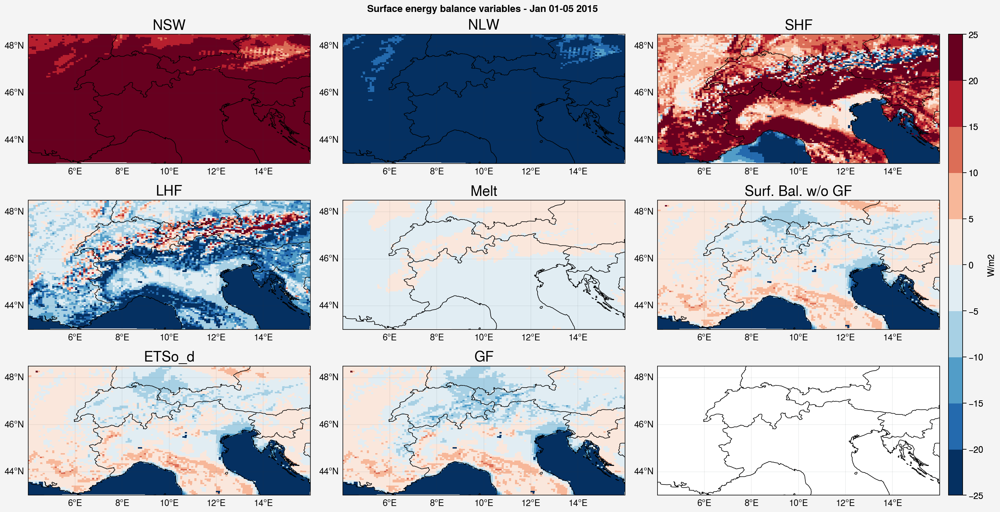

In [35]:
f, axs = pplt.subplots(proj='cyl',axwidth=4,ncols=3,nrows=3)

all_ds = [ds_NSW, ds_NLW, ds_SHF, ds_LHF, ds_melt, ds_surf_balance, ds_ETSo_d, ds_314_GF2]
names_var = ['NSW','NLW','SHF','LHF','Melt','Surf. Bal. w/o GF','ETSo_d','GF']

for i,var in enumerate(names_var):
    ax = axs[i]
    m = ax.pcolormesh(lon,lat,all_ds[i].mean(axis=0),cmap='RdBu_r',levels=np.linspace(-25,25,11))
    ax.format(titlesize='20px',title=var)

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="Surface energy balance variables - Jan 01-05 2015 ")

In [10]:
ds_diff = ds_ETSo_d - ds_surf_balance

ds_diff.max()

<xarray.DataArray ()>
array(1.0925293)
Coordinates:
    sector   float32 3.0

(array([1.88000e+02, 1.88000e+02, 1.87000e+02, 2.15000e+02, 2.11000e+02,
        2.82000e+02, 2.69000e+02, 3.69000e+02, 4.03000e+02, 4.32000e+02,
        4.43000e+02, 5.01000e+02, 6.52000e+02, 8.83000e+02, 9.82000e+02,
        1.53700e+03, 2.48000e+03, 3.45200e+03, 4.55000e+03, 6.95400e+03,
        1.22730e+04, 1.98660e+04, 3.44220e+04, 7.81010e+04, 1.38300e+05,
        4.19669e+05, 2.84280e+04, 5.00000e+02, 4.00000e+00, 1.00000e+00,
        2.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00]),
 array([-5.0000000e+00, -4.8000000e+00, -4.6000000e+00, -4.4000000e+00,
        -4.2000000e+00, -4.0000000e+00, -3.8000000e+00, -3.6000000e+00,
        -3.4000000e+00, -3.2000000e+00, -3.0000000e+00, -2.8000000e+00,
        -2.6000000e+00, -2.4000000e+00, -2.2000000e+00, -2.0000000e+00,
        -1.8000000e+00, -1.6000000e+00, -1.4000000e+00, -1.2000000e+00,
        -1.0000000e+00, -8.0000000e-01, -6.0000000e-01, -4.0000000e-01,
        -2.0000000e-01,  4.4408921e-15,  2.0000000e-01,  4.0000000e-

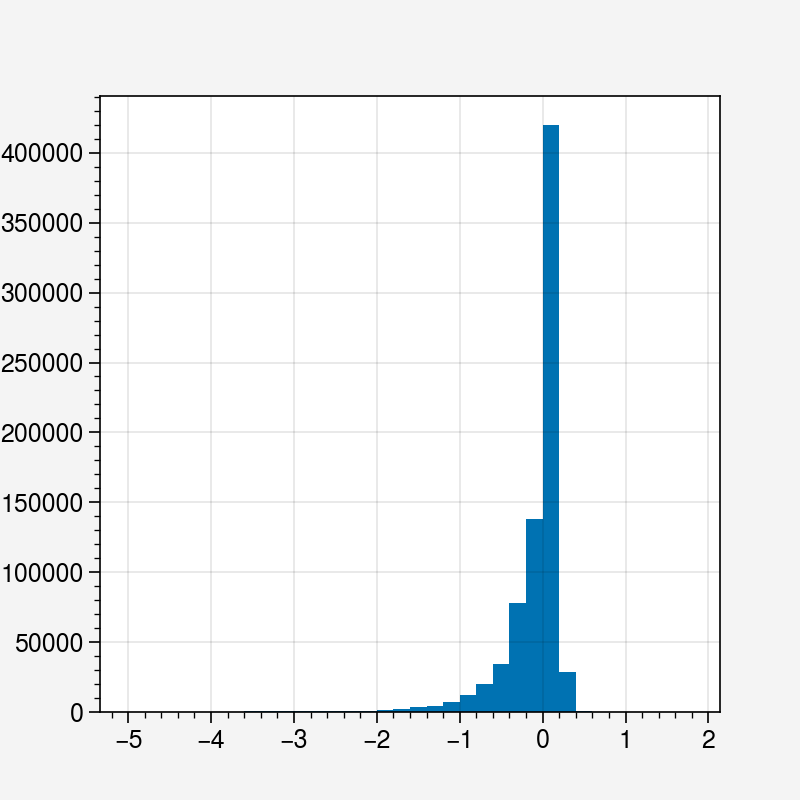

In [11]:
plt.hist(np.array(ds_diff).ravel(),bins=np.arange(-5,2,0.2))

(array([1.26000e+02, 1.33000e+02, 1.26000e+02, 1.35000e+02, 1.33000e+02,
        1.65000e+02, 1.39000e+02, 1.93000e+02, 2.04000e+02, 2.06000e+02,
        1.98000e+02, 1.92000e+02, 2.06000e+02, 2.41000e+02, 3.01000e+02,
        6.02000e+02, 1.28400e+03, 2.07600e+03, 2.93600e+03, 5.04300e+03,
        9.82200e+03, 1.68680e+04, 3.08500e+04, 7.54200e+04, 1.42559e+05,
        4.37759e+05, 2.87400e+04, 5.06000e+02, 4.00000e+00, 1.00000e+00,
        2.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00]),
 array([-5.0000000e+00, -4.8000000e+00, -4.6000000e+00, -4.4000000e+00,
        -4.2000000e+00, -4.0000000e+00, -3.8000000e+00, -3.6000000e+00,
        -3.4000000e+00, -3.2000000e+00, -3.0000000e+00, -2.8000000e+00,
        -2.6000000e+00, -2.4000000e+00, -2.2000000e+00, -2.0000000e+00,
        -1.8000000e+00, -1.6000000e+00, -1.4000000e+00, -1.2000000e+00,
        -1.0000000e+00, -8.0000000e-01, -6.0000000e-01, -4.0000000e-01,
        -2.0000000e-01,  4.4408921e-15,  2.0000000e-01,  4.0000000e-

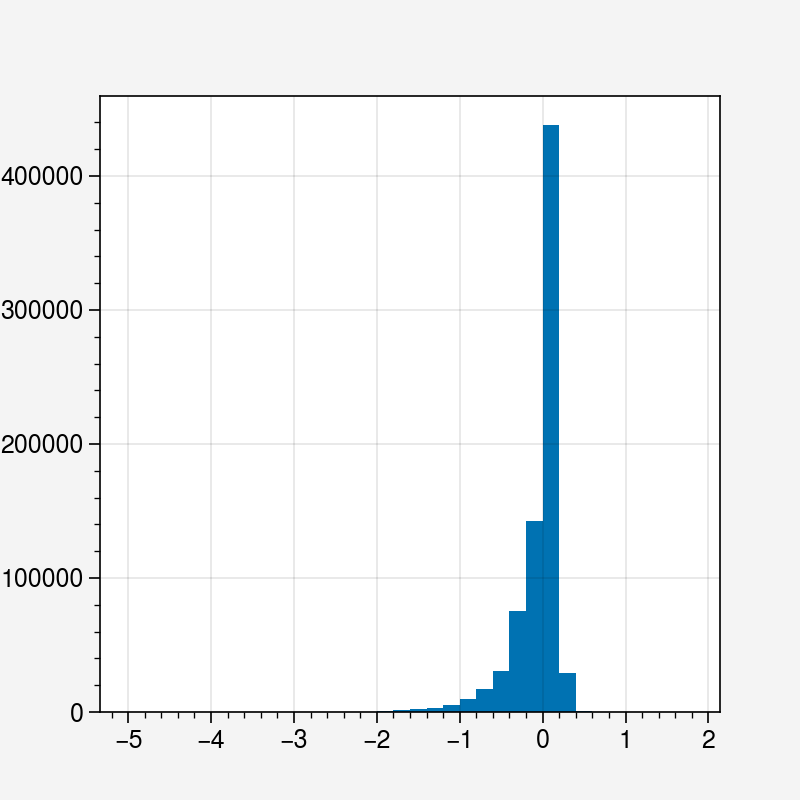

In [12]:
ds_diff2 = ds_ETSo_d + ds_melt - ds_surf_balance

plt.hist(np.array(ds_diff2).ravel(),bins=np.arange(-5,2,0.2))

In [13]:
print(np.array(ds_diff.mean()))
print(np.array(ds_diff2.mean()))

print(np.array(ds_diff.std()))
print(np.array(ds_diff2.std()))

print(np.array(ds_diff.median()))
print(np.array(ds_diff2.median()))

-0.12979091895281097
-0.08972723648098761
0.5793371471750791
0.5079584635549383
0.02341628074645996
0.027042388916015625


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


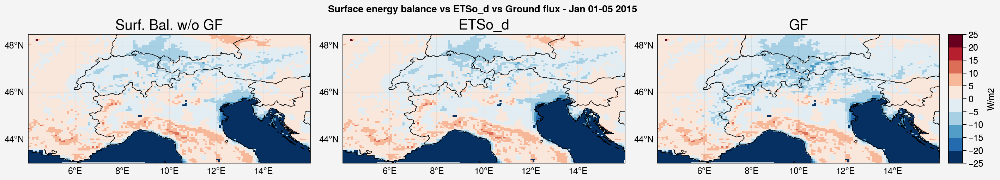

In [36]:
f, axs = pplt.subplots(proj='cyl',axwidth=4,ncols=3)

all_ds = [ds_surf_balance, ds_ETSo_d, ds_314_GF2]
names_var = ['Surf. Bal. w/o GF','ETSo_d','GF']

for i,var in enumerate(names_var):
    ax = axs[i]
    m = ax.pcolormesh(lon,lat,all_ds[i].mean(axis=0),cmap='RdBu_r',levels=np.linspace(-25,25,11))
    ax.format(titlesize='20px',title=var)

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="Surface energy balance vs ETSo_d vs Ground flux - Jan 01-05 2015 ")

In [19]:
ds_314_MB = xr.open_dataset('/bettik/castelli/MARout/EUd/d13/2015/ICE.d13.2015.01.01-05.nc').MB.max(axis=1)[:,jmin:jmax,imin:imax]


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


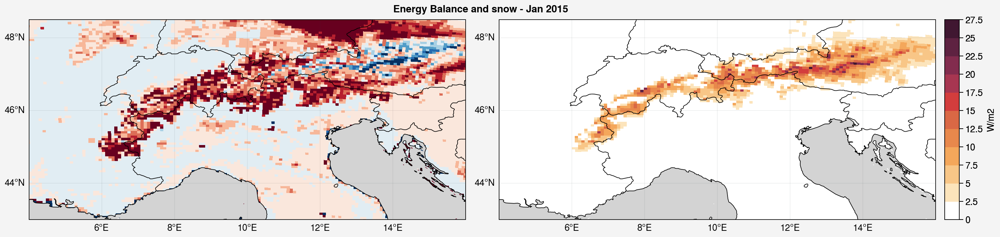

In [20]:
f, axs = pplt.subplots(proj='cyl',axwidth=6,ncols=2)

m = axs[0].pcolormesh(lon,lat,(ds_surf_balance-ds_314_GF2).mean(axis=0),levels=np.linspace(-5,5,11),cmap='RdBu_r')
m = axs[1].pcolormesh(lon,lat,ds_314_MB.mean(axis=0))#,levels=np.linspace(0,360,11))#,cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(ocean=True,oceancolor='lightgray',reso='hi')
axs.format(**normal_format,suptitle="Energy Balance and snow - Jan 2015 ")


#### d14

In [8]:
ds_314_GF2 = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc').GF2[:,jmin:jmax,imin:imax]
ds_314_HAcc = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc').HAcc[:,jmin:jmax,imin:imax]

ds_314_GF2

<xarray.DataArray 'GF2' (time: 60, y: 91, x: 139)>
[758940 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T01:00:00 ... 2015-01-05T23:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
Attributes:
    units:          W/m2
    long_name:      Ground Flux 2 (no heat capacity)
    standard_name:  Ground_Flux_2__no_heat_capacity_
    actual_range:   [-12835.655    2717.1147]

In [9]:
ds_SWU = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc')["SWU"][:,jmin:jmax,imin:imax]
ds_SWD = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc')["SWD"][:,jmin:jmax,imin:imax]
ds_NSW = ds_SWD - ds_SWU

ds_LWU = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc')["LWU"][:,jmin:jmax,imin:imax]
ds_LWD = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc')["LWD"][:,jmin:jmax,imin:imax]
ds_NLW = ds_LWD - ds_LWU

ds_SHF = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc')["SHF"][:,jmin:jmax,imin:imax]
ds_LHF = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc')["LHF"][:,jmin:jmax,imin:imax]

# Melt
Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
t_day = 86400 # 60*60*24 seconds in a day
ds_MBm = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc')["MBm"][:,:,jmin:jmax,imin:imax]
ds_MBm_top = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc')["MBmTop"][:,:,jmin:jmax,imin:imax]
ds_FRV = xr.open_dataset('/bettik/castelli/data/MAR-EC-Earth3/ICE.EC-Earth3.EUe.FRV.08.1975.nc').FRV[:,jmin:jmax,imin:imax]
FRV_sect1 = np.array(ds_FRV.sel(sector=1.0)/100)
FRV_sect2 = np.array(ds_FRV.sel(sector=2.0)/100)
FRV_sect3 = np.array(ds_FRV.sel(sector=3.0)/100)
melt_MBm = ds_MBm.sel(sector=1.0)*FRV_sect1 + ds_MBm.sel(sector=2.0)*FRV_sect2 + ds_MBm.sel(sector=3.0)*FRV_sect3
melt_MBm_top = ds_MBm_top.sel(sector=1.0)*FRV_sect1 + ds_MBm_top.sel(sector=2.0)*FRV_sect2 + ds_MBm_top.sel(sector=3.0)*FRV_sect3
ds_melt = melt_MBm * Lf / t_day
ds_melt_top = melt_MBm_top * Lf / t_day

ds_surf_balance = ds_NSW + ds_NLW + ds_SHF + ds_LHF - ds_melt_top - ds_314_GF2 + ds_314_HAcc

ds_ETSo_d = xr.open_dataset('/bettik/castelli/MARout/EUd/d13/2015/ICE.d13.2015.01.01-05.nc')["ETSo_d"][:,jmin:jmax,imin:imax]


In [10]:
ds_TTz = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc')["TTz"].isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_Tmax = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc')["TTmax"].isel(atmlay=0)[:,jmin:jmax,imin:imax]
ds_Tmin = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc')["TTmin"].isel(atmlay=0)[:,jmin:jmax,imin:imax]

ds_ST = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc')["ST"][:,jmin:jmax,imin:imax]

In [11]:
ds_surf_balance_noHAcc = ds_NSW + ds_NLW + ds_SHF + ds_LHF + ds_melt - ds_314_GF2
ds_surf_balance_HAcc2 = ds_NSW + ds_NLW + ds_SHF + ds_LHF + ds_melt - ds_314_GF2 - ds_314_HAcc


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


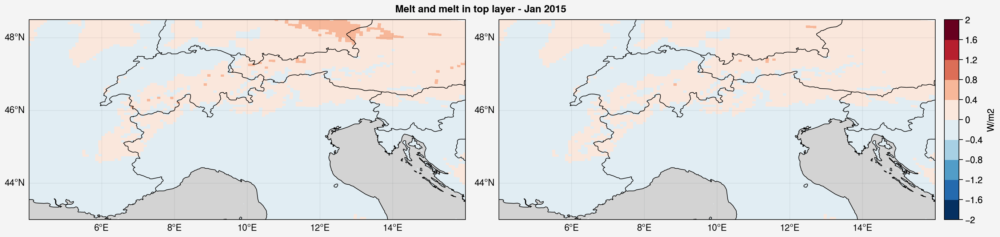

In [12]:
f, axs = pplt.subplots(proj='cyl',axwidth=6,ncols=2)

m = axs[0].pcolormesh(lon,lat,ds_melt.mean(axis=0),levels=np.linspace(-2,2,11),cmap='RdBu_r')
m = axs[1].pcolormesh(lon,lat,ds_melt_top.mean(axis=0),levels=np.linspace(-2,2,11),cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(ocean=True,oceancolor='lightgray',reso='hi')
axs.format(**normal_format,suptitle="Melt and melt in top layer - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

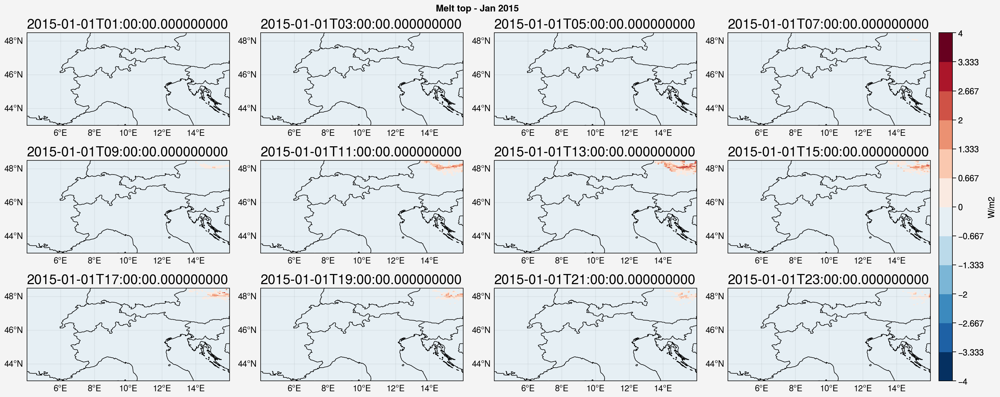

In [13]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for i in range(12):
    m = axs[i].pcolormesh(lon,lat,ds_melt_top[i],cmap='RdBu_r',levels=np.linspace(-4,4,13))
    axs[i].format(abcloc='l', titleloc='l', title=np.array(ds_314_GF2.time[i]))
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

#axs[:3].format(abcloc='l', titleloc='l', title=np.array(ds_314_GF2.time[:3]))
axs.format(**normal_format,suptitle="Melt top - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


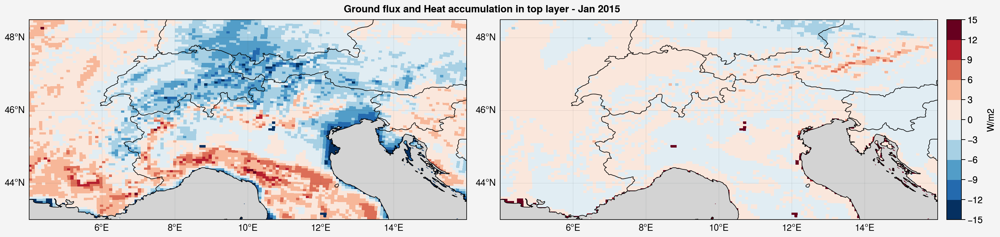

In [14]:
f, axs = pplt.subplots(proj='cyl',axwidth=6,ncols=2)

m = axs[0].pcolormesh(lon,lat,ds_314_GF2.mean(axis=0),levels=np.linspace(-15,15,11),cmap='RdBu_r')
m = axs[1].pcolormesh(lon,lat,ds_314_HAcc.mean(axis=0),levels=np.linspace(-15,15,11),cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')

axs.format(ocean=True,oceancolor='lightgray',reso='hi')
axs.format(**normal_format,suptitle="Ground flux and Heat accumulation in top layer - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

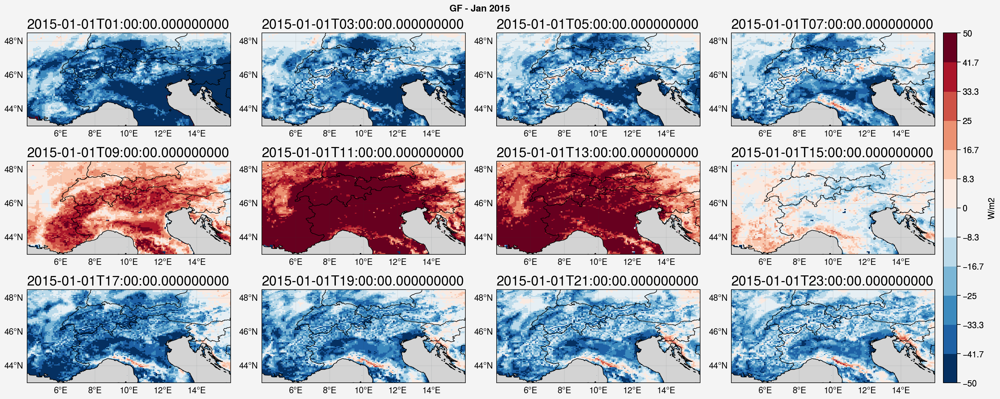

In [15]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for i in range(12):
    m = axs[i].pcolormesh(lon,lat,ds_314_GF2[i],cmap='RdBu_r',levels=np.linspace(-50,50,13))
    axs[i].format(abcloc='l', titleloc='l', title=np.array(ds_314_GF2.time[i]))
axs.format(titlesize='20px')

f.colorbar(m, label= 'W/m2')
axs.format(ocean=True,oceancolor='lightgray',reso='hi')

#axs[:3].format(abcloc='l', titleloc='l', title=np.array(ds_314_GF2.time[:3]))
axs.format(**normal_format,suptitle="GF - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

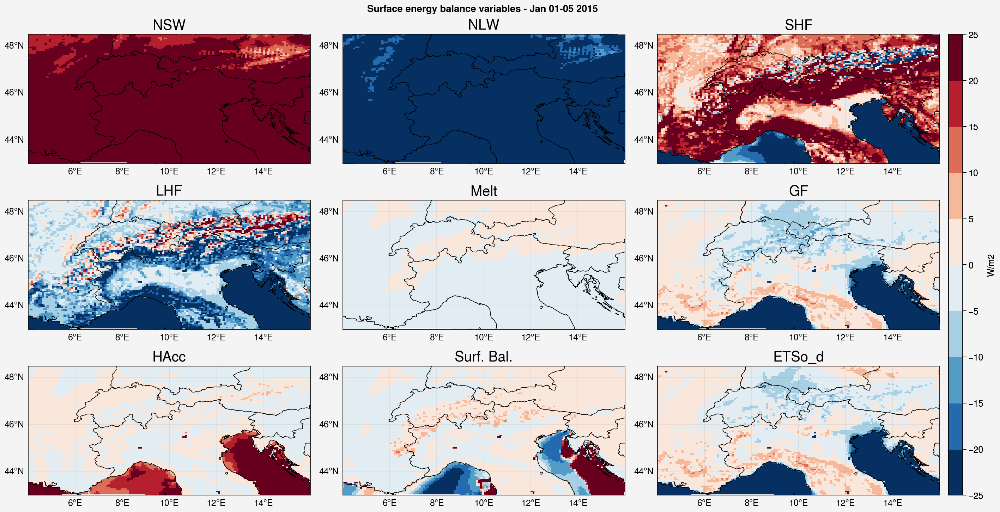

In [16]:
f, axs = pplt.subplots(proj='cyl',axwidth=4,ncols=3,nrows=3)

all_ds = [ds_NSW, ds_NLW, ds_SHF, ds_LHF, ds_melt, ds_314_GF2, ds_314_HAcc, ds_surf_balance, ds_ETSo_d]
names_var = ['NSW','NLW','SHF','LHF','Melt','GF','HAcc','Surf. Bal.','ETSo_d']

for i,var in enumerate(names_var):
    ax = axs[i]
    m = ax.pcolormesh(lon,lat,all_ds[i].mean(axis=0),cmap='RdBu_r',levels=np.linspace(-25,25,11))
    ax.format(titlesize='20px',title=var)

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle="Surface energy balance variables - Jan 01-05 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1604: UserWarning: No contour levels were found within the data range.
  result = super().contour(*args, **kwa

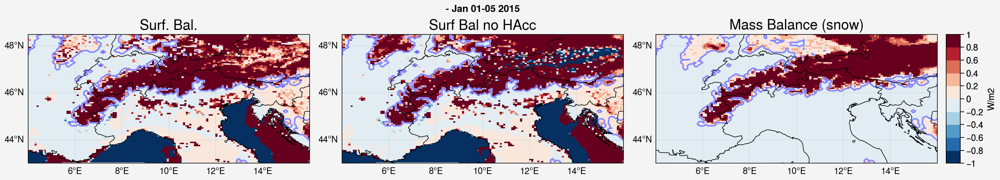

In [17]:
f, axs = pplt.subplots(proj='cyl',axwidth=4,ncols=3)

ds_314_MB = xr.open_dataset('/bettik/castelli/MARout/EUd/d14/2015/ICE.d14.2015.01.01-05.nc').MB.max(axis=1)[:,jmin:jmax,imin:imax]


all_ds = [ds_surf_balance, ds_surf_balance_noHAcc, ds_314_MB]
names_var = ['Surf. Bal.','Surf Bal no HAcc','Mass Balance (snow)']

for i,var in enumerate(names_var):
    ax = axs[i]
    m = ax.pcolormesh(lon,lat,all_ds[i].mean(axis=0),cmap='RdBu_r',levels=np.linspace(-1,1,11))
    ax.contour(lon, lat, ds_314_MB.mean(axis=0), levels=np.linspace(0,1,1),cmap='Blue')
    ax.format(titlesize='20px',title=var)

f.colorbar(m, label= 'W/m2')

axs.format(**normal_format,suptitle=" - Jan 01-05 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

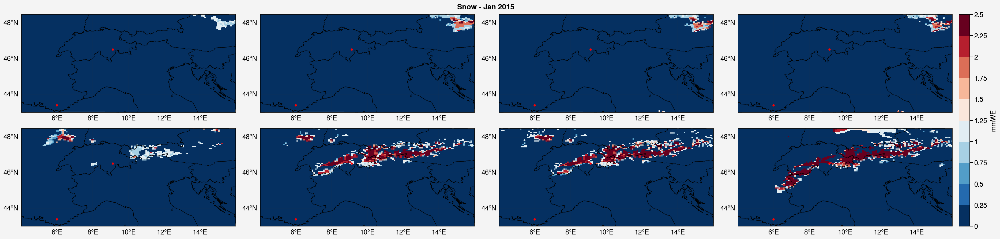

In [18]:
i1 = 75 # y
j1 = 90 # x

i2 = 25
j2 = 55

f, axs = pplt.subplots(proj='cyl',axwidth=4,ncols=4,nrows=2)

for t in range(8):
    m = axs[t].pcolormesh(lon,lat,ds_314_MB[4*t+3],levels=np.linspace(0,2.5,11),cmap='RdBu_r')
    axs[t].plot(ds.LON[i1,j1], ds.LAT[i1,j1],'ro',markersize=2)
    axs[t].plot(ds.LON[i2,j2], ds.LAT[i2,j2],'ro',markersize=2)

axs.format(titlesize='20px')

f.colorbar(m, label= 'mmWE')

axs.format(**normal_format,suptitle="Snow - Jan 2015 ")

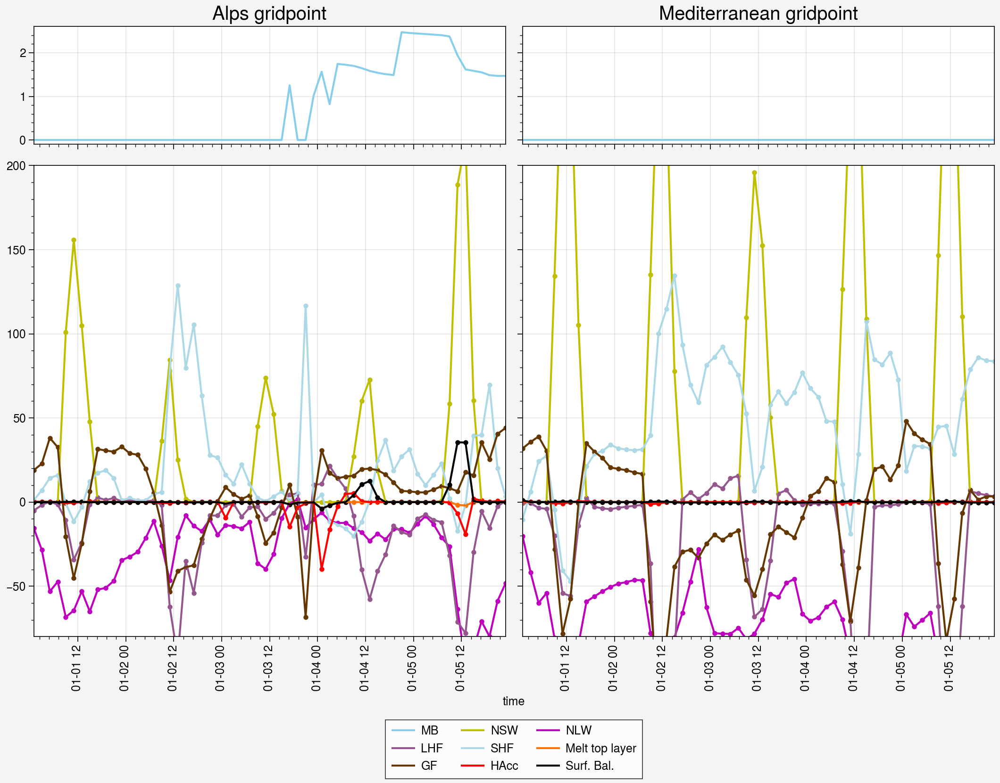

In [30]:
f, axs = pplt.subplots(axwidth=5,ncols=2,nrows=2,hratios=(1,4),ref=3)

all_ds = [ds_NSW, ds_NLW, ds_LHF, ds_SHF, -ds_melt, -ds_314_GF2, ds_314_HAcc, ds_surf_balance]
names_var = ['NSW','NLW','LHF','SHF','Melt top layer','GF','HAcc','Surf. Bal.']
colors = ['y','m','purple','lightblue','orange','brown','r','k']

for var in range(len(names_var)):
    ax=axs[2]
    ax.scatter(all_ds[var].time, np.array(all_ds[var])[:,i1,j1], c=colors[var], s=10)
    ax.plot(all_ds[var].time, np.array(all_ds[var])[:,i1,j1], c=colors[var])
    
    ax=axs[3]
    ax.scatter(all_ds[var].time, np.array(all_ds[var])[:,i2,j2], c=colors[var], s=10)
    ax.plot(all_ds[var].time, np.array(all_ds[var])[:,i2,j2], c=colors[var], label=names_var[var])

axs[2].set_ylim([-80,200])

ax0 = axs[0]
ax0.plot(all_ds[var].time, np.array(ds_314_MB)[:,i1,j1], c='skyblue')
ax0.set_ylim([-0.1,2.6])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[1]
ax0.plot(all_ds[var].time, np.array(ds_314_MB)[:,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-0.1,2.6])
axs[1].format(titlesize='20px',title='Mediterranean gridpoint')

f.legend(loc='b')#,prop = { "size": 14 },ncols=4)

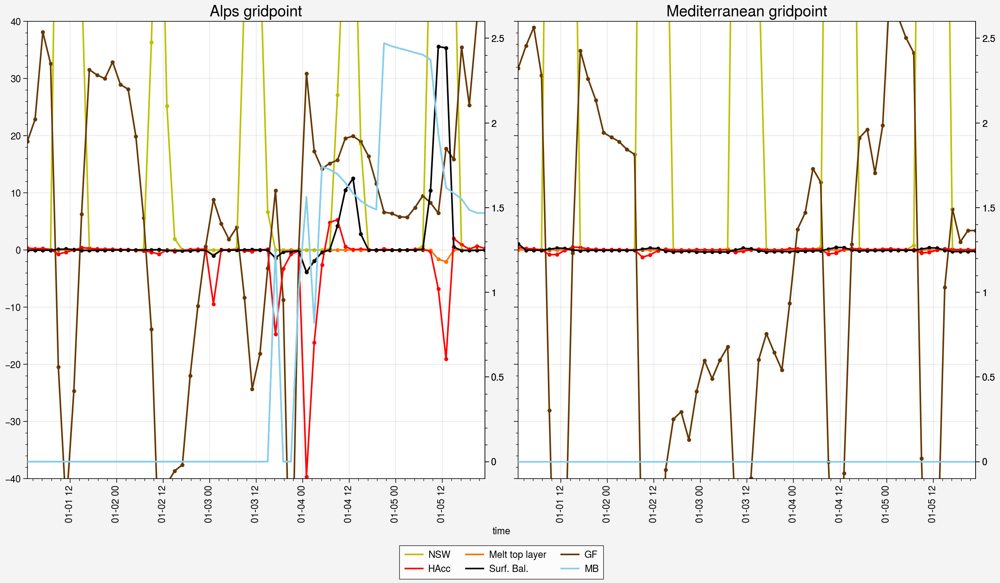

In [20]:
f, axs = pplt.subplots(axwidth=6,ncols=2)

all_ds = [ds_NSW, -ds_melt, -ds_314_GF2, ds_314_HAcc, ds_surf_balance]
names_var = ['NSW','Melt top layer','GF','HAcc','Surf. Bal.']
colors = ['y','orange','brown','r','k']

for var in range(len(names_var)):
    ax=axs[0]
    ax.scatter(all_ds[var].time, np.array(all_ds[var])[:,i1,j1], c=colors[var], s=10)
    ax.plot(all_ds[var].time, np.array(all_ds[var])[:,i1,j1], c=colors[var])

    
    ax=axs[1]
    ax.scatter(all_ds[var].time, np.array(all_ds[var])[:,i2,j2], c=colors[var], s=10)
    ax.plot(all_ds[var].time, np.array(all_ds[var])[:,i2,j2], c=colors[var], label=names_var[var])

axs[0].set_ylim([-40,40])
#axs[1].set_ylim([-1.5,1.5])

ax0 = axs[0].twinx()
ax0.plot(all_ds[var].time, np.array(ds_314_MB)[:,i1,j1], c='skyblue')
ax0.set_ylim([-0.1,2.6])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[1].twinx()
ax0.plot(all_ds[var].time, np.array(ds_314_MB)[:,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-0.1,2.6])
axs[1].format(titlesize='20px',title='Mediterranean gridpoint')

f.legend(loc='b')#,prop = { "size": 14 },ncols=4)

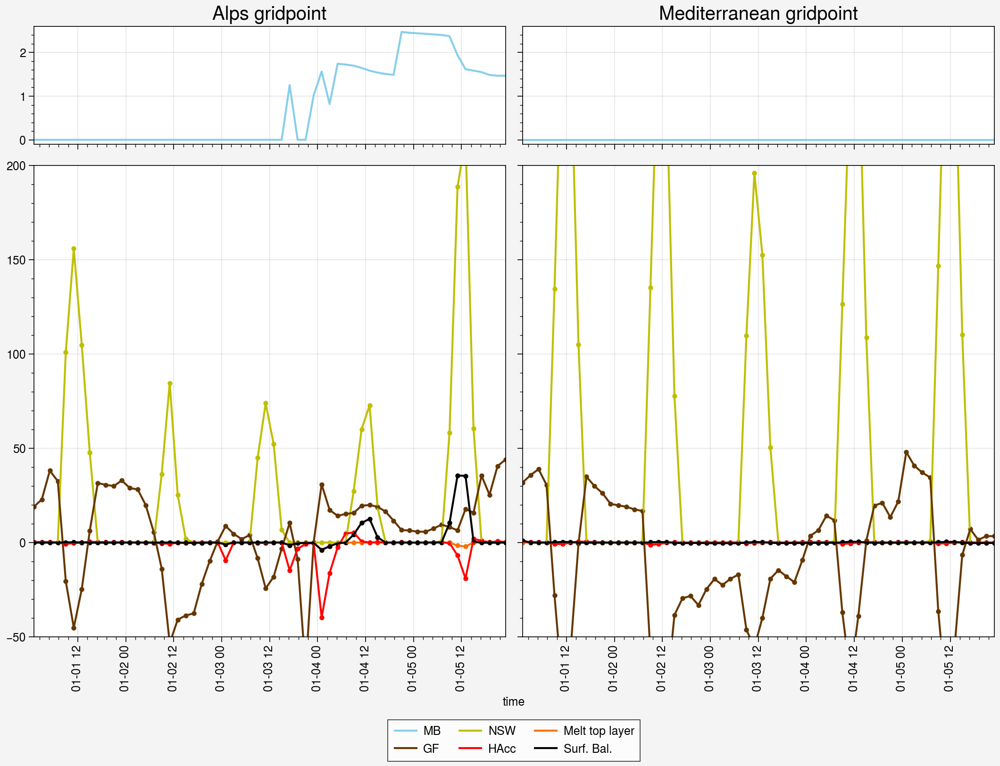

In [28]:
f, axs = pplt.subplots(axwidth=5,ncols=2,nrows=2,hratios=(1,4),ref=3)

all_ds = [ds_NSW, -ds_melt, -ds_314_GF2, ds_314_HAcc, ds_surf_balance]
names_var = ['NSW','Melt top layer','GF','HAcc','Surf. Bal.']
colors = ['y','orange','brown','r','k']

for var in range(len(names_var)):
    ax=axs[2]
    ax.scatter(all_ds[var].time, np.array(all_ds[var])[:,i1,j1], c=colors[var], s=10)
    ax.plot(all_ds[var].time, np.array(all_ds[var])[:,i1,j1], c=colors[var])

    
    ax=axs[3]
    ax.scatter(all_ds[var].time, np.array(all_ds[var])[:,i2,j2], c=colors[var], s=10)
    ax.plot(all_ds[var].time, np.array(all_ds[var])[:,i2,j2], c=colors[var], label=names_var[var])

axs[2].set_ylim([-50,200])
#axs[2].set_ylabel('W/m2')
#axs[2].set_ylim([-1.5,1.5])

ax0 = axs[0]
ax0.plot(all_ds[var].time, np.array(ds_314_MB)[:,i1,j1], c='skyblue')
ax0.set_ylim([-0.1,2.6])
axs[0].format(titlesize='20px',title='Alps gridpoint')
#ax0.set_ylabel('mmWe')

ax0 = axs[1]
ax0.plot(all_ds[var].time, np.array(ds_314_MB)[:,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-0.1,2.6])
axs[1].format(titlesize='20px',title='Mediterranean gridpoint')

f.legend(loc='b')#,prop = { "size": 14 },ncols=4)

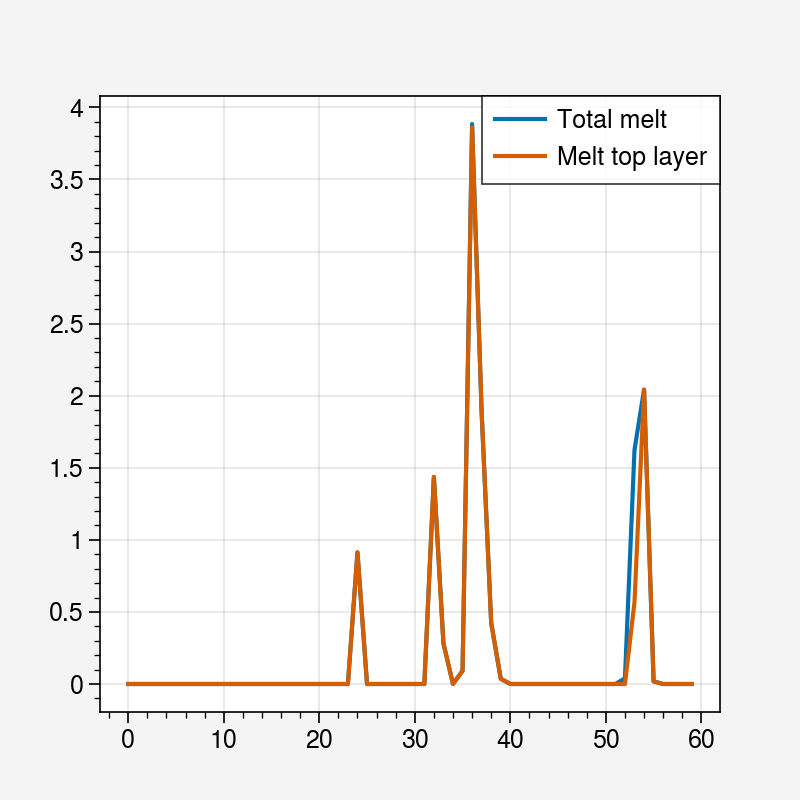

In [22]:
plt.plot(ds_melt[:,i1,j1],label='Total melt')
plt.plot(ds_melt_top[:,i1,j1],label='Melt top layer')
plt.legend()

In [32]:
def plot_E_balance_and_T(wp_meanseason_vars,slopes_var=None,trend=True,year=None,first_year=None,last_year=None,showlegend=True,snowlines=False):
    pplt.rc.update(small=14, large=12)

    n_levels=len(levels)
    n_seas=1
    seasons=['DJF']#,'MAM','JJA','SON']
    colors = ['b','g','r','c','y','m','purple','lightblue','orange','k']
    leg_labels_null = ['','','','','','','','','','']
    leg_labels_full = ['Tmean','Tmin','Tmax','STmean','NSW','NLW','LHF','SHF','Melt','NSW+NLW+LHF+SHF+Melt']
    leg_labels = [leg_labels_full,leg_labels_null,leg_labels_null,leg_labels_null]


    with pplt.rc.context({'suptitle.weight': 'normal', 'suptitle.size': 14}):
        f, axs = pplt.subplots(ncols=n_seas,axwidth=3)
    axs2 = axs.twiny()
    
    mean_slope_T=np.full((n_seas,n_levels),np.nan)
    mean_slope_Tmin=np.full((n_seas,n_levels),np.nan)
    mean_slope_Tmax=np.full((n_seas,n_levels),np.nan)
    mean_slope_ST=np.full((n_seas,n_levels),np.nan)
    mean_slope_NSW=np.full((n_seas,n_levels),np.nan)
    mean_slope_NLW=np.full((n_seas,n_levels),np.nan)
    mean_slope_LHF=np.full((n_seas,n_levels),np.nan)
    mean_slope_SHF=np.full((n_seas,n_levels),np.nan)
    mean_slope_MBm=np.full((n_seas,n_levels),np.nan)
    mean_slope_energy_balance=np.full((n_seas,n_levels),np.nan)
    mean_slopes = [mean_slope_T,mean_slope_Tmin,mean_slope_Tmax,mean_slope_ST,mean_slope_NSW,mean_slope_NLW,mean_slope_LHF,mean_slope_SHF,mean_slope_MBm,
                   mean_slope_energy_balance]

    std_slope_T=np.full((n_seas,n_levels),np.nan)
    std_slope_Tmin=np.full((n_seas,n_levels),np.nan)
    std_slope_Tmax=np.full((n_seas,n_levels),np.nan)
    std_slope_ST=np.full((n_seas,n_levels),np.nan)
    std_slope_NSW=np.full((n_seas,n_levels),np.nan)
    std_slope_NLW=np.full((n_seas,n_levels),np.nan)
    std_slope_LHF=np.full((n_seas,n_levels),np.nan)
    std_slope_SHF=np.full((n_seas,n_levels),np.nan)
    std_slope_MBm=np.full((n_seas,n_levels),np.nan)
    std_slope_energy_balance=np.full((n_seas,n_levels),np.nan)
    std_slopes = [std_slope_T,std_slope_Tmin,std_slope_Tmax,std_slope_ST,std_slope_NSW,std_slope_NLW,std_slope_LHF,std_slope_SHF,std_slope_MBm,
                  std_slope_energy_balance]

    
    for i in range(n_seas): # seasons
        ax = axs[i]
        ax2 = axs2[i]
        
        for j in range(n_levels): # levels
            for var in range(len(wp_meanseason_vars)):
                if trend:
                    slope_var = np.ma.masked_array(slopes_var[var], mask=np.invert(levels[j])).reshape(12649)
                    multiplier = 10 # trends per decade so we x10
                elif first_year != None: # not a trend, but averaging over first_year:last_year
                    slope_var = np.ma.masked_array(wp_meanseason_vars[var][first_year:last_year].mean(axis=0), mask=np.invert(levels[j])).reshape(12649)
                    multiplier = 1
                else: # taking one year in particular
                    slope_var = np.ma.masked_array(wp_meanseason_vars[var][year-1961], mask=np.invert(levels[j])).reshape(12649)
                    multiplier = 1
                
                mean_slopes[var][i,j] = multiplier*slope_var.mean()
                std_slopes[var][i,j] = multiplier*slope_var.std()
                if var<4:
                    ax.plot([multiplier*slope_var.mean()-multiplier*slope_var.std(),multiplier*slope_var.mean()+multiplier*slope_var.std()],[H_levels[j],H_levels[j]],c=colors[var])
                else:
                    ax2.plot([multiplier*slope_var.mean()-multiplier*slope_var.std(),multiplier*slope_var.mean()+multiplier*slope_var.std()],[H_levels[j],H_levels[j]],c=colors[var])


        ax.plot(mean_slope_T[i,:],H_levels,c='b',linestyle='--',label=leg_labels[i][0])
        ax.plot(mean_slope_Tmin[i,:],H_levels,c='g',linestyle='--',label=leg_labels[i][1])
        ax.plot(mean_slope_Tmax[i,:],H_levels,c='r',linestyle='--',label=leg_labels[i][2])
        ax.plot(mean_slope_ST[i,:],H_levels,c='c',linestyle='--',label=leg_labels[i][3])

        if trend:
            ax.set_xlim(-0.5,1.3)
            ax.text(1., 75, seasons[i], fontsize=13,fontweight='semibold')
        else:
            ax.set_xlim(-55.,10)
            ax.text(20, 75, seasons[i], fontsize=13,fontweight='semibold')

        ax.set_ylim(0,3400)
        
        if snowlines:
            #ax.hlines(mean1_snowline_seas[0][0,first_year:last_year,i].mean(),-55,35,c='deepskyblue',linestyle='--')
            #ax.hlines(mean1_snowline_seas[1][0,first_year:last_year,i].mean(),-55,35,c='deepskyblue',linestyle='--')
            #ax.hlines(mean1_snowline_seas[2][0,first_year:last_year,i].mean(),-55,35,c='deepskyblue',linestyle='--')
            ax.hlines(mean10_snowline_seas[0][0,first_year:last_year,i].mean(),-55,35,c='deepskyblue')
            ax.hlines(mean10_snowline_seas[1][0,first_year:last_year,i].mean(),-55,35,c='deepskyblue')
            ax.hlines(mean10_snowline_seas[2][0,first_year:last_year,i].mean(),-55,35,c='deepskyblue')
        
        ax2.vlines(0,0,3500,c='k',linestyle=':',alpha=0.4)
        ax2.plot(mean_slope_NSW[i,:],H_levels,c='y',label=leg_labels[i][4])
        ax2.plot(mean_slope_NLW[i,:],H_levels,c='m',label=leg_labels[i][5])
        ax2.plot(mean_slope_LHF[i,:],H_levels,c='purple',label=leg_labels[i][6])
        ax2.plot(mean_slope_SHF[i,:],H_levels,c='lightblue',label=leg_labels[i][7])
        ax2.plot(mean_slope_MBm[i,:],H_levels,c='orange',label=leg_labels[i][8])
        ax2.plot(mean_slope_energy_balance[i,:],H_levels,c='k',label=leg_labels[i][9])
        #ax2.plot(mean_slope_NSW[i,:]+mean_slope_NLW[i,:]+mean_slope_LHF[i,:]+mean_slope_SHF[i,:],H_levels,c='k',linestyle='--')

        if trend:
            ax2.set_xlim(-6,15)
        else:
            ax2.set_xlim(-80,260)
        

    if showlegend:
        f.legend(loc='b',prop = { "size": 14 },ncols=4)
    
    if trend:
        xLabel = 'T trend (°C/decade)'
        Suptitle='Surface energy flux trend (W/$m^2$/dec)'
    else:
        xLabel = 'T (°C)'
        Suptitle='Surface energy flux (W/$m^2$)'

    if year != None:
        axs[0].text(x=10,y=3000,s=f'Year = {year}')
    axs.format(xlabel=xLabel,ylabel='Altitude (m.a.s.l.)',suptitle=Suptitle)


In [33]:
# Levels (altitude bands)

levels = [np.logical_and(alps,H<400), np.logical_and(alps,np.logical_and(H>=400,H<600)), np.logical_and(alps,np.logical_and(H>=600,H<800)),
          np.logical_and(alps,np.logical_and(H>=800,H<1000)), np.logical_and(alps,np.logical_and(H>=1000,H<1200)), np.logical_and(alps,np.logical_and(H>=1200,H<1400)),
          np.logical_and(alps,np.logical_and(H>=1400,H<1600)), np.logical_and(alps,np.logical_and(H>=1600,H<1800)), np.logical_and(alps,np.logical_and(H>=1800,H<2000)),
          np.logical_and(alps,np.logical_and(H>=2000,H<2200)), np.logical_and(alps,np.logical_and(H>=2200,H<2400)), np.logical_and(alps,np.logical_and(H>=2400,H<2600)),
          np.logical_and(alps,np.logical_and(H>=2600,H<2800)), np.logical_and(alps,np.logical_and(H>=2800,H<3000)),
          np.logical_and(alps,H>=3000)]#,
          #alps]

H_levels = [300,500,700,900,1100,1300,1500,1700,1900,2100,2300,2500,2700,2900,3100]

In [49]:
def plot_E_balance(wp_meanseason_vars,first=None,last=None,showlegend=True):
    colors = ['y','m','purple','lightblue','orange','brown','r','k']
    n_levels=len(levels)
    leg_labels = ['NSW','NLW','LHF','SHF','Melt','GF','HAcc','Surf Bal']
    
    with pplt.rc.context({'suptitle.weight': 'normal', 'suptitle.size': 14}):
        f, axs = pplt.subplots(axwidth=5)
    
    mean_slope_NSW=np.full((n_levels),np.nan)
    mean_slope_NLW=np.full((n_levels),np.nan)
    mean_slope_LHF=np.full((n_levels),np.nan)
    mean_slope_SHF=np.full((n_levels),np.nan)
    mean_slope_MBm=np.full((n_levels),np.nan)
    mean_slope_GF=np.full((n_levels),np.nan)
    mean_slope_HAcc=np.full((n_levels),np.nan)
    mean_slope_energy_balance=np.full((n_levels),np.nan)
    mean_slopes = [mean_slope_NSW,mean_slope_NLW,mean_slope_LHF,mean_slope_SHF,mean_slope_MBm,mean_slope_GF,mean_slope_HAcc,mean_slope_energy_balance]

    std_slope_NSW=np.full((n_levels),np.nan)
    std_slope_NLW=np.full((n_levels),np.nan)
    std_slope_LHF=np.full((n_levels),np.nan)
    std_slope_SHF=np.full((n_levels),np.nan)
    std_slope_MBm=np.full((n_levels),np.nan)
    std_slope_GF=np.full((n_levels),np.nan)
    std_slope_HAcc=np.full((n_levels),np.nan)
    std_slope_energy_balance=np.full((n_levels),np.nan)
    std_slopes = [std_slope_NSW,std_slope_NLW,std_slope_LHF,std_slope_SHF,std_slope_MBm,std_slope_GF,std_slope_HAcc,std_slope_energy_balance]

    for j in range(n_levels): # levels
        for var in range(len(wp_meanseason_vars)):
            slope_var = np.ma.masked_array(wp_meanseason_vars[var][first:last].mean(axis=0), mask=np.invert(levels[j])).reshape(12649)
            multiplier = 1
                
            mean_slopes[var][j] = multiplier*slope_var.mean()
            std_slopes[var][j] = multiplier*slope_var.std()

            axs.plot([multiplier*slope_var.mean()-multiplier*slope_var.std(),multiplier*slope_var.mean()+multiplier*slope_var.std()],[H_levels[j],H_levels[j]],c=colors[var])

    axs.set_xlim(-10.,10)
    axs.set_ylim(0,3400)
        
    axs.vlines(0,0,3500,c='k',linestyle=':',alpha=0.4)
    axs.plot(mean_slope_NSW,H_levels,c='y',label=leg_labels[0])
    axs.plot(mean_slope_NLW,H_levels,c='m',label=leg_labels[1])
    axs.plot(mean_slope_LHF,H_levels,c='purple',label=leg_labels[2])
    axs.plot(mean_slope_SHF,H_levels,c='lightblue',label=leg_labels[3])
    axs.plot(mean_slope_MBm,H_levels,c='orange',label=leg_labels[4])
    axs.plot(mean_slope_GF,H_levels,c='brown',label=leg_labels[5])
    axs.plot(mean_slope_HAcc,H_levels,c='red',label=leg_labels[6])
    axs.plot(mean_slope_energy_balance,H_levels,c='k',label=leg_labels[7])
    #ax2.plot(mean_slope_NSW[i,:]+mean_slope_NLW[i,:]+mean_slope_LHF[i,:]+mean_slope_SHF[i,:],H_levels,c='k',linestyle='--')        

    if showlegend:
        f.legend(loc='b',prop = { "size": 12 },ncols=4)
    
    xLabel = 'Surface energy flux (W/$m^2$)'

    axs.format(xlabel=xLabel,ylabel='Altitude (m.a.s.l.)',xreverse=False)
    

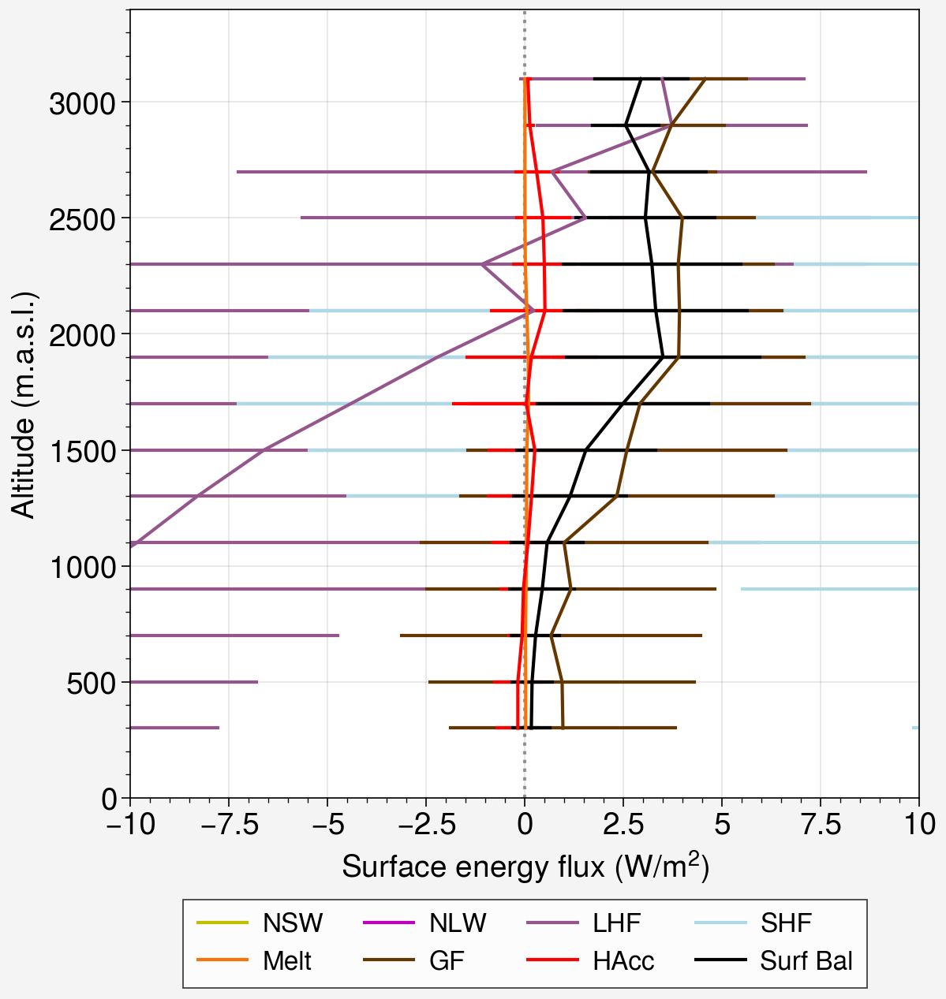

In [50]:
wp_meanseason_vars = [ds_NSW,ds_NLW,ds_LHF,ds_SHF,ds_melt_top,-ds_314_GF2, ds_314_HAcc,ds_surf_balance]

plot_E_balance(wp_meanseason_vars,first=0,last=-1)

#### e01

In [9]:
ds_GF_Jan = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.01.01-31.nc').GF2[:,jmin:jmax,imin:imax]
ds_HAcc_Jan = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.01.01-31.nc').HAcc[:,jmin:jmax,imin:imax]
ds_SWU_Jan = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.01.01-31.nc')["SWU"][:,jmin:jmax,imin:imax]
ds_SWD_Jan = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.01.01-31.nc')["SWD"][:,jmin:jmax,imin:imax]
ds_NSW_Jan = ds_SWD_Jan - ds_SWU_Jan

ds_LWU_Jan = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.01.01-31.nc')["LWU"][:,jmin:jmax,imin:imax]
ds_LWD_Jan = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.01.01-31.nc')["LWD"][:,jmin:jmax,imin:imax]
ds_NLW_Jan = ds_LWD_Jan - ds_LWU_Jan

ds_SHF_Jan = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.01.01-31.nc')["SHF"][:,jmin:jmax,imin:imax]
ds_LHF_Jan = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.01.01-31.nc')["LHF"][:,jmin:jmax,imin:imax]

# Melt
Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
t_day = 86400 # 60*60*24 seconds in a day
ds_MBm = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.01.01-31.nc')["MBm"][:,:,jmin:jmax,imin:imax]
ds_MBm_top = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.01.01-31.nc')["MBmTop"][:,:,jmin:jmax,imin:imax]
ds_FRV = xr.open_dataset('/bettik/castelli/data/MAR-EC-Earth3/ICE.EC-Earth3.EUe.FRV.08.1975.nc').FRV[:,jmin:jmax,imin:imax]
FRV_sect1 = np.array(ds_FRV.sel(sector=1.0)/100)
FRV_sect2 = np.array(ds_FRV.sel(sector=2.0)/100)
FRV_sect3 = np.array(ds_FRV.sel(sector=3.0)/100)
melt_MBm = ds_MBm.sel(sector=1.0)*FRV_sect1 + ds_MBm.sel(sector=2.0)*FRV_sect2 + ds_MBm.sel(sector=3.0)*FRV_sect3
melt_MBm_top = ds_MBm_top.sel(sector=1.0)*FRV_sect1 + ds_MBm_top.sel(sector=2.0)*FRV_sect2 + ds_MBm_top.sel(sector=3.0)*FRV_sect3
ds_melt_Jan = melt_MBm * Lf / t_day
ds_melt_top_Jan = melt_MBm_top * Lf / t_day

ds_surf_balance_Jan = ds_NSW_Jan + ds_NLW_Jan + ds_SHF_Jan + ds_LHF_Jan - ds_melt_top_Jan + ds_GF_Jan + ds_HAcc_Jan

ds_ETSo_d_Jan = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.01.01-31.nc')["ETSo_d"][:,jmin:jmax,imin:imax]

ds_MB_Jan = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.01.01-31.nc').MB.max(axis=1)[:,jmin:jmax,imin:imax]


In [10]:
ds_GF_Jul = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.07.01-31.nc').GF2[:,jmin:jmax,imin:imax]
ds_HAcc_Jul = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.07.01-31.nc').HAcc[:,jmin:jmax,imin:imax]
ds_SWU_Jul = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.07.01-31.nc')["SWU"][:,jmin:jmax,imin:imax]
ds_SWD_Jul = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.07.01-31.nc')["SWD"][:,jmin:jmax,imin:imax]
ds_NSW_Jul = ds_SWD_Jul - ds_SWU_Jul

ds_LWU_Jul = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.07.01-31.nc')["LWU"][:,jmin:jmax,imin:imax]
ds_LWD_Jul = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.07.01-31.nc')["LWD"][:,jmin:jmax,imin:imax]
ds_NLW_Jul = ds_LWD_Jul - ds_LWU_Jul

ds_SHF_Jul = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.07.01-31.nc')["SHF"][:,jmin:jmax,imin:imax]
ds_LHF_Jul = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.07.01-31.nc')["LHF"][:,jmin:jmax,imin:imax]

# Melt
Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
t_day = 86400 # 60*60*24 seconds in a day
ds_MBm = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.07.01-31.nc')["MBm"][:,:,jmin:jmax,imin:imax]
ds_MBm_top = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.07.01-31.nc')["MBmTop"][:,:,jmin:jmax,imin:imax]
ds_FRV = xr.open_dataset('/bettik/castelli/data/MAR-EC-Earth3/ICE.EC-Earth3.EUe.FRV.08.1975.nc').FRV[:,jmin:jmax,imin:imax]
FRV_sect1 = np.array(ds_FRV.sel(sector=1.0)/100)
FRV_sect2 = np.array(ds_FRV.sel(sector=2.0)/100)
FRV_sect3 = np.array(ds_FRV.sel(sector=3.0)/100)
melt_MBm = ds_MBm.sel(sector=1.0)*FRV_sect1 + ds_MBm.sel(sector=2.0)*FRV_sect2 + ds_MBm.sel(sector=3.0)*FRV_sect3
melt_MBm_top = ds_MBm_top.sel(sector=1.0)*FRV_sect1 + ds_MBm_top.sel(sector=2.0)*FRV_sect2 + ds_MBm_top.sel(sector=3.0)*FRV_sect3
ds_melt_Jul = melt_MBm * Lf / t_day
ds_melt_top_Jul = melt_MBm_top * Lf / t_day

ds_surf_balance_Jul = ds_NSW_Jul + ds_NLW_Jul + ds_SHF_Jul + ds_LHF_Jul - ds_melt_top_Jul + ds_GF_Jul + ds_HAcc_Jul

ds_ETSo_d_Jul = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.07.01-31.nc')["ETSo_d"][:,jmin:jmax,imin:imax]

ds_MB_Jul = xr.open_dataset('/bettik/castelli/MARout/EUe/e01/2015/ICE.e01.2015.07.01-31.nc').MB.max(axis=1)[:,jmin:jmax,imin:imax]

In [11]:
i1 = 75 # y
j1 = 90 # x

i2 = 25
j2 = 55

/tmp/ipykernel_1370913/3708856017.py:2: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1370913/3708856017.py:2: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


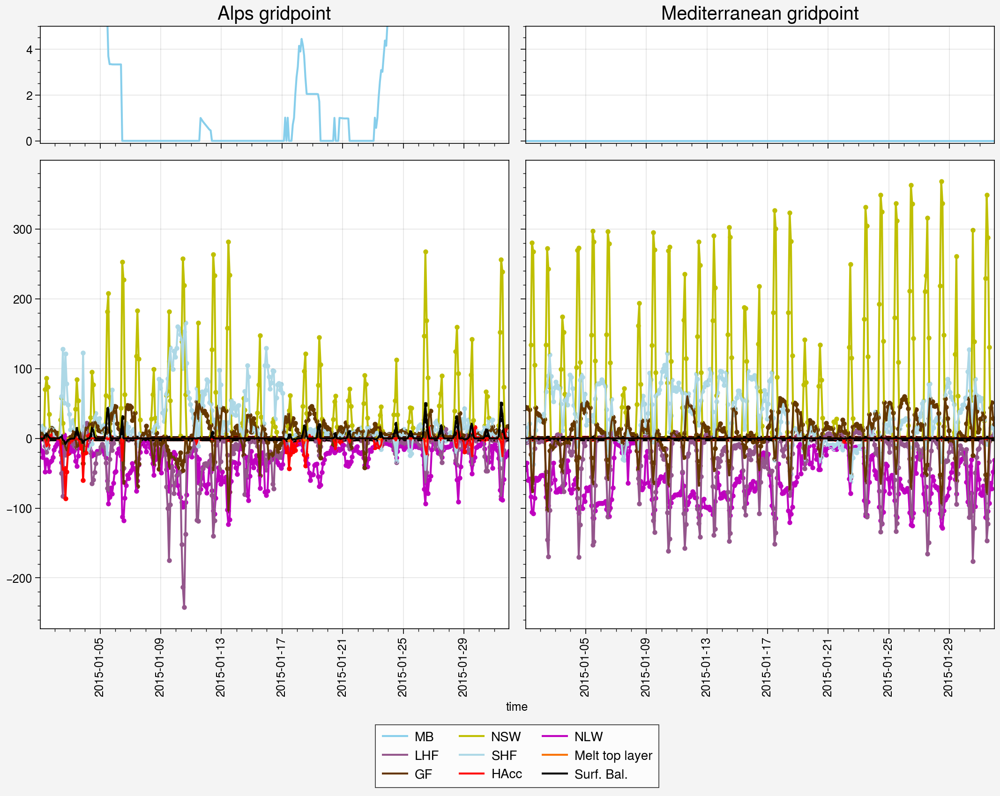

In [12]:
f, axs = pplt.subplots(axwidth=5,ncols=2,nrows=2,hratios=(1,4),ref=3)
pplt.rc.update(small=10, large=12)


all_ds = [ds_NSW_Jan, ds_NLW_Jan, ds_LHF_Jan, ds_SHF_Jan, -ds_melt_top_Jan, ds_GF_Jan, ds_HAcc_Jan, ds_surf_balance_Jan]
names_var = ['NSW','NLW','LHF','SHF','Melt top layer','GF','HAcc','Surf. Bal.']
colors = ['y','m','purple','lightblue','orange','brown','r','k']

for var in range(len(names_var)):
    ax=axs[2]
    ax.scatter(all_ds[var].time, np.array(all_ds[var])[:,i1,j1], c=colors[var], s=10)
    ax.plot(all_ds[var].time, np.array(all_ds[var])[:,i1,j1], c=colors[var])
    
    ax=axs[3]
    ax.scatter(all_ds[var].time, np.array(all_ds[var])[:,i2,j2], c=colors[var], s=10)
    ax.plot(all_ds[var].time, np.array(all_ds[var])[:,i2,j2], c=colors[var], label=names_var[var])


ax0 = axs[0]
ax0.plot(all_ds[var].time, np.array(ds_MB_Jan)[:,i1,j1], c='skyblue')
ax0.set_ylim([-0.1,5])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[1]
ax0.plot(all_ds[var].time, np.array(ds_MB_Jan)[:,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-0.1,5])
axs[1].format(titlesize='20px',title='Mediterranean gridpoint')

f.legend(loc='b')#,prop = { "size": 14 },ncols=4)

/tmp/ipykernel_1370913/3328562566.py:2: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1370913/3328562566.py:2: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


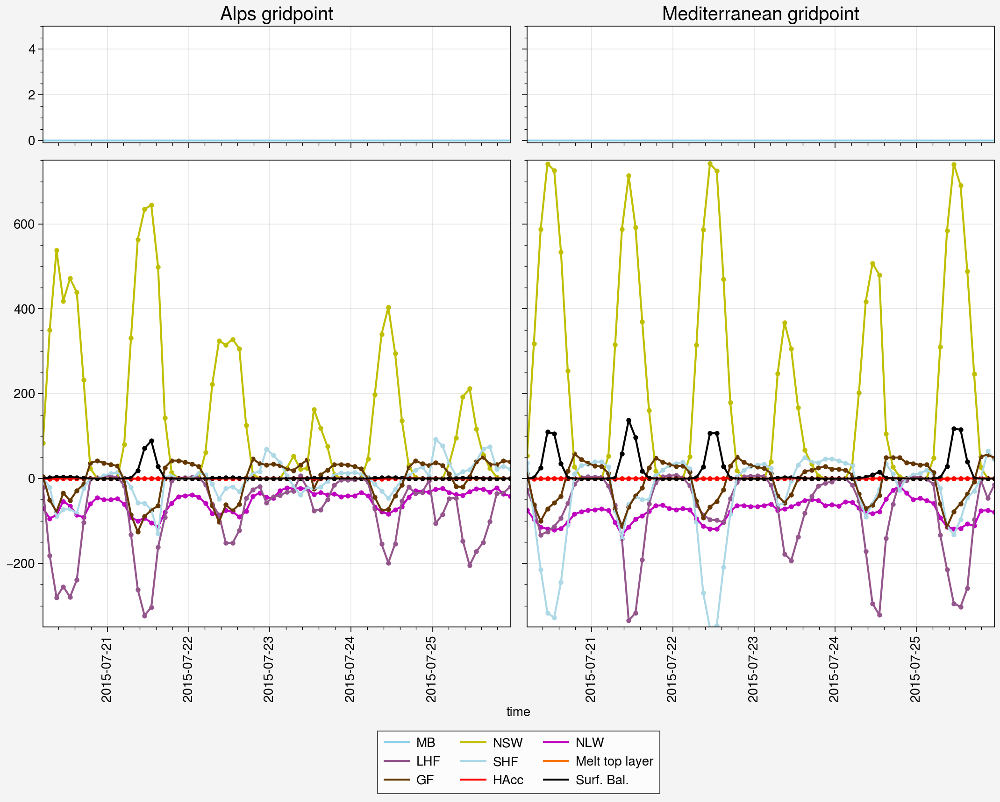

In [21]:
f, axs = pplt.subplots(axwidth=5,ncols=2,nrows=2,hratios=(1,4),ref=3)
pplt.rc.update(small=10, large=12)

first=230
last=300

all_ds = [ds_NSW_Jul, ds_NLW_Jul, ds_LHF_Jul, ds_SHF_Jul, -ds_melt_top_Jul, ds_GF_Jul, ds_HAcc_Jul, ds_surf_balance_Jul]
names_var = ['NSW','NLW','LHF','SHF','Melt top layer','GF','HAcc','Surf. Bal.']
colors = ['y','m','purple','lightblue','orange','brown','r','k']

for var in range(len(names_var)):
    ax=axs[2]
    ax.scatter(all_ds[var].time[first:last], np.array(all_ds[var])[first:last,i1,j1], c=colors[var], s=10)
    ax.plot(all_ds[var].time[first:last], np.array(all_ds[var])[first:last,i1,j1], c=colors[var])
    
    ax=axs[3]
    ax.scatter(all_ds[var].time[first:last], np.array(all_ds[var])[first:last,i2,j2], c=colors[var], s=10)
    ax.plot(all_ds[var].time[first:last], np.array(all_ds[var])[first:last,i2,j2], c=colors[var], label=names_var[var])

ax.set_ylim([-350,750])

ax0 = axs[0]
ax0.plot(all_ds[var].time[first:last], np.array(ds_MB_Jul)[first:last,i1,j1], c='skyblue')
ax0.set_ylim([-0.1,5])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[1]
ax0.plot(all_ds[var].time[first:last], np.array(ds_MB_Jul)[first:last,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-0.1,5])
axs[1].format(titlesize='20px',title='Mediterranean gridpoint')

f.legend(loc='b')#,prop = { "size": 14 },ncols=4)

/tmp/ipykernel_1370913/1490376619.py:2: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1370913/1490376619.py:2: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


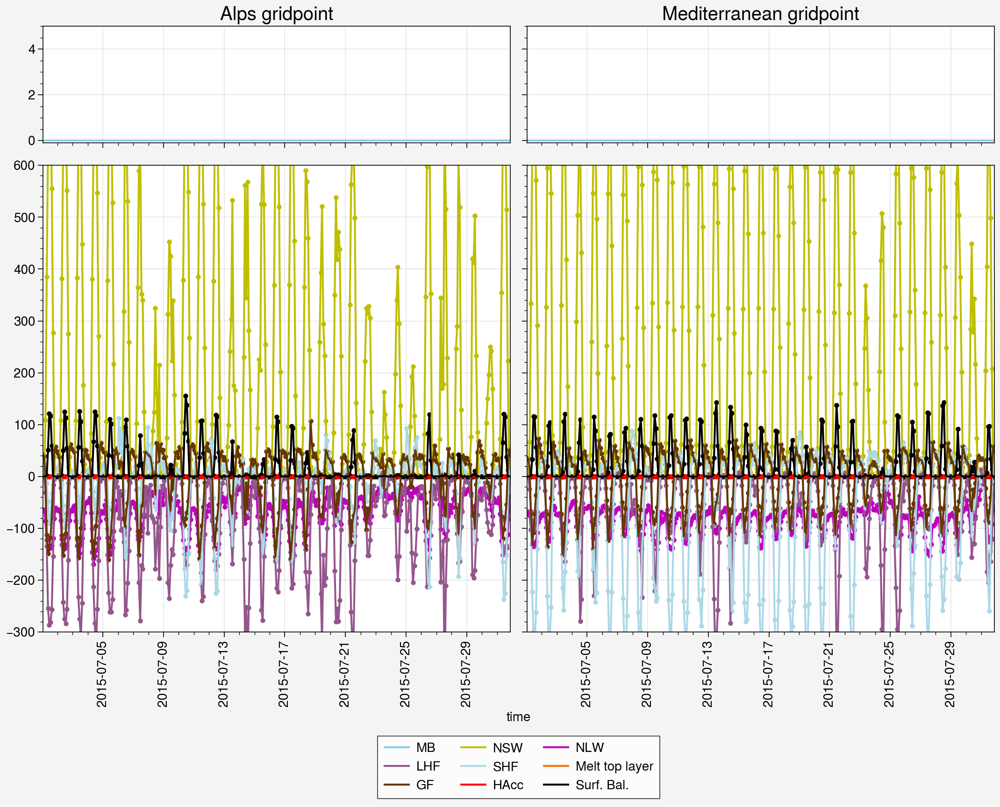

In [20]:
f, axs = pplt.subplots(axwidth=5,ncols=2,nrows=2,hratios=(1,4),ref=3)
pplt.rc.update(small=10, large=12)

first=0
last=-1

all_ds = [ds_NSW_Jul, ds_NLW_Jul, ds_LHF_Jul, ds_SHF_Jul, -ds_melt_top_Jul, ds_GF_Jul, ds_HAcc_Jul, ds_surf_balance_Jul]
names_var = ['NSW','NLW','LHF','SHF','Melt top layer','GF','HAcc','Surf. Bal.']
colors = ['y','m','purple','lightblue','orange','brown','r','k']

for var in range(len(names_var)):
    ax=axs[2]
    ax.scatter(all_ds[var].time[first:last], np.array(all_ds[var])[first:last,i1,j1], c=colors[var], s=10)
    ax.plot(all_ds[var].time[first:last], np.array(all_ds[var])[first:last,i1,j1], c=colors[var])
    
    ax=axs[3]
    ax.scatter(all_ds[var].time[first:last], np.array(all_ds[var])[first:last,i2,j2], c=colors[var], s=10)
    ax.plot(all_ds[var].time[first:last], np.array(all_ds[var])[first:last,i2,j2], c=colors[var], label=names_var[var])

ax.set_ylim([-300,600])

ax0 = axs[0]
ax0.plot(all_ds[var].time[first:last], np.array(ds_MB_Jul)[first:last,i1,j1], c='skyblue')
ax0.set_ylim([-0.1,5])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[1]
ax0.plot(all_ds[var].time[first:last], np.array(ds_MB_Jul)[first:last,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-0.1,5])
axs[1].format(titlesize='20px',title='Mediterranean gridpoint')

f.legend(loc='b')#,prop = { "size": 14 },ncols=4)

In [23]:
np.array(ds.LON[i1,j1])

array(9.121252, dtype=float32)

In [24]:
np.array(ds.LAT[i1,j1])

array(46.535442, dtype=float32)

In [25]:
np.array(ds.LON[i2,j2])

array(5.98721, dtype=float32)

In [26]:
np.array(ds.LAT[i2,j2])

array(43.397522, dtype=float32)